In [1]:
import numpy as np
from lib.utils import *
from lib.local_utils import *

import matplotlib.pyplot as plt
from matplotlib import rc
%matplotlib inline
%load_ext autoreload

cmap = plt.get_cmap('tab10')
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300
rc('text', usetex=True)
rc('font',**{'family':'serif','serif':['Computer Modern']})
# rc('font',**{'serif':['Times'], 'sans-serif':['Computer Modern Sans Serif']})
# plt.rcParams['font.fontset'] = 'cm'


In [2]:
excited_states = scratch_dir + 'excited_states/'
greedy_circuits = scratch_dir + 'greedy_circuits/'
greedyent_circuits = scratch_dir + 'greedyent_circuits/'
partitions = scratch_dir + 'partitions/'
cr2_8 = excited_states + 'cr2_8/'
cr2_16 = excited_states + 'cr2_16_new/'

print(excited_states)
print(greedy_circuits)

../../../scratch/dvr_vqe/excited_states/
../../../scratch/dvr_vqe/greedy_circuits/


In [3]:
mols = ['arhcl', 'mgnh']
layers = [1, 2, 3, 4, 5]
entanglements = ['full', 'linear']
ansatz_type = 'twolocal'
states = 10
data = {}
for mol in mols:
    data[mol] = {}
    for entanglement in entanglements:
        data[mol][entanglement] = {}
        for layer in layers:
            data[mol][entanglement][layer] = {}
            dir = excited_states + f'{mol}_{ansatz_type}_{entanglement}_{layer}/'
            vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
            data[mol][entanglement][layer][0] = {}
            data[mol][entanglement][layer][0]['counts'] = vqe['counts']
            data[mol][entanglement][layer][0]['vals'] = vqe['vals']
            data[mol][entanglement][layer][0]['params'] = vqe['params']
            data[mol][entanglement][layer][0]['energies'] = vqe['energies']
            for i in range(1, states + 1 if entanglement == 'full' and layer == 4 else 3):
                vqe_excited = np.load(dir + f'vqe_excited{i}.npz', allow_pickle=True)
                data[mol][entanglement][layer][i] = {}
                data[mol][entanglement][layer][i]['counts'] = vqe_excited['counts']
                data[mol][entanglement][layer][i]['vals'] = vqe_excited['vals']
                data[mol][entanglement][layer][i]['params'] = vqe_excited['params']
                data[mol][entanglement][layer][i]['energies'] = vqe_excited['energies']
data

{'arhcl': {'full': {1: {0: {'counts': array([array([   1,    2,    3, ..., 2343, 2344, 2345], dtype=int64),
            array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
                    14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
                    27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
                    40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
                    53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
                    66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
                    79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
                    92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
                   105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
                   118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
                   131, 132, 133, 134, 135, 136, 137

In [4]:
mols = ['arhcl', 'mgnh']
layers = [1, 2, 3, 4, 5]
entanglements = ['full', 'linear']
ansatz_type = 'twolocal'
data_64 = {}
for mol in mols:
    data_64[mol] = {}
    for entanglement in entanglements:
        data_64[mol][entanglement] = {}
        for layer in layers:
            data_64[mol][entanglement][layer] = {}
            dir = excited_states + f'{mol}_64/{mol}_{ansatz_type}_{entanglement}_{layer}/'
            vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
            data_64[mol][entanglement][layer][0] = {}
            data_64[mol][entanglement][layer][0]['counts'] = vqe['counts']
            data_64[mol][entanglement][layer][0]['vals'] = vqe['vals']
            data_64[mol][entanglement][layer][0]['params'] = vqe['params']
            data_64[mol][entanglement][layer][0]['energies'] = vqe['energies']
data_64

{'arhcl': {'full': {1: {0: {'counts': array([array([   1,    2,    3, ..., 2662, 2663, 2664], dtype=int64),
            array([   1,    2,    3, ..., 1337, 1338, 1339], dtype=int64),
            array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
                    14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
                    27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
                    40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
                    53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
                    66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
                    79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
                    92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
                   105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
                   118, 119, 120, 121, 122, 123, 124, 125, 12

In [5]:
mols = ['arhcl', 'mgnh']
layers = [1, 4]
dir_nums = [[2, 3], [1, 1]]
data_opt = {}
for nums, mol in zip(dir_nums, mols):
    data_opt[mol] = {}
    entanglement = 'opt'
    for dir_num, layer in zip(nums, layers):
        data_opt[mol][layer] = {}
        dir = excited_states + f'{mol}_{ansatz_type}_{entanglement}_{layer}({dir_num})/'
        # dir = excited_states + f'{mol}_{ansatz_type}_{entanglement}_{layer}/'
        vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
        data_opt[mol][layer][0] = {}
        data_opt[mol][layer][0]['counts'] = vqe['counts']
        data_opt[mol][layer][0]['vals'] = vqe['vals']
        data_opt[mol][layer][0]['params'] = vqe['params']
        data_opt[mol][layer][0]['energies'] = vqe['energies']
        for i in range(1, 11):
            vqe_excited = np.load(dir + f'vqe_excited{i}.npz', allow_pickle=True)
            data_opt[mol][layer][i] = {}
            data_opt[mol][layer][i]['counts'] = vqe_excited['counts']
            data_opt[mol][layer][i]['vals'] = vqe_excited['vals']
            data_opt[mol][layer][i]['params'] = vqe_excited['params']
            data_opt[mol][layer][i]['energies'] = vqe_excited['energies']

In [6]:
spins = [1, 3, 5, 7, 9, 11, 13]
# dir_nums = [1, 4]
dir_nums = [1, 2]
# data_opt = {}
for spin in spins:
    mol = f'cr2_{spin}'
    data_opt[mol] = {}
    entanglement = 'opt'
    for dir_num in dir_nums:
        data_opt[mol][dir_num] = {}
        dir = excited_states + f'cr2_{spin}_{ansatz_type}_{entanglement}_{2 if (spin == 7) or (spin == 9) else dir_num}/'
        # dir = excited_states + f'{mol}_{ansatz_type}_{entanglement}_{dir_num}/'
        vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
        data_opt[mol][dir_num][0] = {}
        data_opt[mol][dir_num][0]['counts'] = vqe['counts']
        data_opt[mol][dir_num][0]['vals'] = vqe['vals']
        data_opt[mol][dir_num][0]['params'] = vqe['params']
        data_opt[mol][dir_num][0]['energies'] = vqe['energies']
        for i in range(1, 6):
            vqe_excited = np.load(dir + f'vqe_excited{i}.npz', allow_pickle=True)
            data_opt[mol][dir_num][i] = {}
            data_opt[mol][dir_num][i]['counts'] = vqe_excited['counts']
            data_opt[mol][dir_num][i]['vals'] = vqe_excited['vals']
            data_opt[mol][dir_num][i]['params'] = vqe_excited['params']
            data_opt[mol][dir_num][i]['energies'] = vqe_excited['energies']

In [7]:
data_opt

{'arhcl': {1: {0: {'counts': array([array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
                   14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
                   27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
                   40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
                   53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
                   66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
                   79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
                   92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
                  105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
                  118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
                  131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
                  144, 145, 146, 147, 148, 149, 150, 151, 152,

In [8]:
mols = ['arhcl', 'mgnh']
layers = [2, 4]
data_opt_64 = {}
for mol in mols:
    data_opt_64[mol] = {}
    entanglement = 'opt'
    for layer in layers:
        data_opt_64[mol][layer] = {}
        dir = excited_states + f'{mol}_64/{mol}_{ansatz_type}_{entanglement}_{layer}/'
        # dir = excited_states + f'{mol}_{ansatz_type}_{entanglement}_{layer}/'
        vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
        data_opt_64[mol][layer][0] = {}
        data_opt_64[mol][layer][0]['counts'] = vqe['counts']
        data_opt_64[mol][layer][0]['vals'] = vqe['vals']
        data_opt_64[mol][layer][0]['params'] = vqe['params']
        data_opt_64[mol][layer][0]['energies'] = vqe['energies']
        for i in range(1, 6 if (mol == 'mgnh' and layer == 4) else 11):
            vqe_excited = np.load(dir + f'vqe_excited{i}.npz', allow_pickle=True)
            data_opt_64[mol][layer][i] = {}
            data_opt_64[mol][layer][i]['counts'] = vqe_excited['counts']
            data_opt_64[mol][layer][i]['vals'] = vqe_excited['vals']
            data_opt_64[mol][layer][i]['params'] = vqe_excited['params']
            data_opt_64[mol][layer][i]['energies'] = vqe_excited['energies']

In [9]:
data_opt_64

{'arhcl': {2: {0: {'counts': array([array([   1,    2,    3, ..., 3088, 3089, 3090], dtype=int64),
           array([   1,    2,    3, ..., 1064, 1065, 1066], dtype=int64)],
          dtype=object),
    'vals': array([array([ 836.17751764,  836.17751556,  836.17751595, ..., -114.58653888,
                  -114.58653888, -114.58653888])                                  ,
           array([ 684.02747454,  684.02747819,  684.02747704, ..., -114.58606062,
                  -114.58606062, -114.58606062])                                  ],
          dtype=object),
    'params': array([array([-0.77767837, -0.19628925, -4.7072416 ,  4.71210268,  7.37087803,
                   2.83736541,  1.56458795,  0.23150617,  1.57657659,  1.55878989,
                  -4.25635097,  0.51542972, -7.55542553, -3.63612235])            ,
           array([ 0.77767777,  0.00809388, -4.7074099 , -4.71266055,  4.22861593,
                  -0.30410165, -1.564742  , -0.23158501,  1.56475187, -1.58312869,
       

In [10]:
mols = ['cr2_16']
ansatz_type = 'twolocal'
spins = [1, 3, 5, 7, 9, 11, 13]
entanglements = ['linear', 'full']
layers = [1, 2, 3]

for mol in mols:
    data[mol] = {}
    for spin in spins:
        data[mol][spin] = {}
        for entanglement in entanglements:
            data[mol][spin][entanglement] = {}
            for layer in layers:
                data[mol][spin][entanglement][layer] = {}
                dir = excited_states + f'{mol}_new/cr2_{spin}_{ansatz_type}_{entanglement}_{layer}/'
                vqe = np.load(dir + 'vqe.npz', allow_pickle=True)
                data[mol][spin][entanglement][layer][0] = {}
                data[mol][spin][entanglement][layer][0]['counts'] = vqe['counts']
                data[mol][spin][entanglement][layer][0]['vals'] = vqe['vals']
                data[mol][spin][entanglement][layer][0]['params'] = vqe['params']
                data[mol][spin][entanglement][layer][0]['energies'] = vqe['energies']
                for i in range(1, 6):
                    vqe_excited = np.load(dir + f'vqe_excited{i}.npz', allow_pickle=True)
                    data[mol][spin][entanglement][layer][i] = {}
                    data[mol][spin][entanglement][layer][i]['counts'] = vqe_excited['counts']
                    data[mol][spin][entanglement][layer][i]['vals'] = vqe_excited['vals']
                    data[mol][spin][entanglement][layer][i]['params'] = vqe_excited['params']
                    data[mol][spin][entanglement][layer][i]['energies'] = vqe_excited['energies']

In [11]:
data

{'arhcl': {'full': {1: {0: {'counts': array([array([   1,    2,    3, ..., 2343, 2344, 2345], dtype=int64),
            array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
                    14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
                    27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
                    40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
                    53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
                    66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
                    79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
                    92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
                   105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
                   118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
                   131, 132, 133, 134, 135, 136, 137

In [12]:
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedy'
greedy_data = {}
for mol in mols:
    greedy_data[mol] = {}
    dir = greedy_circuits + f'{mol}_greedy/'
    # vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
    vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
    vqe_layers.extend([np.load(dir + f'vqe_greedy{i}.npz', allow_pickle=True) for i in range(1, 9)])
    # print(vqe.files)
    # print(vqe_layers[0].files)
    for i in range(9):
        greedy_data[mol][i] = {}
        greedy_data[mol][i]['counts'] = vqe_layers[i]['counts']
        greedy_data[mol][i]['vals'] = vqe_layers[i]['vals']
        greedy_data[mol][i]['params'] = vqe_layers[i]['params']
        greedy_data[mol][i]['energies'] = vqe_layers[i]['energies']
        greedy_data[mol][i]['best_circs'] = vqe_layers[i]['best_circs']
greedy_data

{'arhcl': {0: {'counts': array([   1,    2,    3, ..., 2038, 2039, 2040], dtype=int64),
   'vals': array([ 234.00269386,  234.00269255,  234.00269396, ..., -115.05397386,
          -115.05397386, -115.05397386]),
   'params': array([ 9.91659369, -2.4314065 ,  6.20677113,  6.21835302, -4.2694973 ,
           7.88009032,  0.19434812,  6.24083179, -3.18165152, -7.82515021,
          -2.9276374 ,  6.61694629,  2.00908057,  2.61047393]),
   'energies': array(-115.05397386),
   'best_circs': array([[0, 0, 2, 0, 1, 1, 1, 2],
          [2, 1, 0, 2, 1, 0, 2, 2],
          [1, 1, 2, 0, 0, 2, 2, 2],
          [1, 0, 1, 1, 0, 1, 0, 1],
          [2, 0, 2, 1, 2, 0, 2, 0]], dtype=int64)},
  1: {'counts': array([array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
                  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
                  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
                  40,  41,  42,  43,  44,  45,  46,  47, 

In [13]:
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedyent'
greedyent_data = {}
reps = [1, 2, 3, 4]
for mol in mols:
    greedyent_data[mol] = {}
    for rep in reps:
        greedyent_data[mol][rep] = {}
        dir = greedyent_circuits + f'{mol}_greedyent_{rep}/'
        vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
        # print(vqe_layers[0].files)
        vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, rep * 10 + 1)])
        # print(vqe.files)
        # print(vqe_layers[1].files)
        greedyent_data[mol][rep][0] = {}
        ind = np.argmin(data[mol]['full'][rep][0]['energies'])
        greedyent_data[mol][rep][0]['counts'] = data[mol]['full'][rep][0]['counts'][ind]
        greedyent_data[mol][rep][0]['vals'] = data[mol]['full'][rep][0]['vals'][ind]
        greedyent_data[mol][rep][0]['params'] = data[mol]['full'][rep][0]['params'][ind]
        greedyent_data[mol][rep][0]['energies'] = data[mol]['full'][rep][0]['energies'][ind]
        greedyent_data[mol][rep][0]['removed_gates'] = []
        for i in range(1, rep * 10 + 1):
            greedyent_data[mol][rep][i] = {}
            greedyent_data[mol][rep][i]['counts'] = vqe_layers[i]['counts']
            greedyent_data[mol][rep][i]['vals'] = vqe_layers[i]['vals']
            greedyent_data[mol][rep][i]['params'] = vqe_layers[i]['params']
            greedyent_data[mol][rep][i]['energies'] = vqe_layers[i]['energies']
            greedyent_data[mol][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
greedyent_data

{'arhcl': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
            14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
            27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
            40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
            53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
            66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
            79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
            92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
           105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
           118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
           131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
           144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
           157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 16

In [14]:
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedyent'
greedyent_data_64 = {}
reps = [1, 2, 3, 4]
for mol in mols:
    greedyent_data_64[mol] = {}
    for rep in reps:
        greedyent_data_64[mol][rep] = {}
        dir = greedyent_circuits + f'{mol}_64/{mol}_greedyent_{rep}/'
        vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
        # print(vqe_layers[0].files)
        vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, rep * 15 + 1)])
        # print(vqe.files)
        # print(vqe_layers[1].files)
        greedyent_data_64[mol][rep][0] = {}
        ind = np.argmin(data[mol]['full'][rep][0]['energies'])
        greedyent_data_64[mol][rep][0]['counts'] = data[mol]['full'][rep][0]['counts'][ind]
        greedyent_data_64[mol][rep][0]['vals'] = data[mol]['full'][rep][0]['vals'][ind]
        greedyent_data_64[mol][rep][0]['params'] = data[mol]['full'][rep][0]['params'][ind]
        greedyent_data_64[mol][rep][0]['energies'] = data[mol]['full'][rep][0]['energies'][ind]
        greedyent_data_64[mol][rep][0]['removed_gates'] = []
        for i in range(1, rep * 15 + 1):
            greedyent_data_64[mol][rep][i] = {}
            greedyent_data_64[mol][rep][i]['counts'] = vqe_layers[i]['counts']
            greedyent_data_64[mol][rep][i]['vals'] = vqe_layers[i]['vals']
            greedyent_data_64[mol][rep][i]['params'] = vqe_layers[i]['params']
            greedyent_data_64[mol][rep][i]['energies'] = vqe_layers[i]['energies']
            greedyent_data_64[mol][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
greedyent_data_64

{'arhcl': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
            14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
            27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
            40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
            53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
            66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
            79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
            92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
           105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
           118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
           131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
           144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
           157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 16

In [15]:
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedyent_const'
greedyent_const_data = {}
reps = [1, 2, 3, 4]
for mol in mols:
    greedyent_const_data[mol] = {}
    for rep in reps:
        greedyent_const_data[mol][rep] = {}
        dir = greedyent_circuits + f'{mol}_greedyent_{rep}_const/'
        vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
        # print(vqe_layers[0].files)
        vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, rep * 10 + 1)])
        # print(vqe.files)
        # print(vqe_layers[1].files)
        greedyent_const_data[mol][rep][0] = {}
        greedyent_const_data[mol][rep][0]['counts'] = greedyent_data[mol][rep][rep *10]['counts']
        greedyent_const_data[mol][rep][0]['vals'] = greedyent_data[mol][rep][rep *10]['vals']
        greedyent_const_data[mol][rep][0]['params'] = greedyent_data[mol][rep][rep *10]['params']
        greedyent_const_data[mol][rep][0]['energies'] = greedyent_data[mol][rep][rep *10]['energies']
        greedyent_const_data[mol][rep][0]['removed_gates'] = []
        for i in range(1, rep * 10 + 1):
            greedyent_const_data[mol][rep][i] = {}
            greedyent_const_data[mol][rep][i]['counts'] = vqe_layers[i]['counts']
            greedyent_const_data[mol][rep][i]['vals'] = vqe_layers[i]['vals']
            greedyent_const_data[mol][rep][i]['params'] = vqe_layers[i]['params']
            greedyent_const_data[mol][rep][i]['energies'] = vqe_layers[i]['energies']
            greedyent_const_data[mol][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
greedyent_const_data

{'arhcl': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
            14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
            27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
            40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
            53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
            66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
            79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
            92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
           105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
           118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
           131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
           144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
           157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 16

In [16]:
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedyent_const'
greedyent_const_data_64 = {}
reps = [1, 2, 3, 4]
for mol in mols:
    greedyent_const_data_64[mol] = {}
    for rep in reps:
        greedyent_const_data_64[mol][rep] = {}
        dir = greedyent_circuits + f'{mol}_64/{mol}_greedyent_{rep}_const/'
        vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
        # print(vqe_layers[0].files)
        vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, rep * 15 + 1)])
        # print(vqe.files)
        # print(vqe_layers[1].files)
        greedyent_const_data_64[mol][rep][0] = {}
        greedyent_const_data_64[mol][rep][0]['counts'] = greedyent_data[mol][rep][rep *10]['counts']
        greedyent_const_data_64[mol][rep][0]['vals'] = greedyent_data[mol][rep][rep *10]['vals']
        greedyent_const_data_64[mol][rep][0]['params'] = greedyent_data[mol][rep][rep *10]['params']
        greedyent_const_data_64[mol][rep][0]['energies'] = greedyent_data[mol][rep][rep *10]['energies']
        greedyent_const_data_64[mol][rep][0]['removed_gates'] = []
        for i in range(1, rep * 15 + 1):
            greedyent_const_data_64[mol][rep][i] = {}
            greedyent_const_data_64[mol][rep][i]['counts'] = vqe_layers[i]['counts']
            greedyent_const_data_64[mol][rep][i]['vals'] = vqe_layers[i]['vals']
            greedyent_const_data_64[mol][rep][i]['params'] = vqe_layers[i]['params']
            greedyent_const_data_64[mol][rep][i]['energies'] = vqe_layers[i]['energies']
            greedyent_const_data_64[mol][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
greedyent_const_data_64

{'arhcl': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
            14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
            27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
            40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
            53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
            66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
            79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
            92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
           105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
           118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
           131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
           144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
           157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 16

In [17]:
# mol = 'cr2'
ansatz_type = 'greedyent_const'
# greedyent_const_data = {}
reps = [1, 2, 3]
spins = [1, 3, 5, 7, 9, 11, 13]
for spin in spins:
    mol = f'cr2_{spin}'
    greedyent_const_data[mol] = {}
    for rep in reps:
        greedyent_const_data[mol][rep] = {}
        dir = greedyent_circuits + f'cr2_16/{mol}_greedyent_{rep}_const/'
        vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
        # print(vqe_layers[0].files)
        vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, rep * 6 + 1)])
        # print(vqe.files)
        # print(vqe_layers[1].files)
        # greedyent_const_data[mol][rep][0] = {}
        # greedyent_const_data[mol][rep][0]['counts'] = greedyent_data[mol][rep][rep * 6]['counts']
        # greedyent_const_data[mol][rep][0]['vals'] = greedyent_data[mol][rep][rep * 6]['vals']
        # greedyent_const_data[mol][rep][0]['params'] = greedyent_data[mol][rep][rep * 6]['params']
        # greedyent_const_data[mol][rep][0]['energies'] = greedyent_data[mol][rep][rep * 6]['energies']
        # greedyent_const_data[mol][rep][0]['removed_gates'] = []
        for i in range(1, rep * 6 + 1):
            greedyent_const_data[mol][rep][i] = {}
            greedyent_const_data[mol][rep][i]['counts'] = vqe_layers[i]['counts']
            greedyent_const_data[mol][rep][i]['vals'] = vqe_layers[i]['vals']
            greedyent_const_data[mol][rep][i]['params'] = vqe_layers[i]['params']
            greedyent_const_data[mol][rep][i]['energies'] = vqe_layers[i]['energies']
            greedyent_const_data[mol][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
greedyent_const_data

{'arhcl': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
            14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
            27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
            40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
            53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
            66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
            79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
            92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
           105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
           118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
           131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
           144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
           157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 16

In [18]:
from lib.greedy_circs import find_allowed_gates, partition_string_to_list
mols = ['arhcl', 'mgnh']
partition_data = {}
partition_types = ['0-1234', '01-234', '012-34', '0123-4']

reps = [1, 2, 3, 4, 5]
for mol in mols:
    partition_data[mol] = {}
    for p in partition_types:
        partition_data[mol][p] = {}
        for rep in reps:
            partition_data[mol][p][rep] = {}
            dir = partitions + f'{mol}_32/{p}/{mol}_greedyent_{rep}_const/'
            allowed_gates = find_allowed_gates(5, rep, partition_string_to_list(p))
            layer_counts = len(allowed_gates)
            
            vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
            # print(vqe_layers[0].files)
            vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, layer_counts + 1)])
            # print(vqe.files)
            # print(vqe_layers[1].files)
            for i in range(0, layer_counts + 1):
                partition_data[mol][p][rep][i] = {}
                partition_data[mol][p][rep][i]['counts'] = vqe_layers[i]['counts']
                partition_data[mol][p][rep][i]['vals'] = vqe_layers[i]['vals']
                partition_data[mol][p][rep][i]['params'] = vqe_layers[i]['params']
                partition_data[mol][p][rep][i]['energies'] = vqe_layers[i]['energies']
                partition_data[mol][p][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
partition_data

{'arhcl': {'0-1234': {1: {0: {'counts': array([   1,    2,    3, ..., 2228, 2229, 2230], dtype=int64),
     'vals': array([  56.48545551,   56.48545561,   56.48545545, ..., -102.58900619,
            -102.58900619, -102.58900619]),
     'params': array([-1.71974922,  1.29220837,  5.75276089,  1.66617229,  7.81174435,
             1.476957  , -1.67701983,  2.58443656, -5.20369767]),
     'energies': array(-102.58900619),
     'removed_gates': array([4, 7, 8, 9, 6, 5], dtype=int64)},
    1: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
             14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
             27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
             40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
             53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
             66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
             79,  80,  81,  82,  83,  

In [19]:
from lib.greedy_circs import find_allowed_gates, partition_string_to_list
mols = ['arhcl', 'mgnh']
ansatz_type = 'greedyent_const_part'
partition_data_64 = {}
partition_types = ['0-12345', '01-2345', '012-345', '0123-45', '01234-5']

reps = [1, 2, 3, 4, 5]
for mol in mols:
    partition_data_64[mol] = {}
    for p in partition_types:
        partition_data_64[mol][p] = {}
        for rep in reps:
            partition_data_64[mol][p][rep] = {}
            dir = partitions + f'{mol}_64/{p}/{mol}_greedyent_{rep}_const/'
            allowed_gates = find_allowed_gates(5, rep, partition_string_to_list(p))
            layer_counts = len(allowed_gates)
            # print(layer_counts)
            vqe_layers = [np.load(dir + 'vqe_greedy_final.npz', allow_pickle=True)]
            # print(vqe_layers[0].files)
            vqe_layers.extend([np.load(dir + f'vqe_greedyent{i}.npz', allow_pickle=True) for i in range(1, layer_counts + 1)])
            # print(vqe.files)
            # print(vqe_layers[1].files)
            for i in range(0, layer_counts + 1):
                partition_data_64[mol][p][rep][i] = {}
                partition_data_64[mol][p][rep][i]['counts'] = vqe_layers[i]['counts']
                partition_data_64[mol][p][rep][i]['vals'] = vqe_layers[i]['vals']
                partition_data_64[mol][p][rep][i]['params'] = vqe_layers[i]['params']
                partition_data_64[mol][p][rep][i]['energies'] = vqe_layers[i]['energies']
                partition_data_64[mol][p][rep][i]['removed_gates'] = vqe_layers[i]['removed_gates']
partition_data_64

{'arhcl': {'0-12345': {1: {0: {'counts': array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
             14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
             27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
             40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
             53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
             66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
             79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
             92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
            105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
            118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130,
            131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143,
            144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156,
            157, 158, 159, 160, 161, 162

In [20]:
ref_full = np.load(scratch_dir + 'refs/converged/refs.npz', allow_pickle=True)
ref_constrained = np.load(scratch_dir + 'refs/constrained/refs.npz', allow_pickle=True)
print(ref_full.files)
print(ref_constrained.files)

['arhcl', 'mgnh', 'cr2_1', 'cr2_3', 'cr2_5', 'cr2_7', 'cr2_9', 'cr2_11', 'cr2_13']
['arhcl_32', 'mgnh_32', 'arhcl_64', 'mgnh_64', 'cr2_1_8', 'cr2_1_16', 'cr2_3_8', 'cr2_3_16', 'cr2_5_8', 'cr2_5_16', 'cr2_7_8', 'cr2_7_16', 'cr2_9_8', 'cr2_9_16', 'cr2_11_8', 'cr2_11_16', 'cr2_13_8', 'cr2_13_16']


In [21]:
mols = ['arhcl', 'mgnh']
sizes = [32, 64]
ref_diffs = {}
for mol in mols:
    for size in sizes:
        ref_diffs[f'{mol}_{str(size)}'] = ref_constrained[f'{mol}_{str(size)}'][:11] - ref_full[mol][:11]
ref_diffs

{'arhcl_32': array([ 0.0870687 ,  0.6831592 ,  0.09807065,  2.45328239,  0.95028036,
         1.04728332,  3.62737835,  3.58870523,  4.9899237 ,  9.98308121,
        15.39821927]),
 'arhcl_64': array([0.06994752, 0.06276606, 0.05167521, 0.71392299, 0.41330258,
        0.70953623, 0.80125113, 0.14164145, 1.51251631, 0.36266389,
        0.74379448]),
 'mgnh_32': array([ 0.0309041 ,  0.67494276,  0.49973266,  1.48649078,  0.70257024,
         1.49236914,  3.04680549,  4.9884931 ,  9.96611467, 19.94048788,
        22.67284121]),
 'mgnh_64': array([-0.01771055,  0.00956843,  0.02504693,  0.00513395,  0.01713585,
         0.07998264,  0.04066084,  0.14100568,  0.03327634,  0.22440907,
         1.31240126])}

In [22]:
mol = 'cr2'
spins = [1, 3, 5, 7, 9, 11, 13]
qubits = [16]
# qubits = [8, 16]
ref_diffs[mol] = {}
for spin in spins:
    ref_diffs[mol][spin] = {}
    for qubit in qubits:
        ref_diffs[mol][spin][qubit] = ref_constrained[f'{mol}_{spin}_{qubit}'][:11] - ref_full[f'{mol}_{spin}'][:11]
ref_diffs

{'arhcl_32': array([ 0.0870687 ,  0.6831592 ,  0.09807065,  2.45328239,  0.95028036,
         1.04728332,  3.62737835,  3.58870523,  4.9899237 ,  9.98308121,
        15.39821927]),
 'arhcl_64': array([0.06994752, 0.06276606, 0.05167521, 0.71392299, 0.41330258,
        0.70953623, 0.80125113, 0.14164145, 1.51251631, 0.36266389,
        0.74379448]),
 'mgnh_32': array([ 0.0309041 ,  0.67494276,  0.49973266,  1.48649078,  0.70257024,
         1.49236914,  3.04680549,  4.9884931 ,  9.96611467, 19.94048788,
        22.67284121]),
 'mgnh_64': array([-0.01771055,  0.00956843,  0.02504693,  0.00513395,  0.01713585,
         0.07998264,  0.04066084,  0.14100568,  0.03327634,  0.22440907,
         1.31240126]),
 'cr2': {1: {16: array([-4.95953098e-02, -2.94153057e-01,  3.88462414e-01, -3.59831530e-01,
          -1.42929064e+00, -7.37976370e+00,  2.68852163e+01, -1.07165217e+02,
           6.12265842e+01,  1.91112930e+02, -5.45002107e+01])},
  3: {16: array([-7.31727607e-02,  4.41197465e-02,  4.3

In [23]:
spins = [1, 3, 5, 7, 9, 11, 13]
cr2_refs = []
cr2_refs_8 = []
cr2_refs_16 = []
for spin in spins:
    cr2_refs.append(ref_full[f'cr2_{spin}'][:6])
    cr2_refs_8.append(ref_constrained[f'cr2_{spin}_8'][:6])
    cr2_refs_16.append(ref_constrained[f'cr2_{spin}_16'][:6])

print(cr2_refs)#, cr2_refs_8, cr2_refs_16)

[array([-15358.93684293, -14846.66645544, -14333.20645405, -13826.9317346 ,
       -13334.02053238, -12861.37051203]), array([-9862.06667487, -9559.45582805, -9300.91998731, -9080.59872762,
       -8897.58095799, -8747.53253868]), array([-7566.52568343, -7416.27842432, -7264.92411635, -7114.39869014,
       -6965.90728268, -6820.03776328]), array([-6519.00988272, -6350.36018778, -6183.38470081, -6018.09386027,
       -5854.50325644, -5692.63494463]), array([-5348.79450816, -5175.8137199 , -5005.16928824, -4836.85243451,
       -4670.90667844, -4507.31153017]), array([-3677.68306697, -3507.89151453, -3341.76516929, -3180.16069512,
       -3023.07022631, -2870.22385362]), array([-548.6810728 , -497.15859133, -449.17934418, -404.71210263,
       -363.57958086, -325.66785084])]


In [24]:
cr2_16_linear_energies = []
cr2_16_full_energies = []

for spin in spins:
    mol = f'cr2_16'
    cr2_16_linear_energies.append(np.array([[np.min(data[mol][spin]['linear'][i][j]['energies']) for i in range(1, 4)] for j in range(6)]))
    cr2_16_full_energies.append(np.array([[np.min(data[mol][spin]['full'][i][j]['energies']) for i in range(1, 4)] for j in range(6)]))

# print(cr2_8_linear_energies0, cr2_8_linear_energies1, cr2_8_linear_energies2)
print(np.array(cr2_16_linear_energies)[:, :, -1])
# print(np.array(cr2_16_full_energies))
# print(cr2_8_full_energies0, cr2_8_full_energies1, cr2_8_full_energies2)

[[-15358.98643818 -14846.96060848 -14332.81799164 -13827.29156615
  -13335.44982303 -12868.75027573]
 [ -9862.13984758  -9559.41170831  -9300.87642022  -9085.38927464
   -9848.8095573   -8901.19462018]
 [ -7566.50009304  -7416.28775718  -7264.68535148  -7118.42975321
   -6958.08138449  -6840.02261948]
 [ -6519.03599852  -6350.11432915  -6185.17401318  -6018.2776144
   -5849.10468062  -5731.32726437]
 [ -5348.8230047   -5175.50950863  -5008.55598953  -4829.92309089
   -4683.67546479  -4612.83482674]
 [ -3677.68410323  -3507.82041569  -3341.40338957  -3186.93162694
   -3012.82048056  -2874.54144097]
 [  -548.67554313   -497.15325215   -449.26088962   -404.67410888
    -362.99006359   -325.72205626]]


In [25]:
cr2_opt_energies = []
for spin in spins:
    mol = f'cr2_{spin}'
    spin_opt_energies = []
    for j in range(6):
        spin_opt_energies.append(np.array([np.min(data_opt[mol][i][j]['energies']) for i in [1, 2]]))
    spin_opt_energies = np.array(spin_opt_energies)
    cr2_opt_energies.append(spin_opt_energies)
cr2_opt_energies = np.array(cr2_opt_energies)

cr2_full_energies = []
for spin in spins:
    mol = f'cr2_{spin}'
    spin_full_energies = []
    for j in range(6):
        spin_full_energies.append(np.min(data['cr2_16'][spin]['full'][3][j]['energies']))
    spin_full_energies = np.array(spin_full_energies)
    cr2_full_energies.append(spin_full_energies)
cr2_full_energies = np.array(cr2_full_energies)

print(cr2_opt_energies)
print(cr2_full_energies)

[[[-15358.87017788 -15358.98642044]
  [-14838.70464223 -14846.7510351 ]
  [-14310.28703009 -14332.79561367]
  [-13797.65091007 -13826.86948788]
  [-13275.12150282 -13318.76592352]
  [-12897.70488328 -12871.32483144]]

 [[ -9861.36911381  -9862.13950879]
  [ -9538.96607425  -9556.67415923]
  [ -9240.73885716  -9266.82364376]
  [ -9068.08615506  -9079.2608723 ]
  [ -8866.09433025  -8870.57281391]
  [ -8729.40757059  -8750.18046148]]

 [[ -7565.88107153  -7566.5000328 ]
  [ -7397.27895815  -7416.28330272]
  [ -7181.97823112  -7264.59995809]
  [ -7075.87697322  -7117.83144763]
  [ -7001.98381916  -6953.73641663]
  [ -6873.36986236  -6837.01946334]]

 [[ -6519.03598998  -6519.03598998]
  [ -6350.11420978  -6350.11420978]
  [ -6185.16941645  -6185.16941645]
  [ -6018.12042764  -6018.12042764]
  [ -5848.68814532  -5848.68814532]
  [ -5728.00373464  -5728.00373464]]

 [[ -5348.82299555  -5348.82299555]
  [ -5175.50946598  -5175.50946598]
  [ -5008.55419571  -5008.55419571]
  [ -4829.8014114   

In [26]:
for i, spin in enumerate(spins):
    print(spin)
    print(cr2_16_full_energies[i])
    print(cr2_16_full_energies[i] - np.stack([cr2_refs[i] for j in range(3)]).T)

1
[[-15315.39006725 -15348.77414875 -15358.98643823]
 [-14767.11908064 -14780.41619807 -14846.9606085 ]
 [-14214.83360739 -14235.28801021 -14332.81799164]
 [-13701.59521146 -13766.06726208 -13827.29156613]
 [-13276.49555987 -13122.46296318 -13335.44982302]
 [-12784.99910741 -13015.11899944 -12868.75027573]]
[[ 4.35467757e+01  1.01626942e+01 -4.95953017e-02]
 [ 7.95473748e+01  6.62502574e+01 -2.94153054e-01]
 [ 1.18372847e+02  9.79184438e+01  3.88462415e-01]
 [ 1.25336523e+02  6.08644725e+01 -3.59831530e-01]
 [ 5.75249725e+01  2.11557569e+02 -1.42929064e+00]
 [ 7.63714046e+01 -1.53748487e+02 -7.37976370e+00]]
3
[[-9817.25431347 -9860.78630158 -9862.13984749]
 [-9520.71146931 -9548.99756975 -9559.4117083 ]
 [-9377.98406266 -9292.42320073 -9300.87642022]
 [-9216.4815081  -9100.06298176 -9086.19935559]
 [-9628.67261791 -9804.48979438 -9848.03883799]
 [-8814.62539528 -8961.29946289 -8898.56618675]]
[[ 4.48123614e+01  1.28037329e+00 -7.31726151e-02]
 [ 3.87443587e+01  1.04582583e+01  4.41197

In [27]:

for i, spin in enumerate(spins):
    print(spin)
    print(cr2_refs[i])
    print('full')
    print(cr2_16_full_energies[i])
    print(cr2_16_full_energies[i] - np.stack([cr2_refs_16[i] for j in range(3)]).T)
    print('linear')
    print(cr2_16_linear_energies[i])
    # print(cr2_16_linear_energies[i] - np.stack([cr2_refs[i] for j in range(3)]).T)
    print(cr2_16_linear_energies[i] - np.stack([cr2_refs_16[i] for j in range(3)]).T)

1
[-15358.93684293 -14846.66645544 -14333.20645405 -13826.9317346
 -13334.02053238 -12861.37051203]
full
[[-15315.39006725 -15348.77414875 -15358.98643823]
 [-14767.11908064 -14780.41619807 -14846.9606085 ]
 [-14214.83360739 -14235.28801021 -14332.81799164]
 [-13701.59521146 -13766.06726208 -13827.29156613]
 [-13276.49555987 -13122.46296318 -13335.44982302]
 [-12784.99910741 -13015.11899944 -12868.75027573]]
[[ 4.35963710e+01  1.02122895e+01  8.12724466e-09]
 [ 7.98415279e+01  6.65444104e+01  2.42289389e-09]
 [ 1.17984384e+02  9.75299814e+01  8.78571882e-10]
 [ 1.25696355e+02  6.12243040e+01  1.98269845e-10]
 [ 5.89542632e+01  2.12986860e+02 -3.60159902e-10]
 [ 8.37511683e+01 -1.46368724e+02  3.76530807e-10]]
linear
[[-15306.97202427 -15309.75561887 -15358.98643818]
 [-14741.87133132 -14804.62695109 -14846.96060848]
 [-14294.67077731 -14295.481069   -14332.81799164]
 [-13671.35559875 -13756.09305572 -13827.29156615]
 [-13281.37768382 -13156.54386059 -13335.44982303]
 [-12814.97739322 -

In [28]:
arhcl_refs = ref_full['arhcl'][:11]
arhcl_refs_32 = ref_constrained['arhcl_32'][:11]
arhcl_refs_64 = ref_constrained['arhcl_64'][:11]

mgnh_refs = ref_full['mgnh'][:11]
mgnh_refs_32 = ref_constrained['mgnh_32'][:11]
mgnh_refs_64 = ref_constrained['mgnh_64'][:11]

print(arhcl_refs)#, arhcl_refs_32, arhcl_refs_64)
print(mgnh_refs)#, mgnh_refs_32, mgnh_refs_64)

[-115.26503453  -91.64214346  -82.82500351  -65.54659193  -57.58561027
  -47.23462979  -40.25636549  -35.98816192  -24.82796112  -21.22772597
  -15.05142905]
[-88.22670312 -63.60270944 -55.46116965 -41.50236397 -33.07377632
 -23.39716687 -15.65690808  -9.95207261  -5.76404716  -3.52969414
  -0.66082112]


In [29]:
mol = 'arhcl'
arhcl_linear_energies0 = np.array([np.min(data[mol]['linear'][i][0]['energies']) for i in range(1, 6)])
arhcl_linear_energies1 = np.array([np.min(data[mol]['linear'][i][1]['energies']) for i in range(1, 6)])
arhcl_linear_energies2 = np.array([np.min(data[mol]['linear'][i][2]['energies']) for i in range(1, 6)])

arhcl_full_energies0 = np.array([np.min(data[mol]['full'][i][0]['energies']) for i in range(1, 6)])
arhcl_full_energies1 = np.array([np.min(data[mol]['full'][i][1]['energies']) for i in range(1, 6)])
arhcl_full_energies2 = np.array([np.min(data[mol]['full'][i][2]['energies']) for i in range(1, 6)])

mol = 'mgnh'
mgnh_linear_energies0 = np.array([np.min(data[mol]['linear'][i][0]['energies']) for i in range(1, 6)])
mgnh_linear_energies1 = np.array([np.min(data[mol]['linear'][i][1]['energies']) for i in range(1, 6)])
mgnh_linear_energies2 = np.array([np.min(data[mol]['linear'][i][2]['energies']) for i in range(1, 6)])

mgnh_full_energies0 = np.array([np.min(data[mol]['full'][i][0]['energies']) for i in range(1, 6)])
mgnh_full_energies1 = np.array([np.min(data[mol]['full'][i][1]['energies']) for i in range(1, 6)])
mgnh_full_energies2 = np.array([np.min(data[mol]['full'][i][2]['energies']) for i in range(1, 6)])

print(arhcl_linear_energies0, arhcl_linear_energies1, arhcl_linear_energies2)
print(arhcl_full_energies0, arhcl_full_energies1, arhcl_full_energies2)
print(mgnh_linear_energies0, mgnh_linear_energies1, mgnh_linear_energies2)
print(mgnh_full_energies0, mgnh_full_energies1, mgnh_full_energies2)

[-114.06284091 -115.03308055 -115.10766571 -115.17015262 -115.17509324] [-88.10690031 -89.71021266 -90.0282226  -90.80817274 -90.95826036] [-80.24299318 -83.0782931  -83.06851196 -82.7465343  -82.71623756]
[-114.06100724 -115.04658122 -115.13881349 -115.17115388 -115.17552392] [-87.53431624 -89.62868048 -90.78996912 -90.92852237 -90.95344643] [-81.4962457  -82.89504207 -82.35214816 -82.64986969 -82.72368094]
[-87.66129816 -87.87632492 -88.17559597 -88.1891067  -88.19425951] [-57.05248113 -58.0322129  -61.8586526  -62.86344692 -62.92775756] [-55.46572401 -56.99755172 -53.92793772 -54.82776875 -54.9607253 ]
[-86.77716476 -86.88880947 -88.00554137 -88.18950046 -88.19474923] [-58.51751725 -59.11145704 -62.04607562 -62.66380357 -62.92544155] [-50.90643274 -54.81355746 -52.05555706 -54.86620236 -54.96006681]


In [30]:
mol = 'arhcl'
arhcl_full_energies0_64 = np.array([np.min(data_64[mol]['full'][i][0]['energies']) for i in range(1, 6)])
arhcl_linear_energies0_64 = np.array([np.min(data_64[mol]['linear'][i][0]['energies']) for i in range(1, 6)])

mol = 'mgnh'
mgnh_full_energies0_64 = np.array([np.min(data_64[mol]['full'][i][0]['energies']) for i in range(1, 6)])
mgnh_linear_energies0_64 = np.array([np.min(data_64[mol]['linear'][i][0]['energies']) for i in range(1, 6)])

print(arhcl_full_energies0_64)
print(arhcl_linear_energies0_64)
print(mgnh_full_energies0_64)
print(mgnh_linear_energies0_64)

[-114.05118221 -114.73672654 -115.16605865 -115.17781805 -115.19029865]
[-113.47597894 -113.83542879 -115.04981364 -115.09865028 -115.19239619]
[-85.17285025 -85.20970591 -87.79896155 -88.09610734 -88.21919005]
[-85.17322512 -85.23171068 -87.73709744 -88.06047609 -88.21601265]


In [31]:
# print(arhcl_linear_energies0[-2] - arhcl_refs_32[0], arhcl_linear_energies1[-2] - arhcl_refs_32[1], arhcl_linear_energies2[-2] - arhcl_refs_32[2])
# print(arhcl_full_energies0[-2] - arhcl_refs_32[0], arhcl_full_energies1[-2] - arhcl_refs_32[1], arhcl_full_energies2[-2] - arhcl_refs_32[2])
# print(mgnh_linear_energies0 - mgnh_refs_32[0], mgnh_linear_energies1 - mgnh_refs_32[1], mgnh_linear_energies2 - mgnh_refs_32[2])
print(mgnh_full_energies0[-2] - mgnh_refs_32[0], mgnh_full_energies1[-2] - mgnh_refs_32[1], mgnh_full_energies2[-2] - mgnh_refs_32[2])

0.006298557454499587 0.26396311456604593 0.09523462693839235


In [32]:
mol = 'arhcl'
arhcl_opt_energies = []
for j in range(11):
    arhcl_opt_energies.append(np.array([np.min(data_opt[mol][i][j]['energies']) for i in [1, 4]]))
arhcl_opt_energies = np.array(arhcl_opt_energies)

arhcl_full_energies = []
for j in range(11):
    arhcl_full_energies.append(np.min(data[mol]['full'][4][j]['energies']))
arhcl_full_energies = np.array(arhcl_full_energies)

mol = 'mgnh'
mgnh_opt_energies = []
for j in range(11):
    mgnh_opt_energies.append(np.array([np.min(data_opt[mol][i][j]['energies']) for i in [1, 4]]))
mgnh_opt_energies = np.array(mgnh_opt_energies)

mgnh_full_energies = []
for j in range(11):
    mgnh_full_energies.append(np.min(data[mol]['full'][4][j]['energies']))
mgnh_full_energies = np.array(mgnh_full_energies)

print(arhcl_opt_energies)
print(arhcl_full_energies)
print(mgnh_opt_energies)
print(mgnh_full_energies)

[[-114.64454396 -115.16943619]
 [ -80.82414181  -90.48498582]
 [ -75.9002608   -82.98632583]
 [ -55.54423665  -62.65579549]
 [ -46.26734128  -56.36486594]
 [ -27.18322306  -43.67920366]
 [ -15.77862374  -35.0700215 ]
 [ -11.316536    -32.69529678]
 [  -6.57662954  -16.0032143 ]
 [   2.53540943  -13.19632723]
 [   6.16089034    0.38552396]]
[-115.17115388  -90.92852237  -82.64986969  -62.84211104  -56.59748073
  -45.67311801  -36.09837042  -32.81171342  -19.67258486  -11.06062301
    0.43387113]
[[-87.65002903 -88.19073828]
 [-56.05007157 -62.73028279]
 [-55.14507018 -54.85014364]
 [-33.51366929 -38.91473527]
 [-23.75888853 -29.48826452]
 [-18.4109626  -21.7067264 ]
 [-14.00570986 -11.0193072 ]
 [ -9.97700904  -4.10810229]
 [ 15.33459501   2.91333806]
 [ 15.84572163  16.36433128]
 [ 21.97556204  22.21885689]]
[-88.18950046 -62.66380357 -54.86620236 -39.27290301 -31.21812404
 -22.27839372 -10.89291291  -4.52648187   4.79085724  16.00473805
  21.82179853]


In [33]:
mol = 'arhcl'
arhcl_opt_energies_64 = []
for j in range(11):
    arhcl_opt_energies_64.append(np.array([np.min(data_opt_64[mol][i][j]['energies']) for i in [2, 4]]))

arhcl_opt_energies_64 = np.array(arhcl_opt_energies_64)

mol = 'mgnh'
mgnh_opt_energies_64 = []
for j in range(11):
    if j < 6:
        mgnh_opt_energies_64.append(np.array([np.min(data_opt_64[mol][i][j]['energies']) for i in [2, 4]]))
    else:
        mgnh_opt_energies_64.append(np.array([np.min(data_opt_64[mol][2][j]['energies']), 0]))
mgnh_opt_energies_64 = np.array(mgnh_opt_energies_64)

print(arhcl_opt_energies_64)
print(mgnh_opt_energies_64)

[[-114.58653888 -115.18524688]
 [ -83.68778383  -91.05074387]
 [ -79.46842086  -82.2243822 ]
 [ -52.85602171  -61.99934554]
 [ -51.18675297  -55.52664185]
 [ -30.79709465  -47.70285026]
 [ -29.23116465  -37.2259394 ]
 [ -26.16297115  -34.79524855]
 [ -12.81420297  -20.25049205]
 [ -11.38038712  -15.51573921]
 [  -7.46540277  -11.40707632]]
[[-87.71597661 -88.22819765]
 [-59.76595267 -60.53112198]
 [-56.09538379 -55.55136646]
 [-37.22194023 -40.51862572]
 [-30.50416678 -28.53430029]
 [-21.56607097 -22.51269062]
 [ -8.79263113   0.        ]
 [ -7.51896784   0.        ]
 [ -5.33141102   0.        ]
 [ -0.30426615   0.        ]
 [ -0.17380004   0.        ]]


In [34]:
print(arhcl_opt_energies_64 - arhcl_refs[:, None])
print(mgnh_opt_energies_64 - mgnh_refs[:, None])

[[ 0.67849565  0.07978764]
 [ 7.95435962  0.59139958]
 [ 3.35658265  0.60062131]
 [12.69057022  3.5472464 ]
 [ 6.3988573   2.05896842]
 [16.43753514 -0.46822047]
 [11.02520084  3.0304261 ]
 [ 9.82519077  1.19291337]
 [12.01375815  4.57746907]
 [ 9.84733885  5.71198676]
 [ 7.58602629  3.64435273]]
[[ 5.10726514e-01 -1.49453196e-03]
 [ 3.83675677e+00  3.07158746e+00]
 [-6.34214137e-01 -9.01968101e-02]
 [ 4.28042373e+00  9.83738242e-01]
 [ 2.56960954e+00  4.53947603e+00]
 [ 1.83109590e+00  8.84476251e-01]
 [ 6.86427695e+00  1.56569081e+01]
 [ 2.43310477e+00  9.95207261e+00]
 [ 4.32636139e-01  5.76404716e+00]
 [ 3.22542799e+00  3.52969414e+00]
 [ 4.87021072e-01  6.60821117e-01]]


In [35]:
print(arhcl_refs)
print(arhcl_opt_energies)
print(arhcl_full_energies)

[-115.26503453  -91.64214346  -82.82500351  -65.54659193  -57.58561027
  -47.23462979  -40.25636549  -35.98816192  -24.82796112  -21.22772597
  -15.05142905]
[[-114.64454396 -115.16943619]
 [ -80.82414181  -90.48498582]
 [ -75.9002608   -82.98632583]
 [ -55.54423665  -62.65579549]
 [ -46.26734128  -56.36486594]
 [ -27.18322306  -43.67920366]
 [ -15.77862374  -35.0700215 ]
 [ -11.316536    -32.69529678]
 [  -6.57662954  -16.0032143 ]
 [   2.53540943  -13.19632723]
 [   6.16089034    0.38552396]]
[-115.17115388  -90.92852237  -82.64986969  -62.84211104  -56.59748073
  -45.67311801  -36.09837042  -32.81171342  -19.67258486  -11.06062301
    0.43387113]


In [36]:
print(mgnh_refs)
print(mgnh_refs_32)
print(mgnh_opt_energies)
print(mgnh_full_energies)

[-88.22670312 -63.60270944 -55.46116965 -41.50236397 -33.07377632
 -23.39716687 -15.65690808  -9.95207261  -5.76404716  -3.52969414
  -0.66082112]
[-88.19579902 -62.92776669 -54.96143699 -40.01587319 -32.37120608
 -21.90479773 -12.61010259  -4.96357951   4.20206751  16.41079374
  22.01202009]
[[-87.65002903 -88.19073828]
 [-56.05007157 -62.73028279]
 [-55.14507018 -54.85014364]
 [-33.51366929 -38.91473527]
 [-23.75888853 -29.48826452]
 [-18.4109626  -21.7067264 ]
 [-14.00570986 -11.0193072 ]
 [ -9.97700904  -4.10810229]
 [ 15.33459501   2.91333806]
 [ 15.84572163  16.36433128]
 [ 21.97556204  22.21885689]]
[-88.18950046 -62.66380357 -54.86620236 -39.27290301 -31.21812404
 -22.27839372 -10.89291291  -4.52648187   4.79085724  16.00473805
  21.82179853]


In [ ]:
arhcl_full_energies

array([-115.17115388,  -90.92852237,  -82.64986969,  -62.84211104,
        -56.59748073,  -45.67311801,  -36.09837042,  -32.81171342,
        -19.67258486,  -11.06062301,    0.43387113])

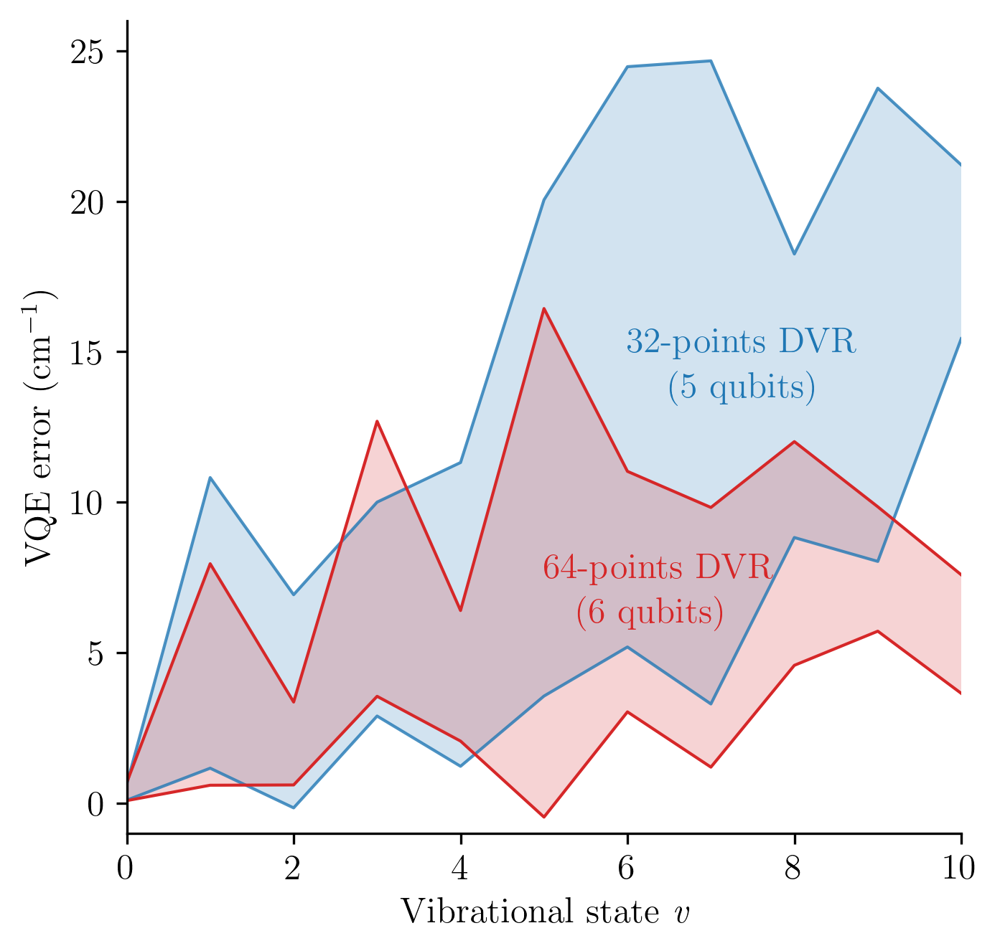

In [37]:
plt.rcParams["figure.figsize"] = (5,5)

ax = plt.subplot()
ax.plot(arhcl_opt_energies[:, 0] - arhcl_refs[:], '-', c=cmap(0), alpha=0.8, linewidth=1)
ax.plot(arhcl_opt_energies[:, 1] - arhcl_refs[:], '-', c=cmap(0), alpha=0.8, linewidth=1)
ax.fill_between(range(11), arhcl_opt_energies[:, 0] - arhcl_refs[:], arhcl_opt_energies[:, 1] - arhcl_refs[:], 
                alpha=0.2, facecolor=cmap(0), edgecolor=None)
ax.plot(arhcl_opt_energies_64[:, 0] - arhcl_refs[:], '-', c=cmap(3), linewidth=1)
ax.plot(arhcl_opt_energies_64[:, 1] - arhcl_refs[:], '-', c=cmap(3), linewidth=1)
ax.fill_between(range(11), arhcl_opt_energies_64[:, 0] - arhcl_refs[:], arhcl_opt_energies_64[:, 1] - arhcl_refs[:], 
                alpha=0.2, facecolor=cmap(3), edgecolor=None)
ax.text(6, 15, '32-points DVR', c=cmap(0))
ax.text(6.5, 13.5, '(5 qubits)', c=cmap(0))
ax.text(5, 7.5, '64-points DVR', c=cmap(3))
ax.text(5.4, 6, '(6 qubits)', c=cmap(3))
# ax.fill_between(range(-1, 12), -1, 1, alpha=0.2, color='black')
# plt.axhline(1, linestyle='dotted', c='black', alpha=0.2)
# plt.axhline(-1, linestyle='dotted', c='black', alpha=0.2)
# plt.ylim(-2, 10)
ax.set_ylabel('VQE error (cm${}^{-1}$)')
# ax.set_ylabel('$\Delta E_n^{\\rm VQE}$ (cm${}^{-1}$)')
ax.set_xlabel('Vibrational state $\\mathit{v}$')
ax.set_xlim((0, 10))
# ax.set_xlim((-0.5, 10.5))
ax.set_ylim((-1, 26))
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
plt.rcParams["figure.figsize"] = (6,4)

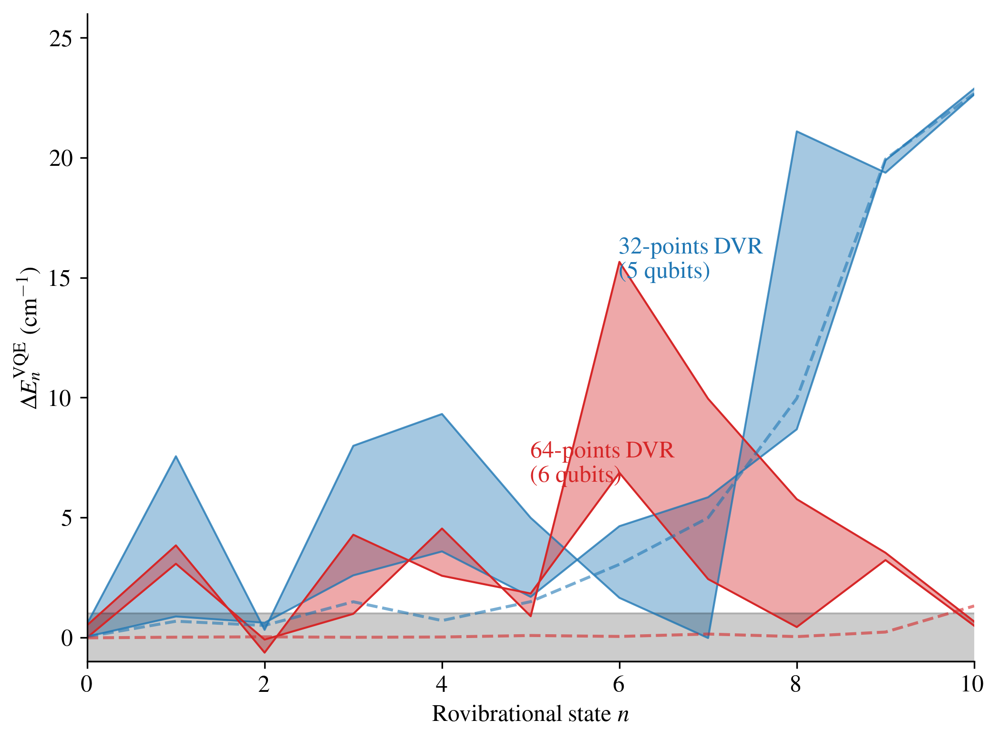

In [47]:
plt.rcParams["figure.figsize"] = (8,6)
ax = plt.subplot()
ax.plot(mgnh_opt_energies[:, 0] - mgnh_refs[:], '-', c=cmap(0), alpha=0.8, linewidth=1)
ax.plot(mgnh_opt_energies[:, 1] - mgnh_refs[:], '-', c=cmap(0), alpha=0.8, linewidth=1)
ax.fill_between(range(11), mgnh_opt_energies[:, 0] - mgnh_refs[:], mgnh_opt_energies[:, 1] - mgnh_refs[:], 
                alpha=0.4, facecolor=cmap(0), edgecolor=None)
ax.plot(mgnh_opt_energies_64[:, 0] - mgnh_refs[:], '-', c=cmap(3), linewidth=1)
ax.plot(mgnh_opt_energies_64[:, 1] - mgnh_refs[:], '-', c=cmap(3), linewidth=1)
ax.fill_between(range(11), mgnh_opt_energies_64[:, 0] - mgnh_refs[:], mgnh_opt_energies_64[:, 1] - mgnh_refs[:], 
                alpha=0.4, facecolor=cmap(3), edgecolor=None)
ax.text(6, 15, '32-points DVR\n   (5 qubits)', c=cmap(0))
ax.text(5, 6.5, '64-points DVR\n   (6 qubits)', c=cmap(3))
ax.fill_between(range(-1, 12), -1, 1, alpha=0.2, color='black')
# plt.axhline(1, linestyle='dotted', c='black', alpha=0.2)
# plt.axhline(-1, linestyle='dotted', c='black', alpha=0.2)
# plt.ylim(-2, 10)
ax.set_ylabel('$\Delta E_n^{\\rm VQE}$ (cm${}^{-1}$)')
ax.set_xlabel('Rovibrational state $n$')
# plt.text(2, 20, 'Minimal Circuit\n         (32)', c=cmap(0))
# plt.text(4.8, 7, 'Optimal Circuit\n         (32)', c=cmap(1))
# plt.text(6, 14, 'Minimal Circuit\n         (64)', c=cmap(2))
# plt.text(2.5, 4.5, 'Optimal Circuit\n         (64)', c=cmap(3), fontdict={'fontsize': 10})
# plt.text(8.5, 4.5, 'DVR error\n     (32)', c=cmap(4), fontdict={'fontsize': 10})
# plt.text(8, 2.5, 'DVR error (64)', c=cmap(5), fontdict={'fontsize': 10})
# plt.yscale('log')
ax.plot(np.arange(11), ref_diffs['mgnh_32'], '--', label='mgnh', alpha=0.6, c=cmap(0))
ax.plot(np.arange(11), ref_diffs['mgnh_64'], '--', label='mgnh', alpha=0.6, c=cmap(3))
# plt.plot(np.arange(11), ref_diffs['mgnh'], 's-', label='MgNH')
# plt.title('mgnh')
ax.set_xlim((0, 10))
# ax.set_xlim((-0.5, 10.5))
ax.set_ylim((-1, 26))
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
plt.rcParams["figure.figsize"] = (6,4)

In [48]:
print(mgnh_opt_energies - mgnh_refs[:, None])
print(mgnh_full_energies - mgnh_refs[:])

[[ 0.57667409  0.03596484]
 [ 7.55263788  0.87242665]
 [ 0.31609947  0.61102601]
 [ 7.98869467  2.58762869]
 [ 9.31488779  3.5855118 ]
 [ 4.98620427  1.69044047]
 [ 1.65119822  4.63760087]
 [-0.02493643  5.84397032]
 [21.09864217  8.67738522]
 [19.37541577 19.89402542]
 [22.63638316 22.87967801]]
[ 0.03720266  0.93890587  0.59496729  2.22946096  1.85565228  1.11877315
  4.76399516  5.42559075 10.5549044  19.53443219 22.48261964]


Text(0.2, 21, 'MgNH')

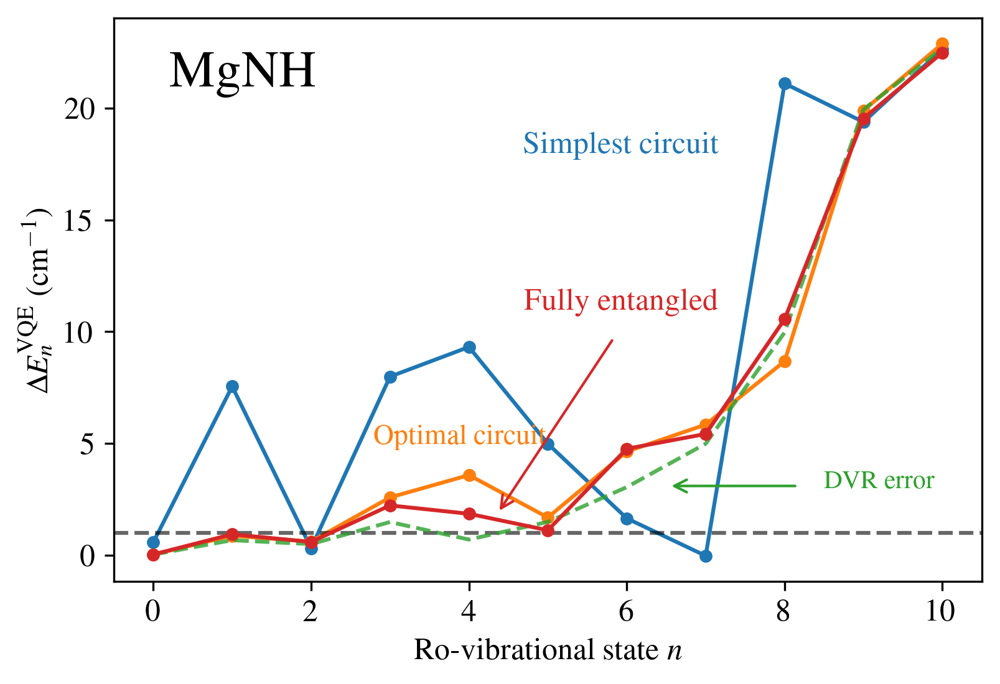

In [49]:
plt.plot(mgnh_opt_energies - mgnh_refs[:, None], 'o-', markersize=4, linewidth=1.5)
plt.axhline(1, linestyle='--', c='black', alpha=0.6)
# plt.ylim(-2, 10)
plt.ylabel('$\Delta E_n^{\\rm VQE}$ (cm${}^{-1}$)')
plt.xlabel('Ro-vibrational state $n$')
plt.text(4.7, 18, 'Simplest circuit', c=cmap(0))
plt.text(2.8, 5, 'Optimal circuit', c=cmap(1), fontdict={'fontsize': 11})
plt.annotate('', xy=(6.5, 3.1), xytext=(8.2, 3.1), arrowprops={'arrowstyle': '->', 'color': cmap(2)})
# plt.arrow(, -1.5, 0, color=cmap(2), length_includes_head=True, overhang=)
plt.text(8.5, 3, 'DVR error', c=cmap(2), fontdict={'fontsize': 10})
plt.text(4.7, 11, 'Fully entangled', c=cmap(3), fontdict={'fontsize': 12})
plt.annotate('', xy=(4.35, 1.8), xytext=(5.85, 9.8), arrowprops={'arrowstyle': '->', 'color': cmap(3)})
# plt.arrow(5.85, 9.8, -1.5, -7.7, color=cmap(3), head_width=0.1)
# plt.yscale('log')
plt.plot(np.arange(11), ref_diffs['mgnh_32'], '--', label='MgNH', alpha=0.8)
plt.plot(mgnh_full_energies - mgnh_refs[:], 'o-', markersize=4, linewidth=1.5)
# plt.plot(np.arange(11), ref_diffs['mgnh'], 's-', label='MgNH')
# plt.title('MgNH (32 points)')
plt.text(0.2, 21, 'MgNH', fontdict=dict(fontsize=20))

Text(0.5, 1.0, 'MgNH (64 points)')

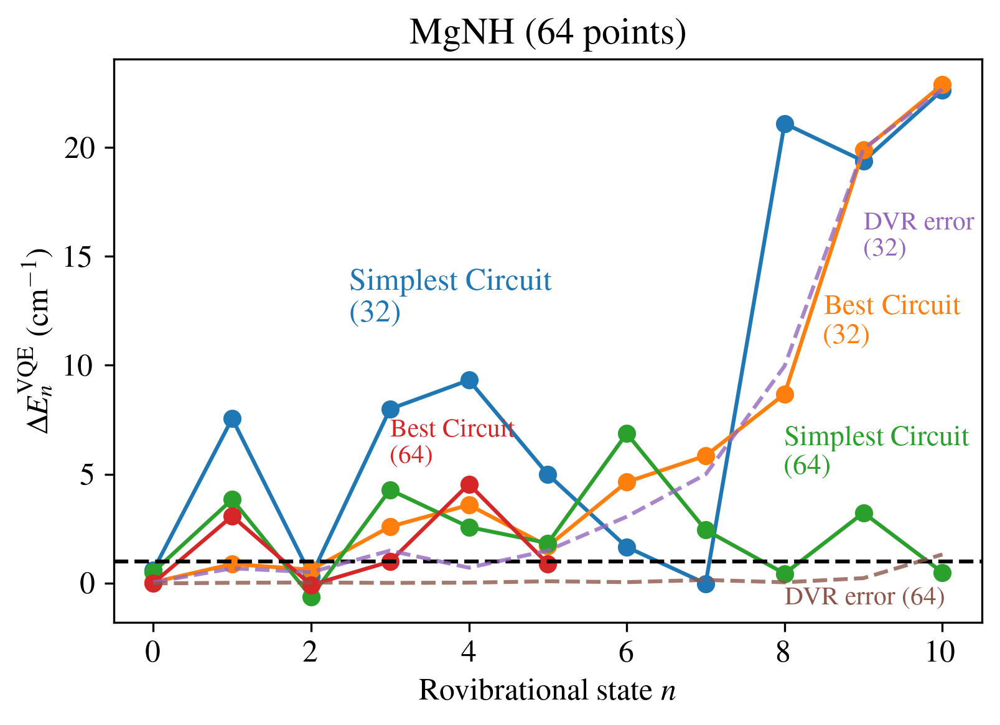

In [50]:
plt.plot(mgnh_opt_energies - mgnh_refs[:, None], 'o-')
plt.plot(mgnh_opt_energies_64[:, 0].flatten() - mgnh_refs[:], 'o-')
plt.plot(mgnh_opt_energies_64[:6, 1] - mgnh_refs[:6], 'o-')
plt.axhline(1, linestyle='--', c='black')
# plt.ylim(-2, 10)
plt.ylabel('$\Delta E_n^{\\rm VQE}$ (cm${}^{-1}$)')
plt.xlabel('Rovibrational state $n$')
plt.text(2.5, 12, 'Simplest Circuit\n          (32)', c=cmap(0))
plt.text(8.5, 11, 'Best Circuit\n      (32)', c=cmap(1), fontdict={'fontsize': 11})
plt.text(8, 5, 'Simplest Circuit\n          (64)', c=cmap(2), fontdict={'fontsize': 11})
plt.text(3, 5.5, 'Best Circuit\n      (64)', c=cmap(3), fontdict={'fontsize': 10})
plt.text(9, 15, 'DVR error\n     (32)', c=cmap(4), fontdict={'fontsize': 10})
plt.text(8, -1, 'DVR error (64)', c=cmap(5), fontdict={'fontsize': 10})
plt.plot(np.arange(11), ref_diffs['mgnh_32'], '--', label='MgNH', alpha=0.8)
plt.plot(np.arange(11), ref_diffs['mgnh_64'], '--', label='MgNH', alpha=0.8)
# plt.yscale('log')
plt.title('MgNH (64 points)')

In [51]:
spins = [1, 3, 5, 7, 9, 11, 13]
cr2_energies_dict = {}
for spin in spins:
    cr2_energies_dict[spin] = {}
    for ent in ['linear', 'full']:
        cr2_energies_dict[spin][ent] = [np.min(data['cr2_16'][spin][ent][rep][0]['energies']) - ref_full[f'cr2_{spin}'][0] for rep in range(1, 4)]
cr2_energies_dict


{1: {'linear': [51.96481866052636, 49.18122406654584, -0.04959524711739505],
  'full': [43.546775677925325, 10.16269417942567, -0.04959530169435311]},
 3: {'linear': [44.81042572081424, 0.5167488392035011, -0.0731727074162336],
  'full': [44.812361401780436, 1.2803732938809844, -0.07317261512071127]},
 5: {'linear': [3.1008101594252366,
   0.025623347414693853,
   0.025590397513042262],
  'full': [3.1008100874487354, 0.025630468447161547, 0.02555529719484184]},
 7: {'linear': [2.5342131958423124,
   -0.026108753335392976,
   -0.026115798075807106],
  'full': [2.534212585698697, -0.026112396942153282, -0.02611690052526683]},
 9: {'linear': [2.5285623633453724,
   -0.02848862308292155,
   -0.028496536124293925],
  'full': [2.528560767314957, -0.0284921422626212, -0.028499384624410595]},
 11: {'linear': [2.9019942768645706,
   -0.000965342001109093,
   -0.0010362619677835028],
  'full': [2.9019949932676354, -0.0009700867053652473, -0.001015259453197359]},
 13: {'linear': [3.25412213815786

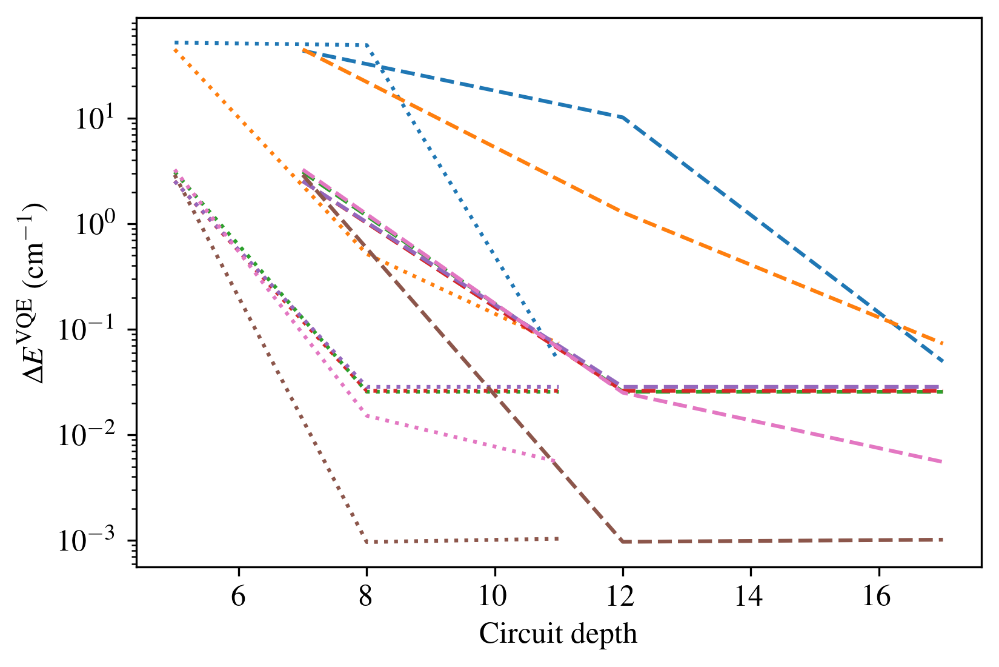

In [52]:
linear_depth = [5, 8, 11]
full_depth = [7, 12, 17]
cmap = plt.get_cmap('tab10')
for i, spin in enumerate(spins):
    plt.plot(linear_depth, np.abs(cr2_energies_dict[spin]['linear']), ls='dotted', label='Linear entanglement', c=cmap(i))
    plt.plot(full_depth, np.abs(cr2_energies_dict[spin]['full']), '--', label='Full entanglement', c=cmap(i))

# plt.axhline(cr2_refs_16[0] - cr2[0], linestyle='--', label="32 point DVR error", color='black')
# plt.text(10, 0.072, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14})
# plt.text(28, 0.21, '     5 qubits\n\n(32 DVR points)', color='black')
# plt.ylim((0.06, 0.25))
# plt.xlim((8, 36))
plt.xlabel('Circuit depth')
# plt.ylabel('Absolute error from the converged DVR energy (cm$^{-1}$)')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('$E_0^{\\rm VQE} - E_0$ (cm$^{-1}$)')
# plt.legend()
plt.yscale('log')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

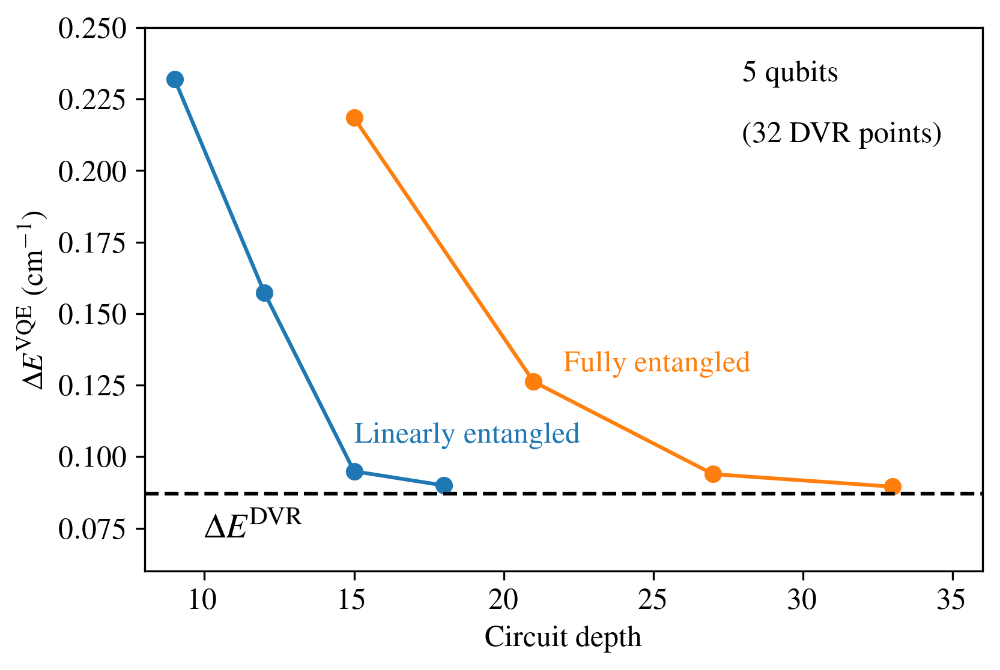

In [53]:
linear_depth = [6, 9, 12, 15, 18]
full_depth = [9, 15, 21, 27, 33]
cmap = plt.get_cmap('tab10')
plt.plot(linear_depth[1:], arhcl_linear_energies0[1:] - arhcl_refs[0], 'o-', label='Pairwise entanglement')
plt.text(15, 0.105, 'Linearly entangled', color=cmap(0))
# plt.text(10, 0.23, '5q-linear-2', fontdict={'size':12}, color=cmap(0))
# plt.text(13, 0.155, '5q-linear-3', fontdict={'size':12}, color=cmap(0))
# plt.text(9.8, 0.093, '5q-linear-4', fontdict={'size':12}, color=cmap(0))
# plt.text(17, 0.098, '5q-linear-5', fontdict={'size':12}, color=cmap(0))
plt.plot(full_depth[1:], arhcl_full_energies0[1:] - arhcl_refs[0], 'o-', label='All-to-all entanglement')
plt.text(22, 0.13, 'Fully entangled', color=cmap(1))
# plt.text(16, 0.218, '5q-full-2', fontdict={'size':12}, color=cmap(1))
# plt.text(21.5, 0.13, '5q-full-3', fontdict={'size':12}, color=cmap(1))
# plt.text(27, 0.103, '5q-full-4', fontdict={'size':12}, color=cmap(1))
# plt.text(32, 0.098, '5q-full-5', fontdict={'size':12}, color=cmap(1))
plt.axhline(arhcl_refs_32[0] - arhcl_refs[0], linestyle='--', label="32 point DVR error", color='black')
plt.text(10, 0.072, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14})
plt.text(28, 0.21, '     5 qubits\n\n(32 DVR points)', color='black')
plt.ylim((0.06, 0.25))
plt.xlim((8, 36))
plt.xlabel('Circuit depth')
# plt.ylabel('Absolute error from the converged DVR energy (cm$^{-1}$)')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('$E_0^{\\rm VQE} - E_0$ (cm$^{-1}$)')
# plt.legend()
# plt.yscale('log')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

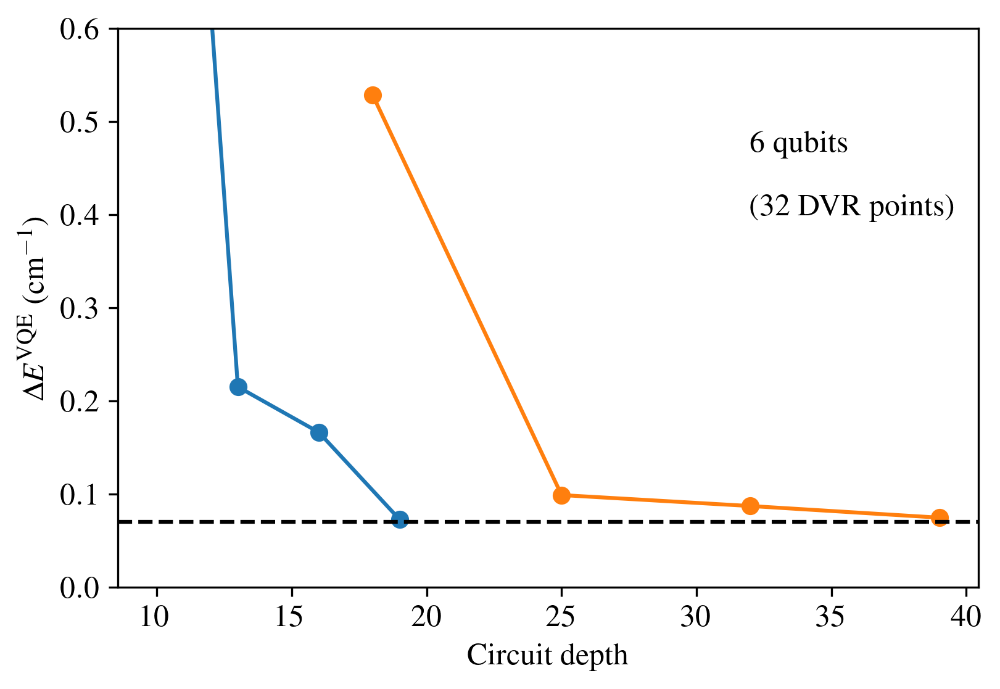

In [54]:
linear_depth = [7, 10, 13, 16, 19]
full_depth = [11, 18, 25, 32, 39]
cmap = plt.get_cmap('tab10')
plt.plot(linear_depth[1:], arhcl_linear_energies0_64[1:] - arhcl_refs[0], 'o-', label='Pairwise entanglement')
# plt.text(15, 0.105, 'Linearly entangled', color=cmap(0))
# plt.text(10, 0.23, '5q-linear-2', fontdict={'size':12}, color=cmap(0))
# plt.text(13, 0.155, '5q-linear-3', fontdict={'size':12}, color=cmap(0))
# plt.text(9.8, 0.093, '5q-linear-4', fontdict={'size':12}, color=cmap(0))
# plt.text(17, 0.098, '5q-linear-5', fontdict={'size':12}, color=cmap(0))
plt.plot(full_depth[1:], arhcl_full_energies0_64[1:] - arhcl_refs[0], 'o-', label='All-to-all entanglement')
# plt.text(22, 0.13, 'Fully entangled', color=cmap(1))
# plt.text(16, 0.218, '5q-full-2', fontdict={'size':12}, color=cmap(1))
# plt.text(21.5, 0.13, '5q-full-3', fontdict={'size':12}, color=cmap(1))
# plt.text(27, 0.103, '5q-full-4', fontdict={'size':12}, color=cmap(1))
# plt.text(32, 0.098, '5q-full-5', fontdict={'size':12}, color=cmap(1))
plt.axhline(arhcl_refs_64[0] - arhcl_refs[0], linestyle='--', label="64 point DVR error", color='black')
# plt.text(10, 0.072, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14})
plt.text(32, 0.4, '     6 qubits\n\n(32 DVR points)', color='black')
plt.ylim((0, 0.6))
# plt.xlim((8, 36))
plt.xlabel('Circuit depth')
# plt.ylabel('Absolute error from the converged DVR energy (cm$^{-1}$)')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('$E_0^{\\rm VQE} - E_0$ (cm$^{-1}$)')
# plt.legend()
# plt.yscale('log')

[-86.77716476 -86.88880947 -88.00554137 -88.18950046 -88.19474923]


Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

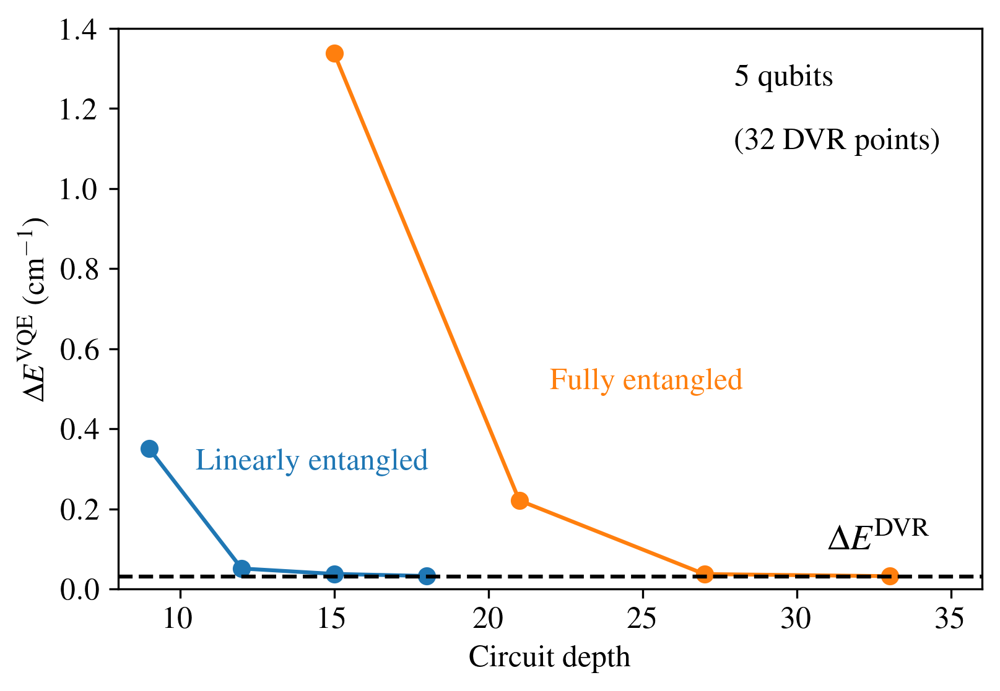

In [55]:
linear_depth = [6, 9, 12, 15, 18]
full_depth = [9, 15, 21, 27, 33]
plt.plot(linear_depth[1:], mgnh_linear_energies0[1:] - mgnh_refs[0], 'o-', label='Linear entanglement')
plt.text(10.5, 0.3, 'Linearly entangled', color=cmap(0))
# plt.text(10, 0.37, '5q-linear-2', fontdict={'size':12}, color=cmap(0))
# plt.text(11, 0.18, '5q-linear-3', fontdict={'size':12}, color=cmap(0))
# plt.text(13, 0.09, '5q-linear-4', fontdict={'size':12}, color=cmap(0))
# plt.text(18, 0.08, '5q-linear-5', fontdict={'size':12}, color=cmap(0))
print(mgnh_full_energies0)
plt.plot(full_depth[1:], mgnh_full_energies0[1:] - mgnh_refs[0], 'o-', label='Full entanglement')
plt.text(22, 0.5, 'Fully entangled', color=cmap(1))
# plt.text(16.5, 1.28, '5q-full-2', fontdict={'size':12}, color=cmap(1))
# plt.text(22, 0.25, '5q-full-3', fontdict={'size':12}, color=cmap(1))
# plt.text(27, 0.12, '5q-full-4', fontdict={'size':12}, color=cmap(1))
# plt.text(32, 0.1, '5q-full-5', fontdict={'size':12}, color=cmap(1))
plt.axhline(mgnh_refs_32[0] - mgnh_refs[0], linestyle='--', label="$|E'_0 - E_0|$", color='black')
plt.text(31, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14})
plt.text(28, 1.1, '     5 qubits\n\n(32 DVR points)', color='black')
plt.ylim((0, 1.4))
plt.xlim((8, 36))
plt.xlabel('Circuit depth')
# plt.ylabel('Absolute error from the converged DVR energy (cm$^{-1}$)')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('$E_0^{\\rm VQE} - E_0$ (cm$^{-1}$)')
# plt.legend()
# plt.yscale('log')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

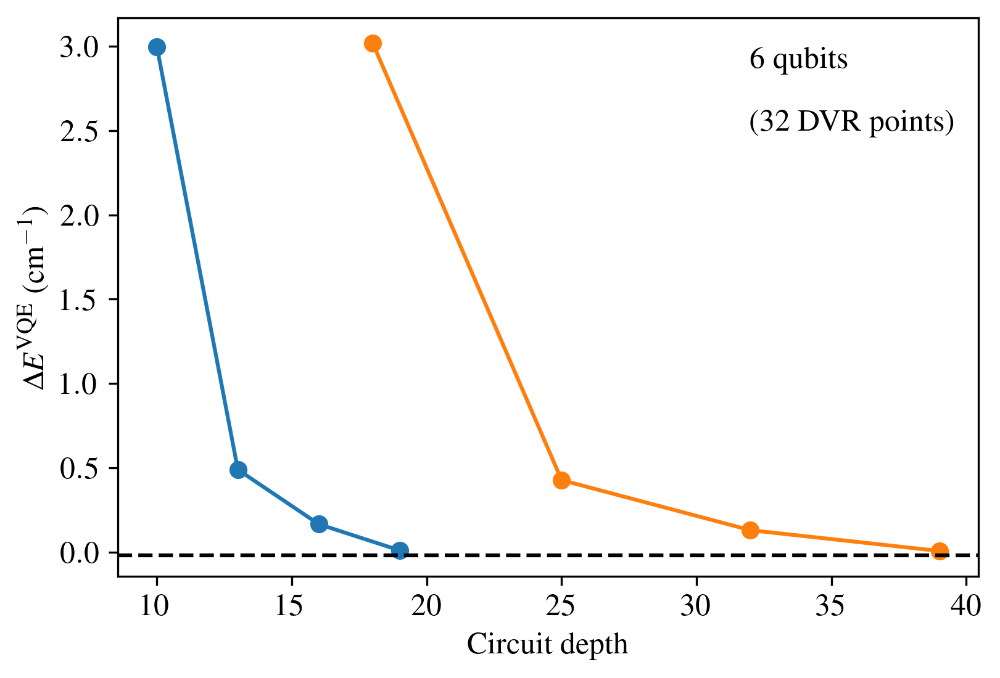

In [56]:
linear_depth = [7, 10, 13, 16, 19]
full_depth = [11, 18, 25, 32, 39]
cmap = plt.get_cmap('tab10')
plt.plot(linear_depth[1:], mgnh_linear_energies0_64[1:] - mgnh_refs[0], 'o-', label='Pairwise entanglement')
# plt.text(15, 0.105, 'Linearly entangled', color=cmap(0))
# plt.text(10, 0.23, '5q-linear-2', fontdict={'size':12}, color=cmap(0))
# plt.text(13, 0.155, '5q-linear-3', fontdict={'size':12}, color=cmap(0))
# plt.text(9.8, 0.093, '5q-linear-4', fontdict={'size':12}, color=cmap(0))
# plt.text(17, 0.098, '5q-linear-5', fontdict={'size':12}, color=cmap(0))
plt.plot(full_depth[1:], mgnh_full_energies0_64[1:] - mgnh_refs[0], 'o-', label='All-to-all entanglement')
# plt.text(22, 0.13, 'Fully entangled', color=cmap(1))
# plt.text(16, 0.218, '5q-full-2', fontdict={'size':12}, color=cmap(1))
# plt.text(21.5, 0.13, '5q-full-3', fontdict={'size':12}, color=cmap(1))
# plt.text(27, 0.103, '5q-full-4', fontdict={'size':12}, color=cmap(1))
# plt.text(32, 0.098, '5q-full-5', fontdict={'size':12}, color=cmap(1))
plt.axhline(mgnh_refs_64[0] - mgnh_refs[0], linestyle='--', label="64 point DVR error", color='black')
# plt.text(10, 0.072, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14})
plt.text(32, 2.5, '     6 qubits\n\n(32 DVR points)', color='black')
# plt.ylim((0.06, 0.25))
# plt.xlim((8, 36))
plt.xlabel('Circuit depth')
# plt.ylabel('Absolute error from the converged DVR energy (cm$^{-1}$)')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('$E_0^{\\rm VQE} - E_0$ (cm$^{-1}$)')
# plt.legend()
# plt.yscale('log')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

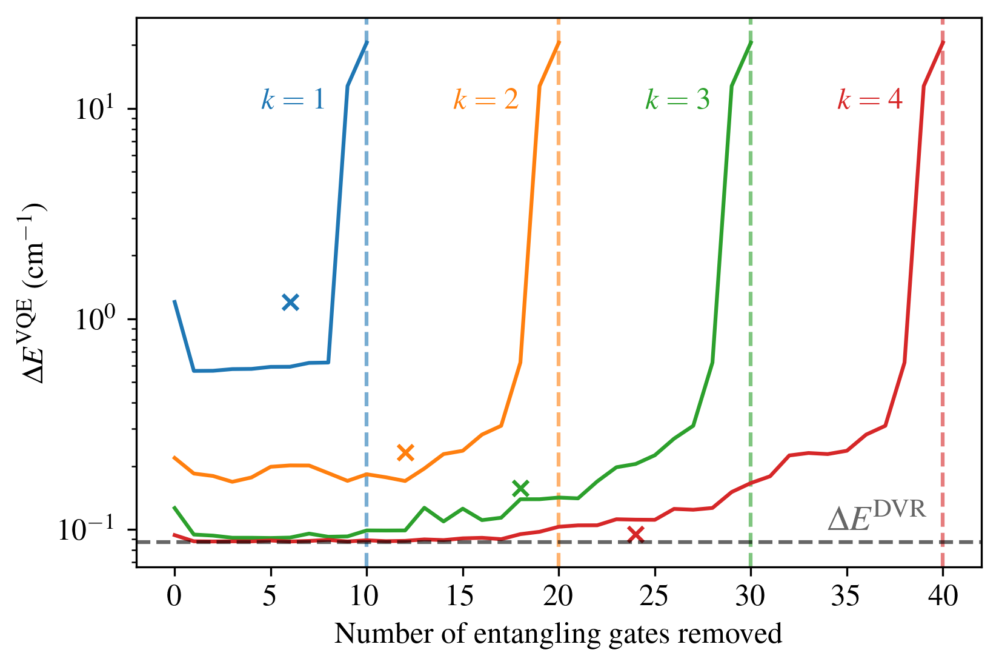

In [57]:
arhcl_greedyent_energies = []
arhcl_greedyent_circs = []
reps = [1, 2, 3, 4]
# reps = [2, 3, 4, 5]
for j, rep in enumerate(reps):
    arhcl_greedyent_circs.append(greedyent_data['arhcl'][rep][rep * 10]['removed_gates'])
    arhcl_greedyent_energies.append([])
    for i in range(0, 10 * rep + 1):
        d = greedyent_data['arhcl'][rep][i]
        arhcl_greedyent_energies[j].append(d['energies'])

    plt.plot(range(0, 10 * rep + 1), arhcl_greedyent_energies[j] - ref_full['arhcl'][0], label=f'{rep} ansatz reps.')
    plt.text(rep * 10  - 5.5, 10, f'$k = {rep}$', c=cmap(j))
    plt.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # plt.plot(np.linspace(0, 10, 10 * rep, endpoint=True), arhcl_greedyent_energies[j] - ref_full['arhcl'][0])
    
    lin_energies = data['arhcl']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    # plt.axhline(lin_energies[ind] - ref_full['arhcl'][0], ls='--', c=cmap(j), alpha=0.6)
    plt.scatter(6 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='x', color=cmap(j), alpha=1)
    
plt.axhline(ref_constrained['arhcl_32'][0] - ref_full['arhcl'][0], ls='--', c='black', alpha=0.6)
plt.text(34, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14}, alpha=0.6)
plt.yscale('log')
plt.xlabel('Number of entangling gates removed')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('VQE error in gs energy (cm$^{-1}$)')
# plt.legend()
# plt.title('ArHCl circuit destruction (starting fully entangled)')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

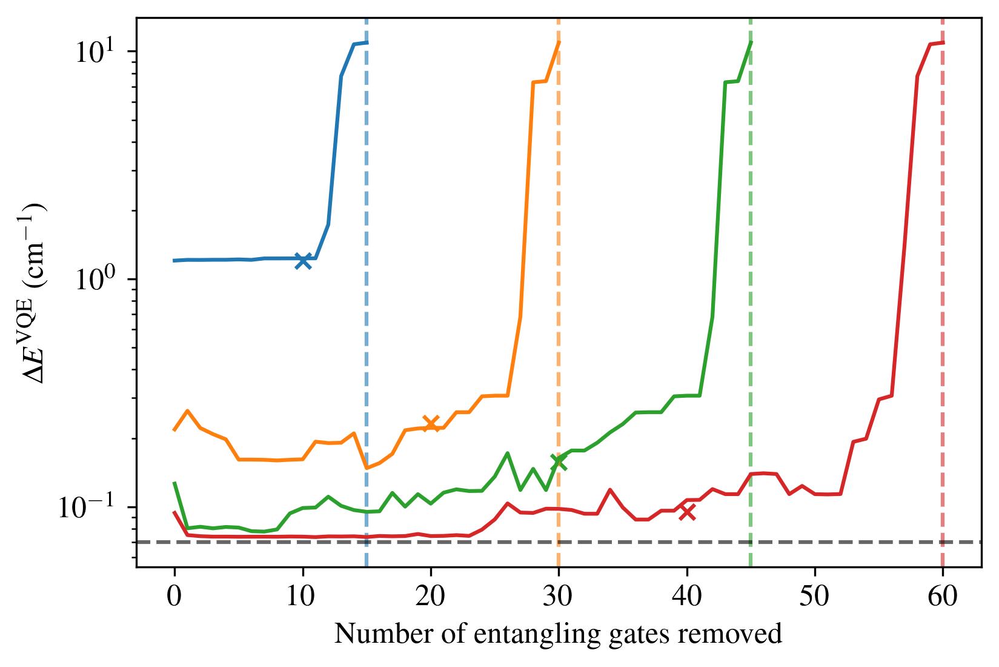

In [58]:
arhcl_greedyent_energies_64 = []
arhcl_greedyent_circs_64 = []
reps = [1, 2, 3, 4]
# reps = [2, 3, 4, 5]
for j, rep in enumerate(reps):
    arhcl_greedyent_circs_64.append(greedyent_data_64['arhcl'][rep][rep * 15]['removed_gates'])
    arhcl_greedyent_energies_64.append([])
    for i in range(0, 15 * rep + 1):
        d = greedyent_data_64['arhcl'][rep][i]
        arhcl_greedyent_energies_64[j].append(d['energies'])

    plt.plot(range(0, 15 * rep + 1), arhcl_greedyent_energies_64[j] - ref_full['arhcl'][0], label=f'{rep} ansatz reps.')
    # plt.text(rep * 15  - 5.5, 15, f'$k = {rep}$', c=cmap(j))
    plt.axvline(rep * 15, ls='--', c=cmap(j), alpha=0.6)
    # plt.plot(np.linspace(0, 15, 15 * rep, endpoint=True), arhcl_greedyent_energies_64[j] - ref_full['arhcl'][0])
    
    lin_energies = data['arhcl']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    # plt.axhline(lin_energies[ind] - ref_full['arhcl'][0], ls='--', c=cmap(j), alpha=0.6)
    plt.scatter(10 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='x', color=cmap(j), alpha=1)
    
plt.axhline(ref_constrained['arhcl_64'][0] - ref_full['arhcl'][0], ls='--', c='black', alpha=0.6)
# plt.text(34, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14}, alpha=0.6)
plt.yscale('log')
plt.xlabel('Number of entangling gates removed')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('VQE error in gs energy (cm$^{-1}$)')
# plt.legend()
# plt.title('ArHCl circuit destruction (starting fully entangled)')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

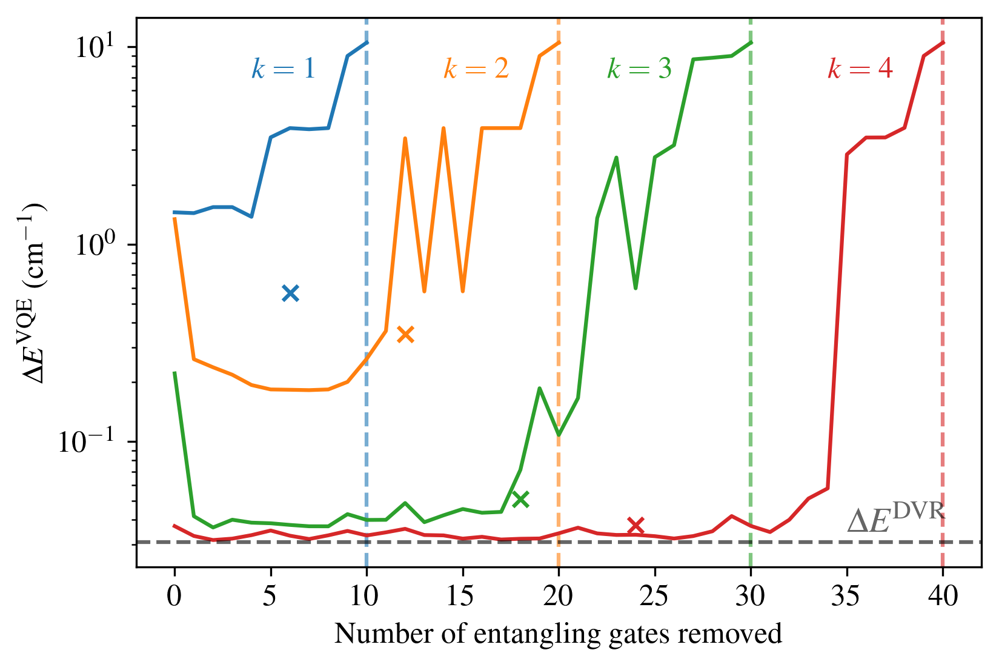

In [59]:
mgnh_greedyent_energies = []
mgnh_greedyent_circs = []
reps = [1, 2, 3, 4]
# reps = [2, 3, 4, 5]
for j, rep in enumerate(reps):
    mgnh_greedyent_circs.append(greedyent_data['mgnh'][rep][rep * 10]['removed_gates'])
    mgnh_greedyent_energies.append([])
    for i in range(0, 10 * rep + 1):
        d = greedyent_data['mgnh'][rep][i]
        mgnh_greedyent_energies[j].append(d['energies'])

    plt.plot(range(0, 10 * rep + 1), mgnh_greedyent_energies[j] - ref_full['mgnh'][0], label=f'{rep} ansatz reps.')
    plt.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # plt.plot(np.linspace(0, 10, 10 * rep, endpoint=True), mgnh_greedyent_energies[j] - ref_full['mgnh'][0])
    
    lin_energies = data['mgnh']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    # plt.axhline(lin_energies[ind] - ref_full['mgnh'][0], ls='--', c=cmap(j), alpha=0.6)
    plt.scatter(6 * rep, lin_energies[ind] - ref_full['mgnh'][0], marker='x', color=cmap(j), alpha=1)
    
plt.text(1 * 10  - 6, 7, f'$k = {1}$', c=cmap(0))
plt.text(2 * 10  - 6, 7, f'$k = {2}$', c=cmap(1))
plt.text(3 * 10  - 7.5, 7, f'$k = {3}$', c=cmap(2))
plt.text(4 * 10  - 6, 7, f'$k = {4}$', c=cmap(3))
plt.axhline(ref_constrained['mgnh_32'][0] - ref_full['mgnh'][0], ls='--', c='black', alpha=0.6)
plt.text(35, 0.035, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14}, alpha=0.6)
plt.yscale('log')
plt.xlabel('Number of entangling gates removed')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('VQE error in gs energy (cm$^{-1}$)')
# plt.legend()
# plt.title('MgNH circuit destruction (starting fully entangled)')

Text(0, 0.5, '$\\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)')

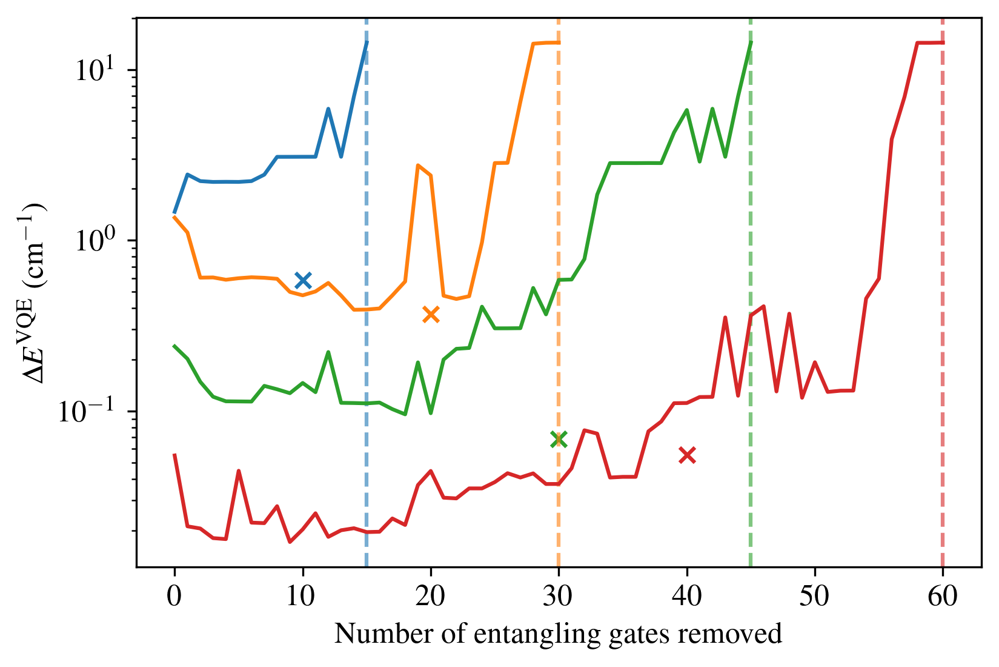

In [60]:
mgnh_greedyent_energies_64 = []
mgnh_greedyent_circs_64 = []
reps = [1, 2, 3, 4]
# reps = [2, 3, 4, 5]
for j, rep in enumerate(reps):
    mgnh_greedyent_circs_64.append(greedyent_data_64['mgnh'][rep][rep * 15]['removed_gates'])
    mgnh_greedyent_energies_64.append([])
    for i in range(0, 15 * rep + 1):
        d = greedyent_data_64['mgnh'][rep][i]
        mgnh_greedyent_energies_64[j].append(d['energies'])

    plt.plot(range(0, 15 * rep + 1), mgnh_greedyent_energies_64[j] - ref_constrained['mgnh_64'][0], label=f'{rep} ansatz reps.')
    plt.axvline(rep * 15, ls='--', c=cmap(j), alpha=0.6)
    # plt.plot(np.linspace(0, 15, 15 * rep, endpoint=True), mgnh_greedyent_energies_64[j] - ref_full['mgnh'][0])
    
    lin_energies = data['mgnh']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    # plt.axhline(lin_energies[ind] - ref_full['mgnh'][0], ls='--', c=cmap(j), alpha=0.6)
    plt.scatter(10 * rep, lin_energies[ind] - ref_constrained['mgnh_64'][0], marker='x', color=cmap(j), alpha=1)
    
# plt.text(1 * 15  - 6, 7, f'$k = {1}$', c=cmap(0))
# plt.text(2 * 15  - 6, 7, f'$k = {2}$', c=cmap(1))
# plt.text(3 * 15  - 7.5, 7, f'$k = {3}$', c=cmap(2))
# plt.text(4 * 15  - 6, 7, f'$k = {4}$', c=cmap(3))
# plt.axhline(ref_constrained['mgnh_64'][0] - ref_full['mgnh'][0], ls='--', c='black', alpha=0.6)
# plt.text(35, 0.035, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 14}, alpha=0.6)
plt.yscale('log')
# plt.ylim(-0.2, 8)
plt.xlabel('Number of entangling gates removed')
plt.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# plt.ylabel('VQE error in gs energy (cm$^{-1}$)')
# plt.legend()
# plt.title('MgNH circuit destruction (starting fully entangled)')

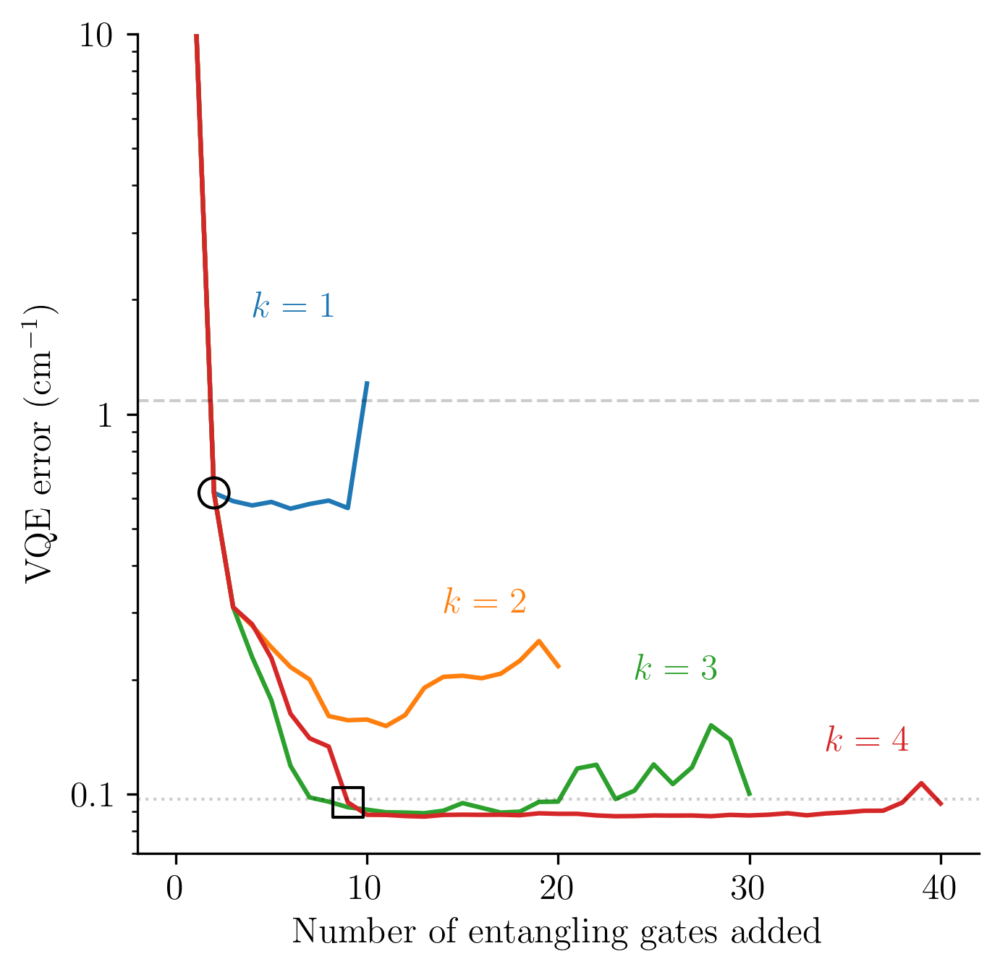

In [53]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

arhcl_greedyent_const_energies = []
arhcl_greedyent_const_circs = []
arhcl_linear_energies = []
reps = [1, 2, 3, 4]
for j, rep in enumerate(reps):
    arhcl_greedyent_const_circs.append(greedyent_const_data['arhcl'][rep][rep * 10]['removed_gates'])
    arhcl_greedyent_const_energies.append([])
    for i in range(0, 10 * rep + 1):
        d = greedyent_const_data['arhcl'][rep][i]
        arhcl_greedyent_const_energies[j].append(d['energies'])

    ax.plot(range(0, 10 * rep + 1), arhcl_greedyent_const_energies[j] - ref_full['arhcl'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), arhcl_greedyent_const_energies[j] - ref_full['arhcl'][0])

    lin_energies = data['arhcl']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    arhcl_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['arhcl'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(4 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='v', color=cmap(j), alpha=1, s=100)

reps = [1, 2, 3, 4]
# partitions = ['0-1234', '01-234', '012-34', '0123-4']
partitions = ['012-34', '0123-4']
ls = ['dotted', 'dashdot']
# partitions = ['012-34']
# partitions = ['0123-4']
for k, p in enumerate(partitions):
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data['arhcl'][p][rep][i]['energies'])
        partition_energies = np.array(partition_energies)
        # ax.plot(range(1, layer_counts + 1), partition_energies - ref_full['arhcl'][0], label=f'{rep} {p}', c=cmap(j), ls=ls[k])
    
# ax.plot(4 * np.arange(1, 5), arhcl_linear_energies - ref_full['arhcl'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(2, arhcl_greedyent_const_energies[0][2] - ref_full['arhcl'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(2, arhcl_greedyent_const_energies[0][2] - ref_full['arhcl'][0], zorder=20, 
#             facecolors=cmap(0), edgecolors='none', s=100, alpha=0.4)
ax.scatter(9, arhcl_greedyent_const_energies[3][9] - ref_full['arhcl'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(9, arhcl_greedyent_const_energies[3][9] - ref_full['arhcl'][0], marker='s', zorder=20, 
#             facecolors=cmap(3), edgecolors='none', s=100, alpha=0.4)

ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(ref_constrained['arhcl_32'][0] - ref_full['arhcl'][0] + 0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(ref_constrained['arhcl_32'][0] - ref_full['arhcl'][0] + 1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(7e-2, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'ArHCl', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('ArHCl (32 points)')

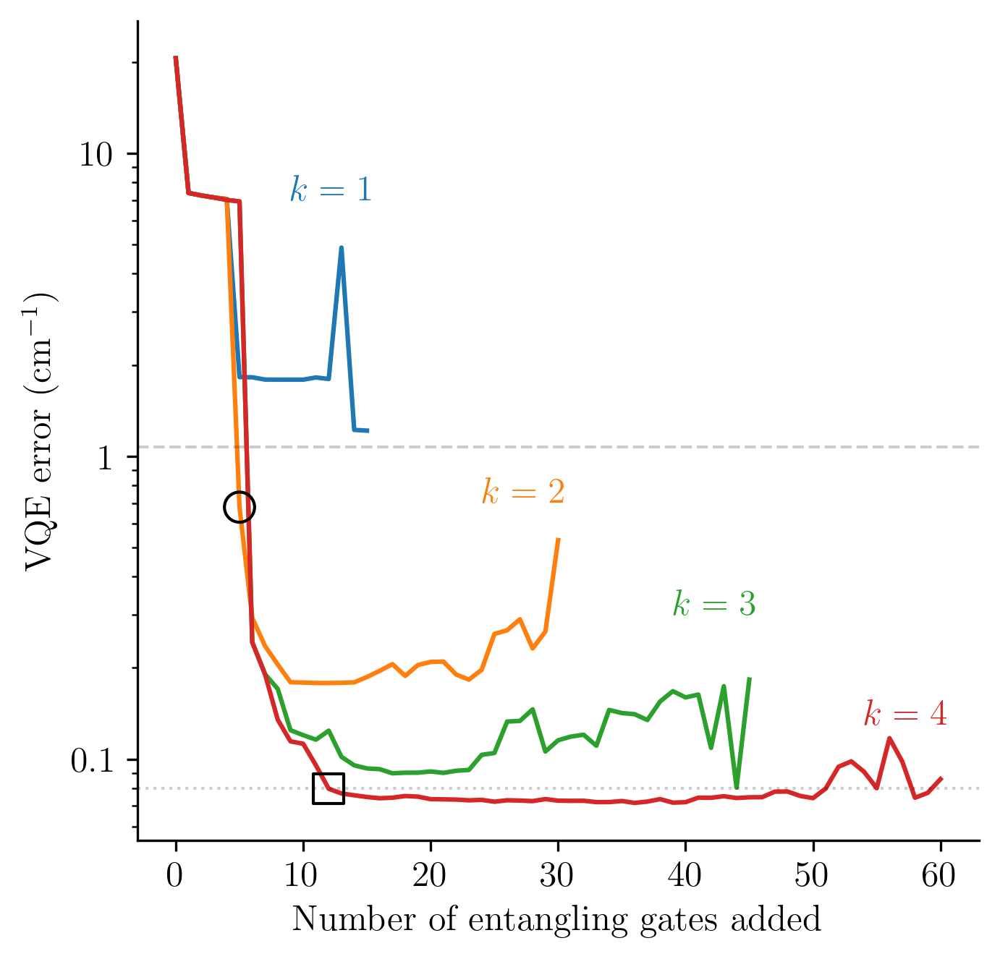

In [54]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

arhcl_greedyent_const_energies_64 = []
arhcl_greedyent_const_circs_64 = []
arhcl_linear_energies_64 = []
reps = [1, 2, 3, 4]
for j, rep in enumerate(reps):
    arhcl_greedyent_const_circs_64.append(greedyent_const_data_64['arhcl'][rep][rep * 15]['removed_gates'])
    arhcl_greedyent_const_energies_64.append([])
    for i in range(0, 15 * rep + 1):
        d = greedyent_const_data_64['arhcl'][rep][i]
        arhcl_greedyent_const_energies_64[j].append(d['energies'])

    ax.plot(range(0, 15 * rep + 1), arhcl_greedyent_const_energies_64[j] - ref_full['arhcl'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), arhcl_greedyent_const_energies_64[j] - ref_full['arhcl'][0])

    lin_energies = data_64['arhcl']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    arhcl_linear_energies_64.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['arhcl'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(4 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='v', color=cmap(j), alpha=1)

reps = [1, 2, 3, 4]
# partitions = ['0-1234', '01-234', '012-34', '0123-4']
partitions = ['0123-45', '01234-5']
ls = ['dotted', 'dashdot']
# partitions = ['012-34']
# partitions = ['0123-4']
for k, p in enumerate(partitions):
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data_64['arhcl'][p][rep][i]['energies'])
        partition_energies = np.array(partition_energies)
        # ax.plot(range(1, layer_counts + 1), partition_energies - ref_full['arhcl'][0], label=f'{rep} {p}', c=cmap(j), ls=ls[k])
    
# ax.plot(4 * np.arange(1, 5), arhcl_linear_energies_64 - ref_full['arhcl'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(5, arhcl_greedyent_const_energies_64[1][5] - ref_full['arhcl'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(12, arhcl_greedyent_const_energies_64[3][12] - ref_full['arhcl'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)

ax.text(1 * 15  - 6, 7, f'$k = {1}$', c=cmap(0))
ax.text(2 * 15  - 6, 0.7, f'$k = {2}$', c=cmap(1))
ax.text(3 * 15  - 6, 0.3, f'$k = {3}$', c=cmap(2))
ax.text(4 * 15  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(ref_constrained['arhcl_64'][0] - ref_full['arhcl'][0] + 0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(ref_constrained['arhcl_64'][0] - ref_full['arhcl'][0] + 1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.set_ylim(7e-2, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'ArHCl', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('ArHCl (64 points)')

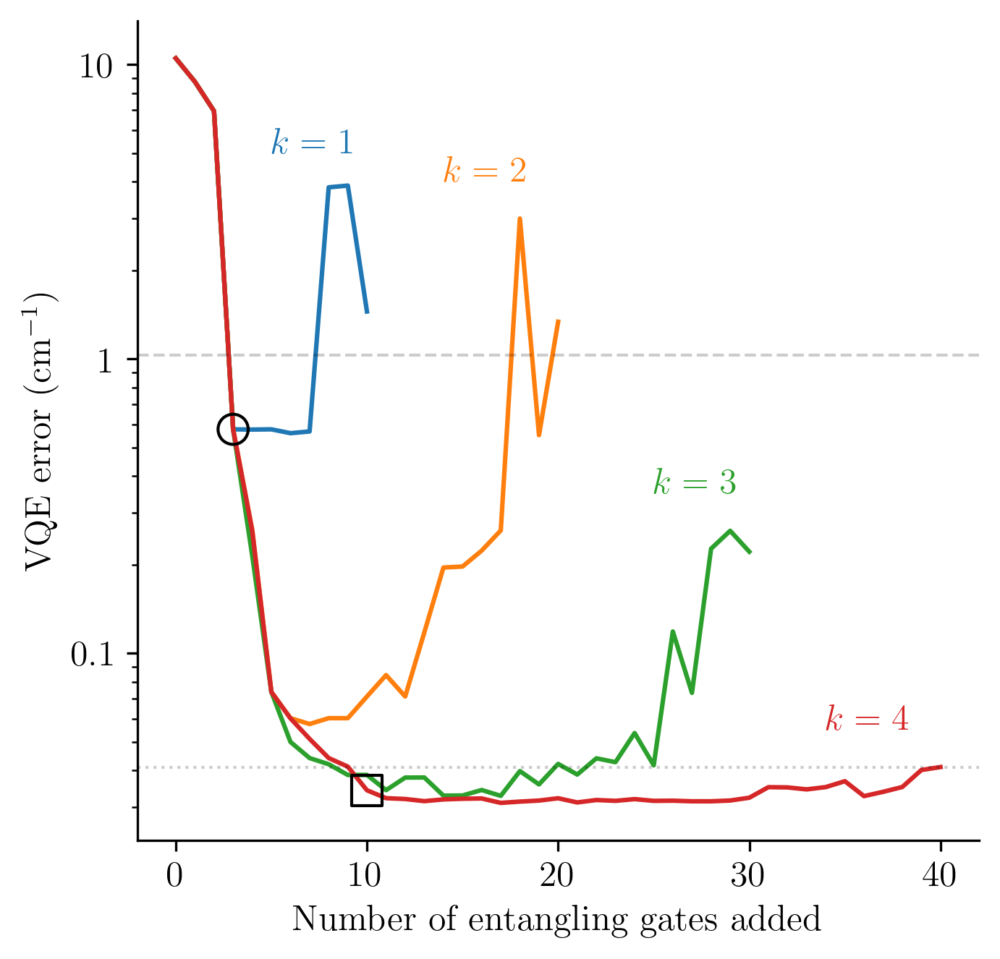

In [55]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

mgnh_greedyent_const_energies = []
mgnh_greedyent_const_circs = []
mgnh_linear_energies = []
reps = [1, 2, 3, 4]
for j, rep in enumerate(reps):
    mgnh_greedyent_const_circs.append(greedyent_const_data['mgnh'][rep][rep * 10]['removed_gates'])
    mgnh_greedyent_const_energies.append([])
    for i in range(0, 10 * rep + 1):
        d = greedyent_const_data['mgnh'][rep][i]
        mgnh_greedyent_const_energies[j].append(d['energies'])

    ax.plot(range(0, 10 * rep + 1), mgnh_greedyent_const_energies[j] - ref_full['mgnh'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), mgnh_greedyent_const_energies[j] - ref_full['mgnh'][0])

    lin_energies = data['mgnh']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    mgnh_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['mgnh'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(4 * rep, lin_energies[ind] - ref_full['mgnh'][0], marker='v', color=cmap(j), alpha=1, s=100)
    
# ax.plot(4 * np.arange(1, 5), mgnh_linear_energies - ref_full['mgnh'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(3, mgnh_greedyent_const_energies[0][3] - ref_full['mgnh'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(3, mgnh_greedyent_const_energies[0][3] - ref_full['mgnh'][0], zorder=20, 
#             facecolors=cmap(0), edgecolors='none', s=100, alpha=0.4)
ax.scatter(10, mgnh_greedyent_const_energies[3][10] - ref_full['mgnh'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(10, mgnh_greedyent_const_energies[3][10] - ref_full['mgnh'][0], marker='s', zorder=20, 
#             facecolors=cmap(3), edgecolors='none', s=100, alpha=0.4)

ax.text(1 * 10  - 5, 5, f'$k = {1}$', c=cmap(0))
ax.text(2 * 10  - 6, 4, f'$k = {2}$', c=cmap(1))
ax.text(3 * 10  - 5, 0.35, f'$k = {3}$', c=cmap(2))
ax.text(4 * 10  - 6, 0.055, f'$k = {4}$', c=cmap(3))
ax.axhline(ref_constrained['mgnh_32'][0] - ref_full['mgnh'][0] + 0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(ref_constrained['mgnh_32'][0] - ref_full['mgnh'][0] + 1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.set_ylim(7e-2, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'mgnh', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('mgnh (32 points)')

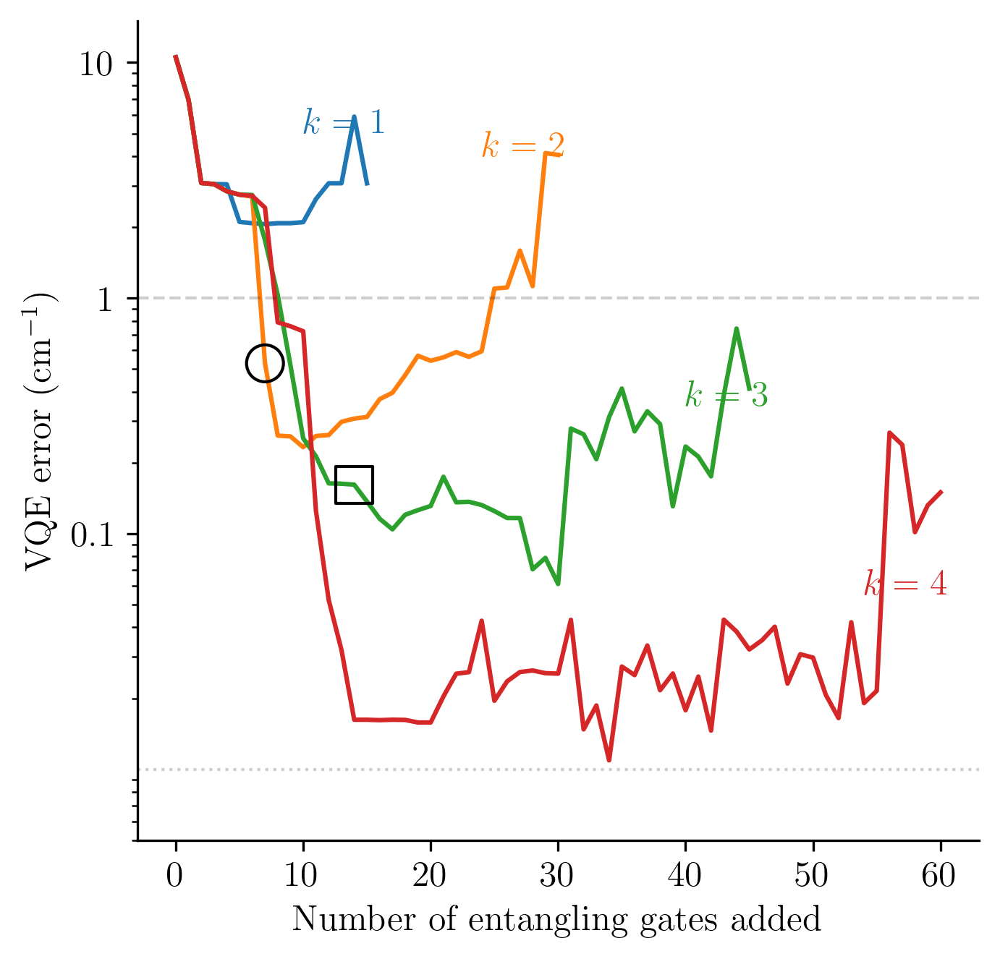

In [56]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

mgnh_greedyent_const_energies_64 = []
mgnh_greedyent_const_circs_64 = []
mgnh_linear_energies_64 = []
reps = [1, 2, 3, 4]
for j, rep in enumerate(reps):
    mgnh_greedyent_const_circs_64.append(greedyent_const_data_64['mgnh'][rep][rep * 15]['removed_gates'])
    mgnh_greedyent_const_energies_64.append([])
    for i in range(0, 15 * rep + 1):
        d = greedyent_const_data_64['mgnh'][rep][i]
        mgnh_greedyent_const_energies_64[j].append(d['energies'])

    ax.plot(range(0, 15 * rep + 1), mgnh_greedyent_const_energies_64[j] - ref_constrained['mgnh_64'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 15, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 15, 15 * rep, endpoint=True), mgnh_greedyent_const_energies_64[j] - ref_constrained['mgnh_64'][0])

    lin_energies = data_64['mgnh']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    mgnh_linear_energies_64.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_constrained['mgnh_64'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(4 * rep, lin_energies[ind] - ref_constrained['mgnh_64'][0], marker='v', color=cmap(j), alpha=1, s=150)
    
# ax.plot(4 * np.arange(1, 5), mgnh_linear_energies_64 - ref_constrained['mgnh_64'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(7, mgnh_greedyent_const_energies_64[1][7] - ref_constrained['mgnh_64'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=150)
# ax.scatter(7, mgnh_greedyent_const_energies_64[0][7] - ref_constrained['mgnh_64'][0], zorder=20, 
#             facecolors=cmap(0), edgecolors='none', s=150, alpha=0.4)
ax.scatter(14, mgnh_greedyent_const_energies_64[2][14] - ref_constrained['mgnh_64'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=150)
# ax.scatter(14, mgnh_greedyent_const_energies_64[2][14] - ref_constrained['mgnh_64'][0], marker='s', zorder=20, 
#             facecolors=cmap(2), edgecolors='none', s=150, alpha=0.4)

ax.text(1 * 15  - 5, 5, f'$k = {1}$', c=cmap(0))
ax.text(2 * 15  - 6, 4, f'$k = {2}$', c=cmap(1))
ax.text(3 * 15  - 5, 0.35, f'$k = {3}$', c=cmap(2))
ax.text(4 * 15  - 6, 0.055, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 15}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 15}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(5e-3, 15)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 15, 'mgnh_64', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=15))
# ax.title('mgnh (32 points)')

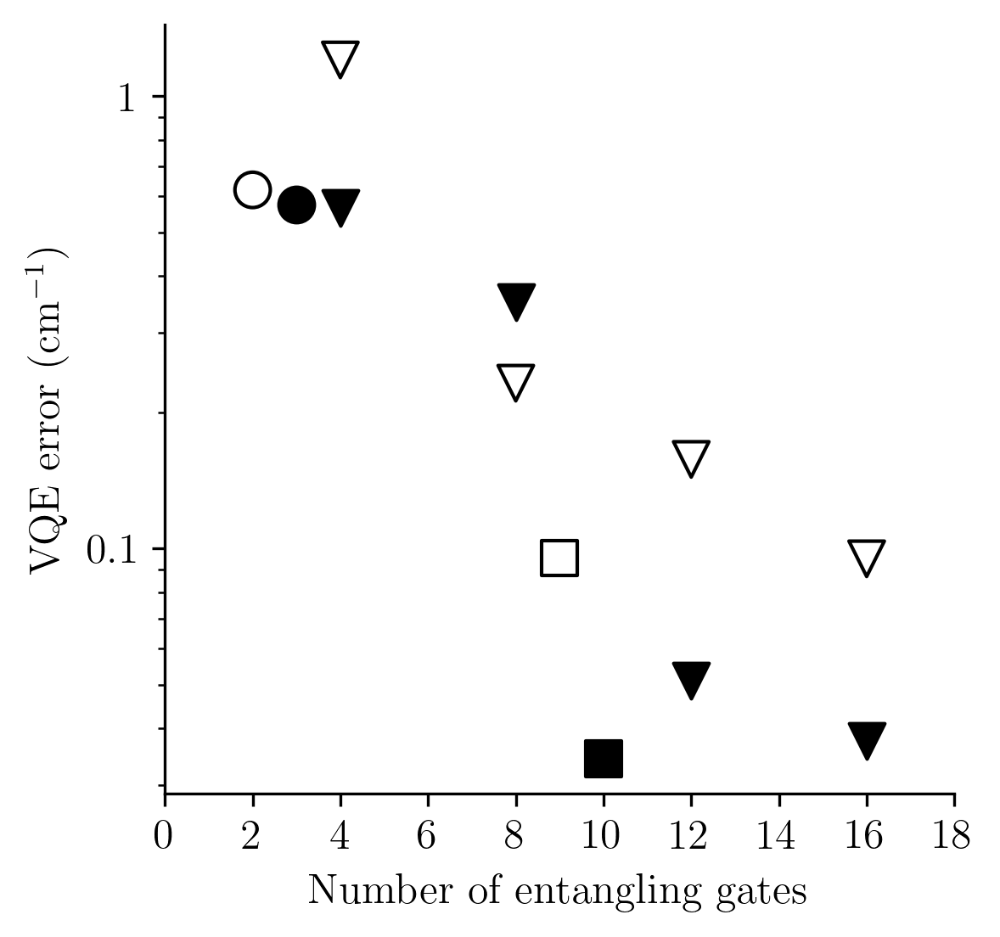

In [52]:
plt.rcParams["figure.figsize"] = (4,4)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

reps = [1, 2, 3, 4]
for j, rep in enumerate(reps):
    lin_energies = data['arhcl']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    # ax.scatter(4 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='v', 
    #            edgecolors='none', color=cmap(j), alpha=0.5, s=100)
    ax.scatter(4 * rep, lin_energies[ind] - ref_full['arhcl'][0], marker='v', 
               facecolors='none', edgecolors='black', alpha=1, s=100)
    
    
    # full_energies = data['arhcl']['full'][rep][0]['energies']
    # ind = np.argmin(full_energies)
    # ax.scatter(10 * rep, full_energies[ind] - ref_full['arhcl'][0], marker='^', 
    #            edgecolors='none', color=cmap(j), alpha=0.5, s=100)
    # ax.scatter(10 * rep, full_energies[ind] - ref_full['arhcl'][0], marker='^', 
    #            facecolors='none', edgecolors='black', alpha=1, s=100)

    lin_energies = data['mgnh']['linear'][rep][0]['energies']
    ind = np.argmin(lin_energies)
    ax.scatter(4 * rep, lin_energies[ind] - ref_full['mgnh'][0], marker='v', 
               color='black', alpha=1, s=100)
    
    # full_energies = data['mgnh']['full'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # ax.scatter(10 * rep, lin_energies[ind] - ref_full['mgnh'][0], marker='^',
    #            edgecolors='none', color=cmap(j), alpha=0.5, s=100)
    
    
# ax.plot(4 * np.arange(1, 5), arhcl_linear_energies - ref_full['arhcl'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(2, arhcl_greedyent_const_energies[0][2] - ref_full['arhcl'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(2, arhcl_greedyent_const_energies[0][2] - ref_full['arhcl'][0], zorder=20, 
#             facecolors=cmap(0), edgecolors='none', s=100, alpha=1)
ax.scatter(9, arhcl_greedyent_const_energies[3][9] - ref_full['arhcl'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
# ax.scatter(9, arhcl_greedyent_const_energies[3][9] - ref_full['arhcl'][0], marker='s', zorder=20, 
#             facecolors=cmap(3), edgecolors='none', s=100, alpha=1)

# ax.scatter(3, mgnh_greedyent_const_energies[0][3] - ref_full['mgnh'][0], zorder=20, 
#             facecolors='none', edgecolors='black', s=100)
ax.scatter(3, mgnh_greedyent_const_energies[0][3] - ref_full['mgnh'][0], zorder=20, 
            facecolors='black', s=100, alpha=1)
# ax.scatter(10, mgnh_greedyent_const_energies[3][10] - ref_full['mgnh'][0], marker='s', zorder=20, 
#             facecolors='none', edgecolors='black', s=100)
ax.scatter(10, mgnh_greedyent_const_energies[3][10] - ref_full['mgnh'][0], marker='s', zorder=20, 
            facecolors='black', s=100, alpha=1)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
# ax.axhline(ref_full['arhcl'][0] - ref_full['arhcl'][0] + 0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
# ax.axhline(ref_full['arhcl'][0] - ref_full['arhcl'][0] + 1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates', labelpad=5)
ax.set_xticks([2 * i for i in range(10)], [str(2 * i) for i in range(10)])
# ax.set_ylim(7e-2, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)', labelpad=5)
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
ax.set_yticks([0.1, 1], ['0.1', '1'])

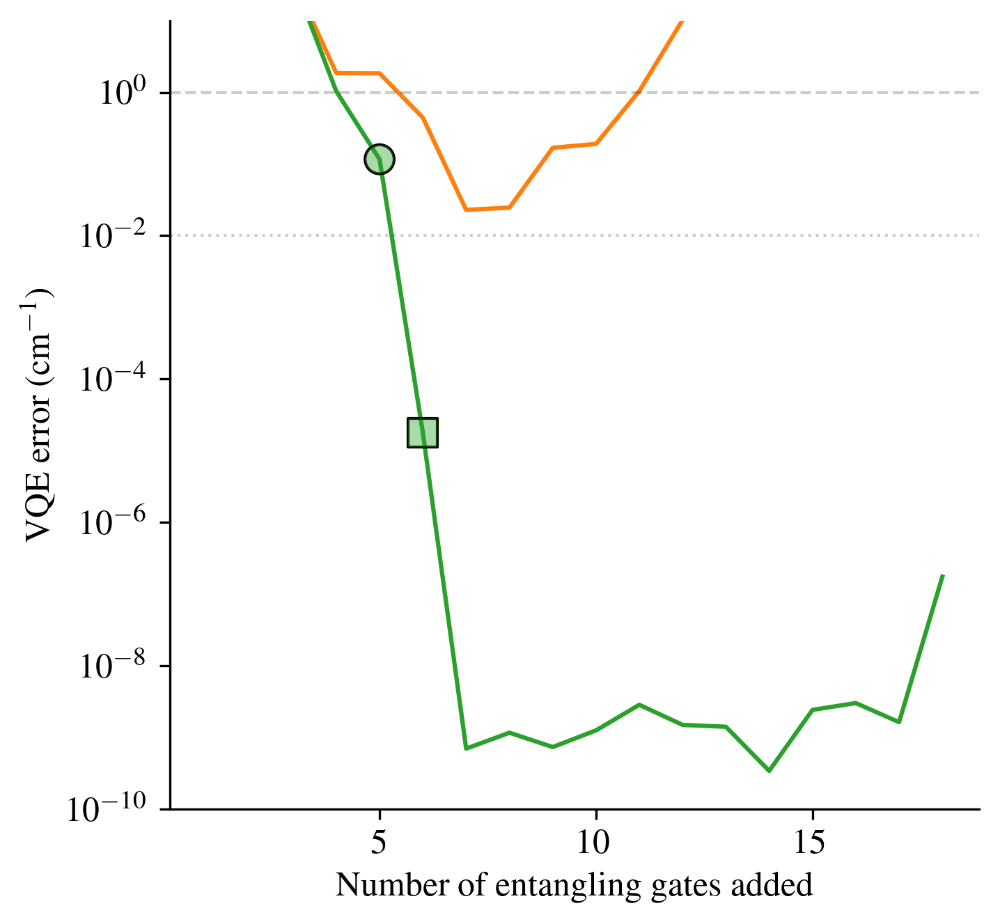

In [67]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_1_greedyent_const_energies = []
cr2_1_greedyent_const_circs = []
cr2_1_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_1_greedyent_const_circs.append(greedyent_const_data['cr2_1'][rep][rep * 6]['removed_gates'])
    cr2_1_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_1'][rep][i]
        cr2_1_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_1_greedyent_const_energies[j] - ref_full['cr2_1_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_1_greedyent_const_energies[j][1:] - ref_constrained['cr2_1_16'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_1_greedyent_const_energies[j] - ref_full['cr2_1'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_1_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_1'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_1_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_1_linear_energies - ref_full['cr2_1'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(5, cr2_1_greedyent_const_energies[2][5] - ref_constrained['cr2_1_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(5, cr2_1_greedyent_const_energies[2][5] - ref_constrained['cr2_1_16'][0], zorder=20, 
            facecolors=cmap(2), edgecolors='none', s=100, alpha=0.4)
ax.scatter(6, cr2_1_greedyent_const_energies[2][6] - ref_constrained['cr2_1_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(6, cr2_1_greedyent_const_energies[2][6] - ref_constrained['cr2_1_16'][0], marker='s', zorder=20, 
            facecolors=cmap(2), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_1', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_1 (32 points)')

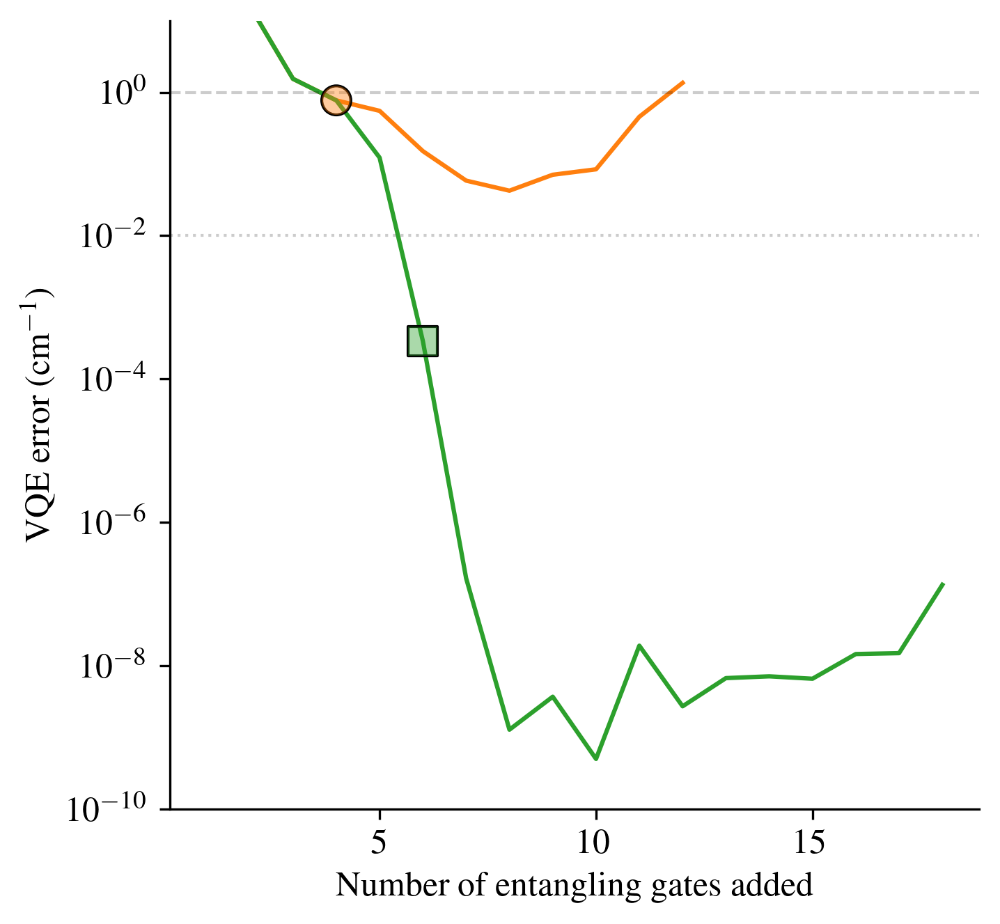

In [68]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_3_greedyent_const_energies = []
cr2_3_greedyent_const_circs = []
cr2_3_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_3_greedyent_const_circs.append(greedyent_const_data['cr2_3'][rep][rep * 6]['removed_gates'])
    cr2_3_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_3'][rep][i]
        cr2_3_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_3_greedyent_const_energies[j] - ref_full['cr2_3_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_3_greedyent_const_energies[j][1:] - ref_constrained['cr2_3_16'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_3_greedyent_const_energies[j] - ref_full['cr2_3'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_3_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_3'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_3_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_3_linear_energies - ref_full['cr2_3'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(4, cr2_3_greedyent_const_energies[1][4] - ref_constrained['cr2_3_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(4, cr2_3_greedyent_const_energies[1][4] - ref_constrained['cr2_3_16'][0], zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)
ax.scatter(6, cr2_3_greedyent_const_energies[2][6] - ref_constrained['cr2_3_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(6, cr2_3_greedyent_const_energies[2][6] - ref_constrained['cr2_3_16'][0], marker='s', zorder=20, 
            facecolors=cmap(2), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_3', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_3 (32 points)')

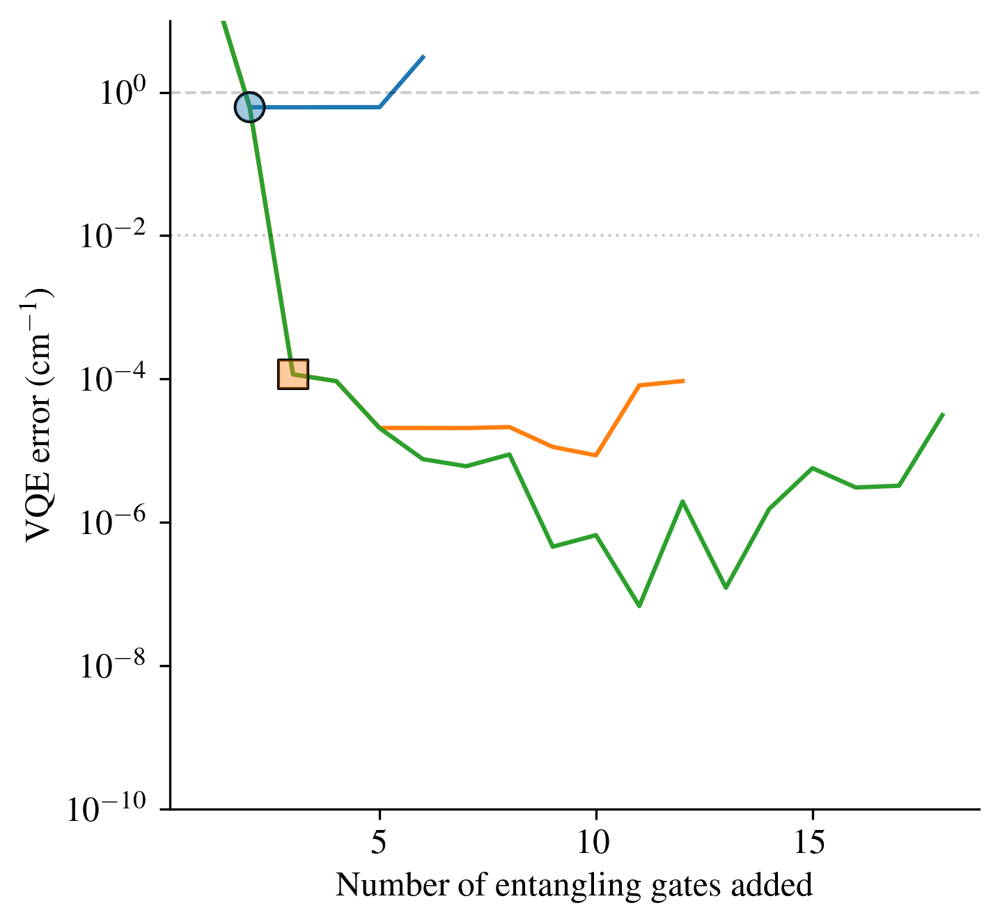

In [69]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_5_greedyent_const_energies = []
cr2_5_greedyent_const_circs = []
cr2_5_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_5_greedyent_const_circs.append(greedyent_const_data['cr2_5'][rep][rep * 6]['removed_gates'])
    cr2_5_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_5'][rep][i]
        cr2_5_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_5_greedyent_const_energies[j] - ref_full['cr2_5_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_5_greedyent_const_energies[j][1:] - ref_constrained['cr2_5_16'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_5_greedyent_const_energies[j] - ref_full['cr2_5'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_5_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_5'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_5_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_5_linear_energies - ref_full['cr2_5'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(2, cr2_5_greedyent_const_energies[0][2] - ref_constrained['cr2_5_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(2, cr2_5_greedyent_const_energies[0][2] - ref_constrained['cr2_5_16'][0], zorder=20, 
            facecolors=cmap(0), edgecolors='none', s=100, alpha=0.4)
ax.scatter(3, cr2_5_greedyent_const_energies[1][3] - ref_constrained['cr2_5_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_5_greedyent_const_energies[1][3] - ref_constrained['cr2_5_16'][0], marker='s', zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_5', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_5 (32 points)')

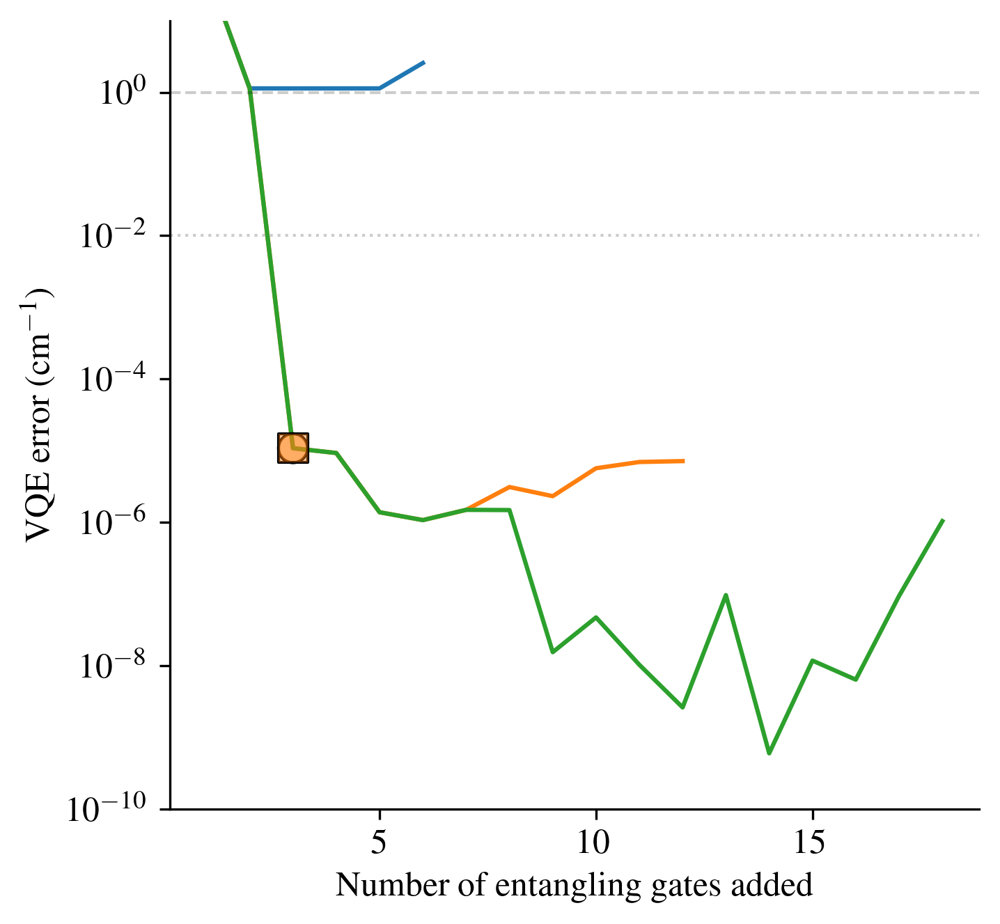

In [70]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_7_greedyent_const_energies = []
cr2_7_greedyent_const_circs = []
cr2_7_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_7_greedyent_const_circs.append(greedyent_const_data['cr2_7'][rep][rep * 6]['removed_gates'])
    cr2_7_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_7'][rep][i]
        cr2_7_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_7_greedyent_const_energies[j] - ref_full['cr2_7_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_7_greedyent_const_energies[j][1:] - ref_constrained['cr2_7_16'][0], label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_7_greedyent_const_energies[j] - ref_full['cr2_7'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_7_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_7'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_7_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_7_linear_energies - ref_full['cr2_7'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(3, cr2_7_greedyent_const_energies[1][3] - ref_constrained['cr2_7_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_7_greedyent_const_energies[1][3] - ref_constrained['cr2_7_16'][0], zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)
ax.scatter(3, cr2_7_greedyent_const_energies[1][3] - ref_constrained['cr2_7_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_7_greedyent_const_energies[1][3] - ref_constrained['cr2_7_16'][0], marker='s', zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_7', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_7 (32 points)')

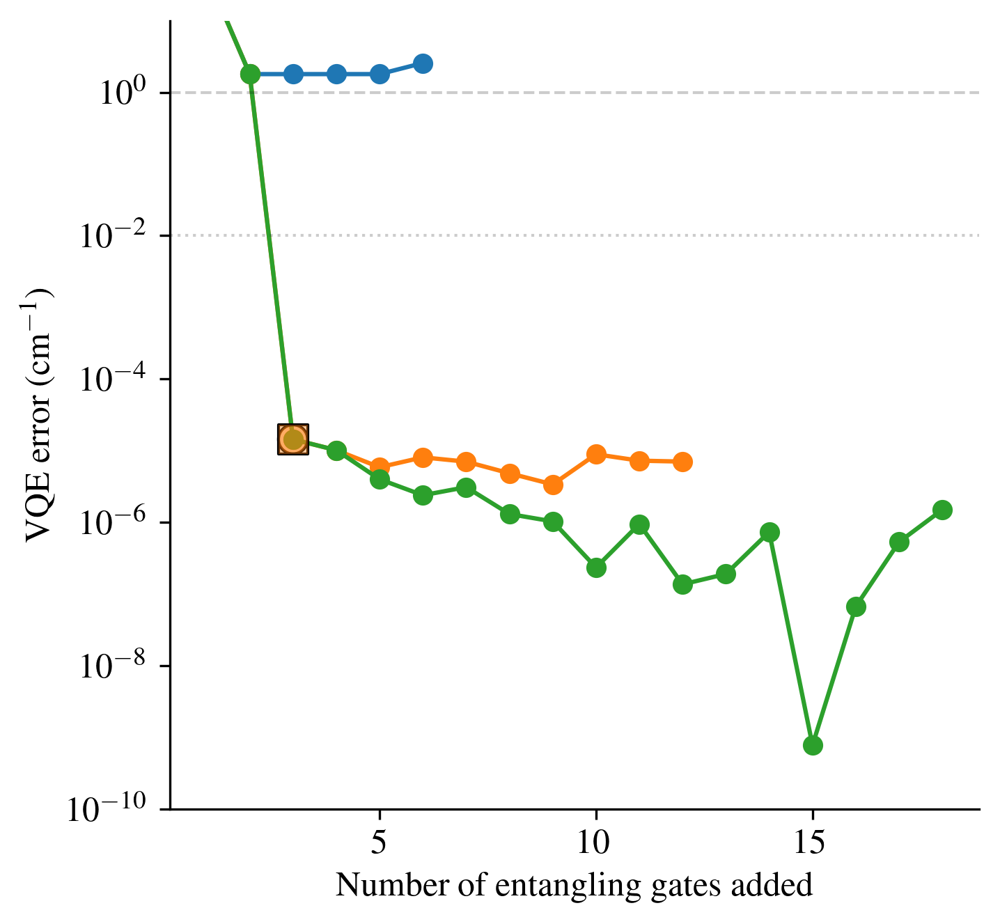

In [71]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_9_greedyent_const_energies = []
cr2_9_greedyent_const_circs = []
cr2_9_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_9_greedyent_const_circs.append(greedyent_const_data['cr2_9'][rep][rep * 6]['removed_gates'])
    cr2_9_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_9'][rep][i]
        cr2_9_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_9_greedyent_const_energies[j] - ref_full['cr2_9_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_9_greedyent_const_energies[j][1:] - ref_constrained['cr2_9_16'][0], 'o-', label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_9_greedyent_const_energies[j] - ref_full['cr2_9'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_9_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_9'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_9_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_9_linear_energies - ref_full['cr2_9'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(3, cr2_9_greedyent_const_energies[1][3] - ref_constrained['cr2_9_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_9_greedyent_const_energies[1][3] - ref_constrained['cr2_9_16'][0], zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)
ax.scatter(3, cr2_9_greedyent_const_energies[1][3] - ref_constrained['cr2_9_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_9_greedyent_const_energies[1][3] - ref_constrained['cr2_9_16'][0], marker='s', zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_9', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_9 (32 points)')

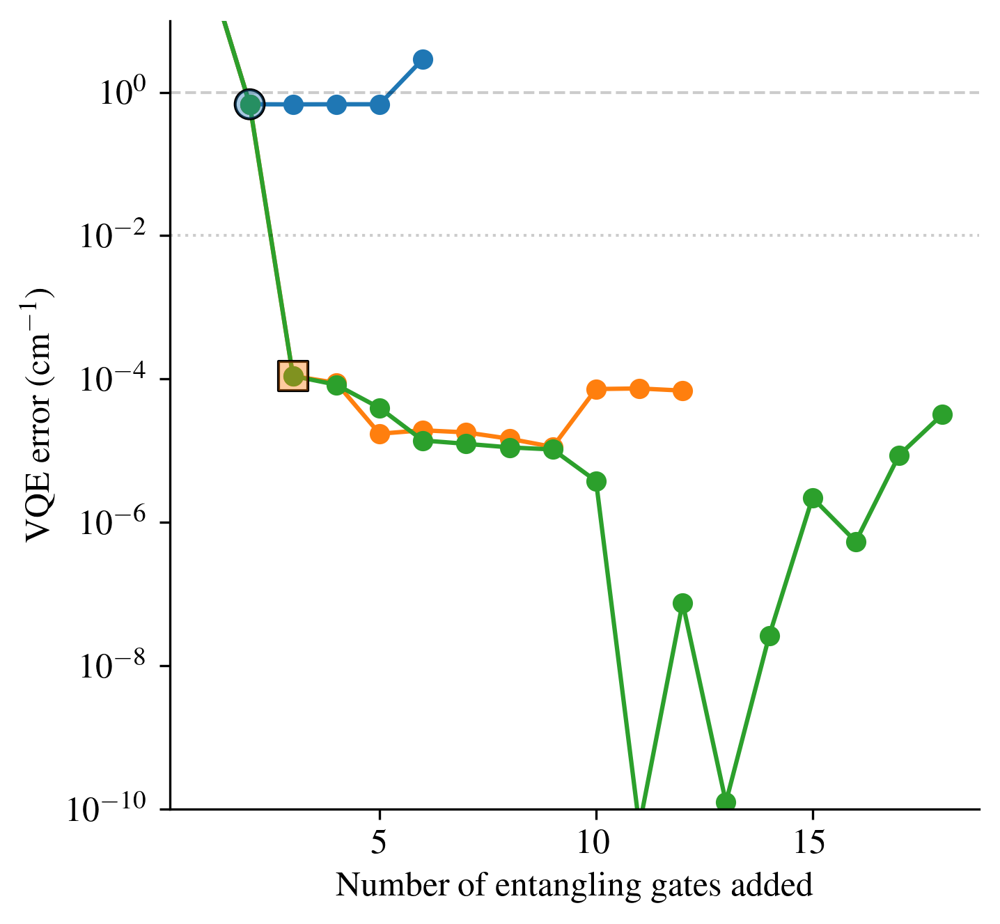

In [72]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_11_greedyent_const_energies = []
cr2_11_greedyent_const_circs = []
cr2_11_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_11_greedyent_const_circs.append(greedyent_const_data['cr2_11'][rep][rep * 6]['removed_gates'])
    cr2_11_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_11'][rep][i]
        cr2_11_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_11_greedyent_const_energies[j] - ref_full['cr2_11_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_11_greedyent_const_energies[j][1:] - ref_constrained['cr2_11_16'][0], 'o-', label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_11_greedyent_const_energies[j] - ref_full['cr2_11'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_11_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_11'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_11_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_11_linear_energies - ref_full['cr2_11'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(2, cr2_11_greedyent_const_energies[0][2] - ref_constrained['cr2_11_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(2, cr2_11_greedyent_const_energies[0][2] - ref_constrained['cr2_11_16'][0], zorder=20, 
            facecolors=cmap(0), edgecolors='none', s=100, alpha=0.4)
ax.scatter(3, cr2_11_greedyent_const_energies[1][3] - ref_constrained['cr2_11_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_11_greedyent_const_energies[1][3] - ref_constrained['cr2_11_16'][0], marker='s', zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_11', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_11 (32 points)')

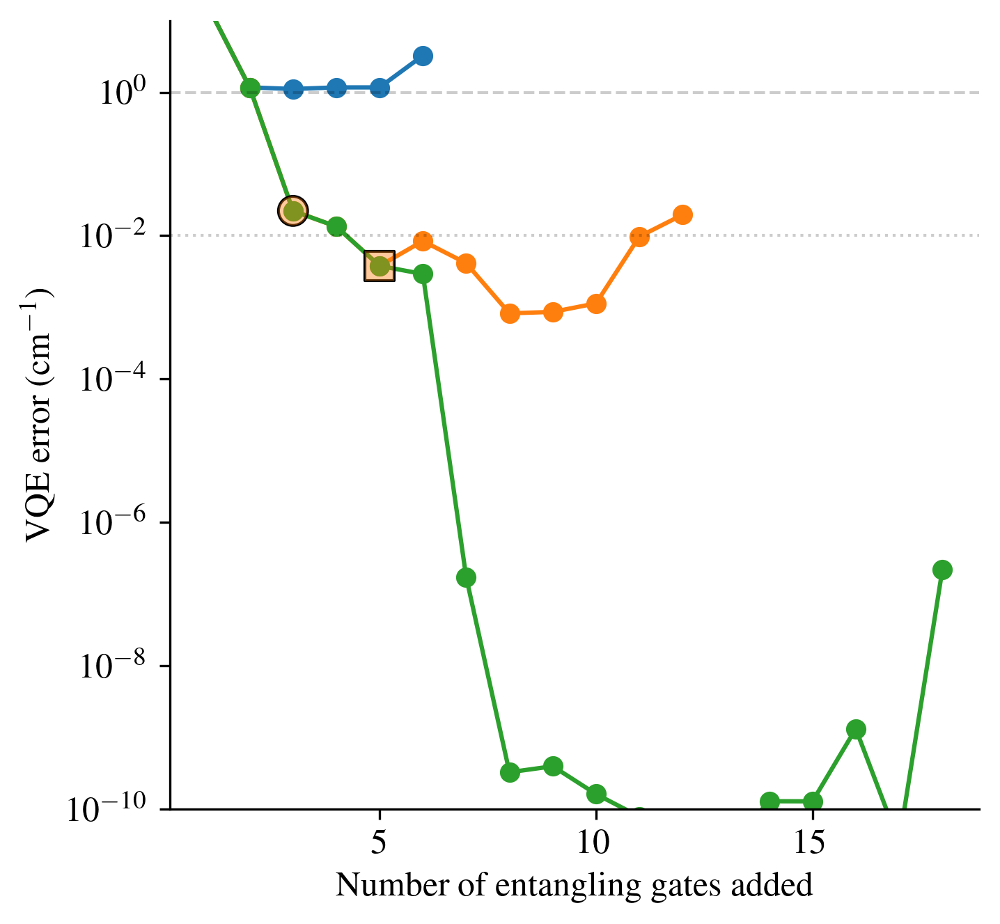

In [73]:
plt.rcParams["figure.figsize"] = (5,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

ax = plt.subplot()

cr2_13_greedyent_const_energies = []
cr2_13_greedyent_const_circs = []
cr2_13_linear_energies = []
reps = [1, 2, 3]
spin = 1
for j, rep in enumerate(reps):
    cr2_13_greedyent_const_circs.append(greedyent_const_data['cr2_13'][rep][rep * 6]['removed_gates'])
    cr2_13_greedyent_const_energies.append([0])
    for i in range(1, 6 * rep + 1):
        d = greedyent_const_data['cr2_13'][rep][i]
        cr2_13_greedyent_const_energies[j].append(d['energies'])

    # ax.plot(range(1, 6 * rep + 1), cr2_13_greedyent_const_energies[j] - ref_full['cr2_13_1'][0], label=f'{rep} ansatz reps.')
    ax.plot(range(1, 6 * rep + 1), cr2_13_greedyent_const_energies[j][1:] - ref_constrained['cr2_13_16'][0], 'o-', label=f'{rep} ansatz reps.')
    # ax.axvline(rep * 10, ls='--', c=cmap(j), alpha=0.6)
    # ax.plot(np.linspace(0, 10, 10 * rep, endpoint=True), cr2_13_greedyent_const_energies[j] - ref_full['cr2_13'][0])

    # lin_energies = data['cr2_16'][spin]['linear'][rep][0]['energies']
    # ind = np.argmin(lin_energies)
    # cr2_13_linear_energies.append(lin_energies[ind])
    # ax.axhline(lin_energies[ind] - ref_full['cr2_13'][0], ls='--', c=cmap(j), alpha=0.6)
    # ax.scatter(3 * rep, lin_energies[ind] - ref_full['cr2_13_1'][0], marker='v', color=cmap(j), alpha=1, s=100)

# ax.plot(4 * np.arange(1, 5), cr2_13_linear_energies - ref_full['cr2_13'][0], ls='solid', color='black', alpha=0.3)
ax.scatter(3, cr2_13_greedyent_const_energies[1][3] - ref_constrained['cr2_13_16'][0], zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(3, cr2_13_greedyent_const_energies[1][3] - ref_constrained['cr2_13_16'][0], zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)
ax.scatter(5, cr2_13_greedyent_const_energies[1][5] - ref_constrained['cr2_13_16'][0], marker='s', zorder=20, 
            facecolors='none', edgecolors='black', s=100)
ax.scatter(5, cr2_13_greedyent_const_energies[1][5] - ref_constrained['cr2_13_16'][0], marker='s', zorder=20, 
            facecolors=cmap(1), edgecolors='none', s=100, alpha=0.4)

# ax.text(1 * 10  - 6, 1.8, f'$k = {1}$', c=cmap(0))
# ax.text(2 * 10  - 6, 0.3, f'$k = {2}$', c=cmap(1))
# ax.text(3 * 10  - 6, 0.2, f'$k = {3}$', c=cmap(2))
# ax.text(4 * 10  - 6, 0.13, f'$k = {4}$', c=cmap(3))
ax.axhline(0.01, ls='dotted', c='black', alpha=0.2, linewidth=1)
ax.axhline(1, ls='--', c='black', alpha=0.2, linewidth=1)
# ax.text(-1, 0.1, "DVR Error", color='black', fontdict={'fontsize': 10}, alpha=0.6)
# ax.text(-0.5, 0.1, "$\Delta E^{{\\rm DVR}}$", color='black', fontdict={'fontsize': 10}, alpha=0.6)
ax.set_yscale('log')
ax.set_xlabel('Number of entangling gates added')
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
# ax.ylabel("$\Delta E^{{\\rm VQE}}$ (cm$^{-1}$)")
ax.set_ylim(1e-10, 10)
ax.set_ylabel('VQE error (cm$^{-1}$)')
ax.spines.right.set_visible(False)
ax.spines.top.set_visible(False)
# ax.set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
# ax.legend()
# ax.text(25, 10, 'cr2_13', fontdict=dict(fontsize=18), bbox=dict(facecolor='white', alpha=1, pad=10))
# ax.title('cr2_13 (32 points)')

In [74]:
arhcl_greedyent_const_energies[-1]

[array(-94.70158761),
 array(-102.47952165),
 array(-114.64454396),
 array(-114.95439958),
 array(-114.98515461),
 array(-115.03692799),
 array(-115.10212448),
 array(-115.12467142),
 array(-115.13154298),
 array(-115.16981199),
 array(-115.17674755),
 array(-115.17682686),
 array(-115.17740609),
 array(-115.17770661),
 array(-115.17681007),
 array(-115.17668424),
 array(-115.17676487),
 array(-115.17671287),
 array(-115.17697543),
 array(-115.17593764),
 array(-115.17622479),
 array(-115.17621842),
 array(-115.17708572),
 array(-115.17750923),
 array(-115.17741653),
 array(-115.17710817),
 array(-115.17718226),
 array(-115.17712119),
 array(-115.1774962),
 array(-115.1767879),
 array(-115.17710236),
 array(-115.17669881),
 array(-115.17590891),
 array(-115.17702525),
 array(-115.1760295),
 array(-115.17545608),
 array(-115.17458399),
 array(-115.174526),
 array(-115.16994921),
 array(-115.15809992),
 array(-115.17051003)]

In [44]:
reps = [1, 2, 3, 4, 5]
partitions = ['0-1234', '01-234', '012-34', '0123-4']
best_energies = []
# partitions = ['012-34', '0123-4']
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data['arhcl'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies.append(best_partition_energies)
    
best_energies = np.array(best_energies)
min_energies = np.min(best_energies, axis=1)
min_energies = np.append(min_energies, np.min(arhcl_greedyent_const_energies[-1]))
print(best_energies)
print(min_energies)

reps = [1, 2, 3, 4, 5]
partitions = ['0-12345', '01-2345', '012-345', '0123-45', '01234-5']
best_energies_64 = []
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data_64['arhcl'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies_64.append(best_partition_energies)
    
best_energies_64 = np.array(best_energies_64)
min_energies_64 = np.min(best_energies_64, axis=1)
min_energies_64 = np.append(min_energies_64, np.min(arhcl_greedyent_const_energies_64[-1]))
print(best_energies_64)
print(min_energies_64)

[[-102.62204925 -102.66599624 -102.66732426 -102.66732426 -102.66732426]
 [ -96.52850531  -96.52855128  -96.52855128  -96.52855128  -96.52855128]
 [-114.67448201 -114.98456318 -114.98456318 -114.98456318 -114.98456318]
 [-114.67229364 -115.06072243 -115.06436564 -115.06436564 -115.06436564]]
[-102.66732426  -96.52855128 -114.98456318 -115.06436564 -115.17770661]
[[-107.53722539 -107.55230718 -107.55424656 -107.55451723 -107.55451723]
 [-107.97370302 -107.97396207 -107.97397806 -107.97399084 -107.97399084]
 [-107.90581761 -107.90616782 -107.90616782 -107.90616782 -107.90616782]
 [-114.05756665 -114.98848945 -114.98851882 -114.98851882 -114.98851882]
 [-114.03241214 -115.06542615 -115.07248466 -115.07300508 -115.07309063]]
[-107.55451723 -107.97399084 -107.90616782 -114.98851882 -115.07309063
 -115.1933448 ]


In [45]:
plt.rcParams["figure.figsize"] = (10,5)
plt.rcParams["font.size"] = 12
plt.rcParams["figure.dpi"] = 300

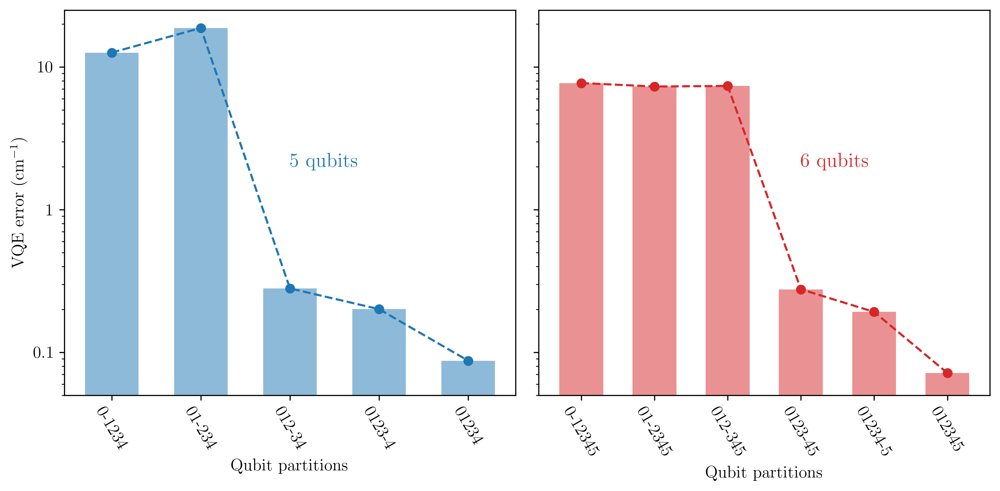

In [46]:
# add subplots
fig, axs = plt.subplots(1, 2, sharey=True)
# fig.set_figheight(3)

axs[0].bar(np.arange(5), min_energies - ref_full['arhcl'][0], width=0.6, alpha=0.5, color=cmap(0))
axs[0].plot(np.arange(5), min_energies - ref_full['arhcl'][0], 'o--', c=cmap(0))
axs[0].set_xticks(np.arange(5), ['0-1234', '01-234', '012-34', '0123-4', '01234'], rotation=-60)
axs[0].set_ylim(0.05, 25)
axs[0].set_ylabel('VQE error (cm$^{-1}$)')
axs[0].set_xlabel('Qubit partitions')
axs[0].set_yscale('log')
axs[0].set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
axs[0].text(2, 2, '5 qubits', c=cmap(0), fontdict=dict(fontsize=14))
# axs[0].set_xticks(np.arange(11), ['{0}{1234}', '{01}{234}', '{012}{34}', '{0123}{4}', '{01234}', 
#                             '{0}{12345}', '{01}{2345}', '{012}{345}', '{0123}{45}', '{01234}{5}', '{012345}'], 
#             rotation=-60, fontsize=8)

axs[1].bar(np.arange(6), min_energies_64 - ref_full['arhcl'][0], width=0.6, alpha=0.5, color=cmap(3))
axs[1].plot(np.arange(6), min_energies_64 - ref_full['arhcl'][0], 'o--', c=cmap(3))
axs[1].set_xticks(np.arange(6), ['0-12345', '01-2345', '012-345', '0123-45', '01234-5', '012345'], rotation=-60)
axs[1].set_ylim(0.05, 25)
# axs[1].set_ylabel('VQE error (cm$^{-1}$)')
axs[1].set_xlabel('Qubit partitions')
axs[1].set_yscale('log')
axs[1].set_yticks([0.1, 1, 10], ['0.1', '1', '10'])
axs[1].set_ylim(0.05, 25)
axs[1].text(3, 2, '6 qubits', c=cmap(3), fontdict=dict(fontsize=14))


fig.tight_layout()

In [47]:
reps = [1, 2, 3, 4, 5]
partitions = ['0-1234', '01-234', '012-34', '0123-4']
best_energies = []
# partitions = ['012-34', '0123-4']
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data['mgnh'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies.append(best_partition_energies)
    
best_energies = np.array(best_energies)
min_energies = np.min(best_energies, axis=1)
min_energies = np.append(min_energies, np.min(mgnh_greedyent_const_energies[-1]))
print(best_energies)
print(min_energies)

reps = [1, 2, 3, 4, 5]
partitions = ['0-12345', '01-2345', '012-345', '0123-45', '01234-5']
best_energies_64 = []
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data_64['mgnh'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies_64.append(best_partition_energies)
    
best_energies_64 = np.array(best_energies_64)
min_energies_64 = np.min(best_energies_64, axis=1)
min_energies_64 = np.append(min_energies_64, np.min(mgnh_greedyent_const_energies_64[-1]))
print(best_energies_64)
print(min_energies_64)

[[-81.27177989 -81.36666233 -81.36701778 -81.36701778 -81.36701778]
 [-79.49149247 -79.49149251 -79.49149251 -79.49149251 -79.49149251]
 [-87.65002903 -87.65003324 -87.65003324 -87.65003324 -87.65003324]
 [-84.35755267 -84.36160741 -84.36164877 -84.36164877 -84.36164877]]
[-81.36701778 -79.49149251 -87.65003324 -84.36164877 -88.19567224]
[[-78.92668172 -78.98336581 -78.98693799 -78.98755236 -78.98823196]
 [-85.17025317 -85.17041757 -85.17042598 -85.17042598 -85.17042598]
 [-85.19498719 -85.22232994 -85.22232994 -85.22232994 -85.22232994]
 [-86.02506572 -87.68954693 -87.69026042 -87.69026042 -87.69026042]
 [-82.47978445 -84.36258241 -84.36705089 -84.36721166 -84.36725072]]
[-78.98823196 -85.17042598 -85.22232994 -87.69026042 -84.36725072
 -88.23351315]


[[-102.62204925 -102.66599624 -102.66732426 -102.66732426 -102.66732426]
 [ -96.52850531  -96.52855128  -96.52855128  -96.52855128  -96.52855128]
 [-114.67448201 -114.98456318 -114.98456318 -114.98456318 -114.98456318]
 [-114.67229364 -115.06072243 -115.06436564 -115.06436564 -115.06436564]]
[-102.66732426  -96.52855128 -114.98456318 -115.06436564 -115.17770661]
[[-107.53722539 -107.55230718 -107.55424656 -107.55451723 -107.55451723]
 [-107.97370302 -107.97396207 -107.97397806 -107.97399084 -107.97399084]
 [-107.90581761 -107.90616782 -107.90616782 -107.90616782 -107.90616782]
 [-114.05756665 -114.98848945 -114.98851882 -114.98851882 -114.98851882]
 [-114.03241214 -115.06542615 -115.07248466 -115.07300508 -115.07309063]]
[-107.55451723 -107.97399084 -107.90616782 -114.98851882 -115.07309063
 -115.1933448 ]


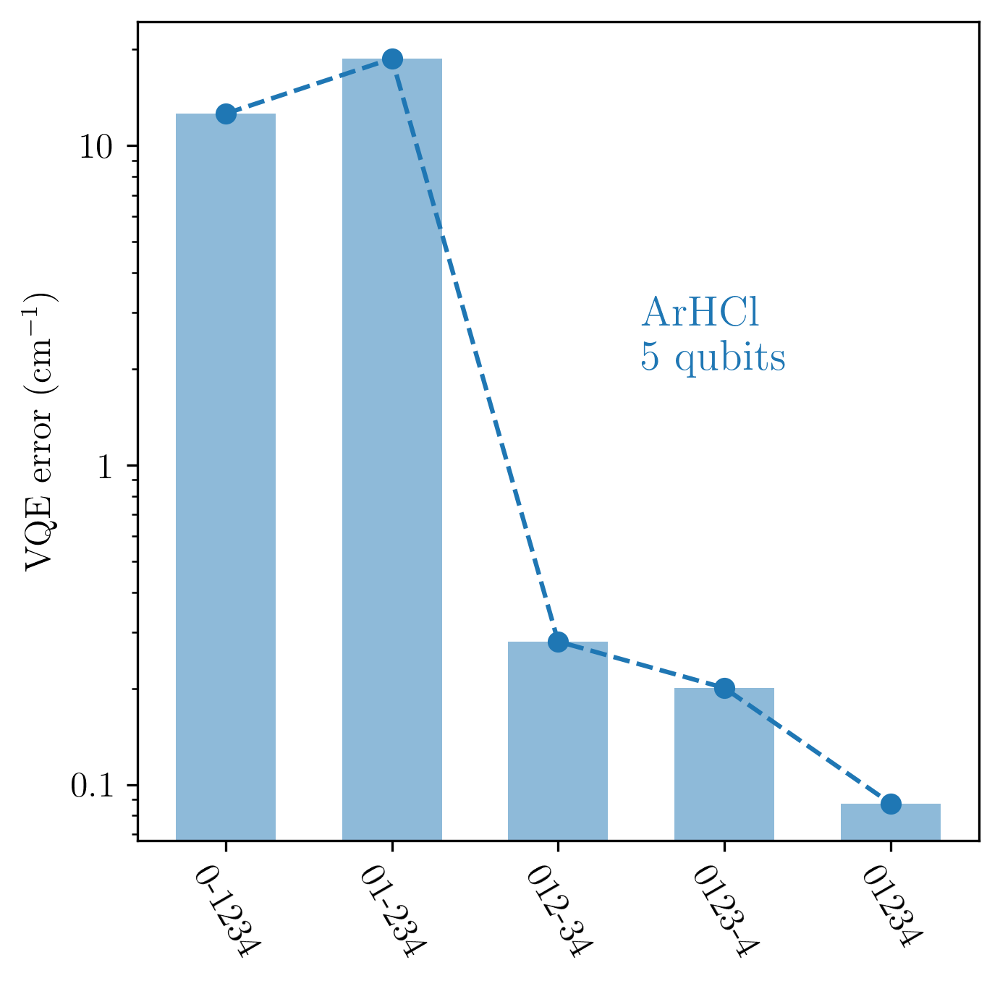

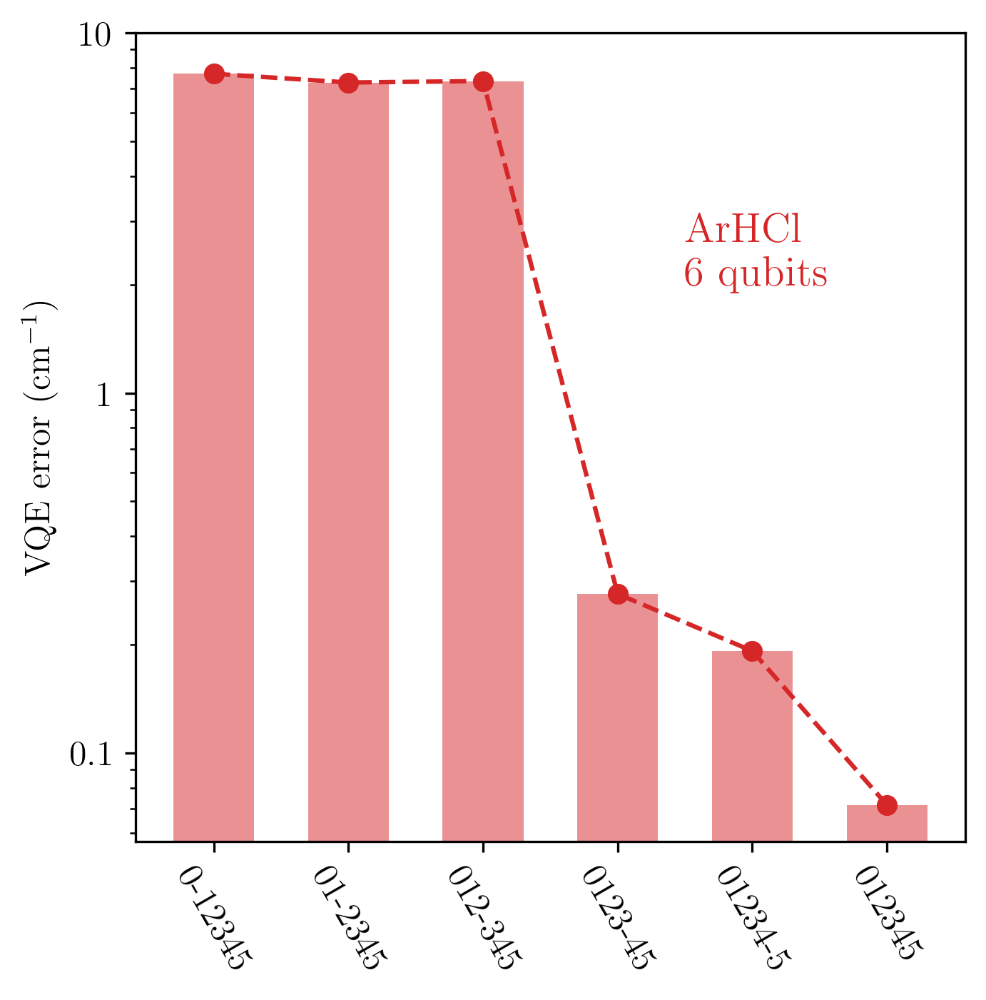

In [48]:
# add subplots
# fig, axs = plt.subplots(2, 2)
# fig.set_figheight(6)
plt.rcParams["figure.figsize"] = (5,5)

reps = [1, 2, 3, 4, 5]
partitions = ['0-1234', '01-234', '012-34', '0123-4']
best_energies = []
# partitions = ['012-34', '0123-4']
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data['arhcl'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies.append(best_partition_energies)
    
best_energies = np.array(best_energies)
min_energies = np.min(best_energies, axis=1)
min_energies = np.append(min_energies, np.min(arhcl_greedyent_const_energies[-1]))
print(best_energies)
print(min_energies)

reps = [1, 2, 3, 4, 5]
partitions = ['0-12345', '01-2345', '012-345', '0123-45', '01234-5']
best_energies_64 = []
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data_64['arhcl'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies_64.append(best_partition_energies)
    
best_energies_64 = np.array(best_energies_64)
min_energies_64 = np.min(best_energies_64, axis=1)
min_energies_64 = np.append(min_energies_64, np.min(arhcl_greedyent_const_energies_64[-1]))
print(best_energies_64)
print(min_energies_64)

plt.bar(np.arange(5), min_energies - ref_full['arhcl'][0], width=0.6, alpha=0.5, color=cmap(0))
plt.plot(np.arange(5), min_energies - ref_full['arhcl'][0], 'o--', c=cmap(0))
plt.xticks(np.arange(5), ['0-1234', '01-234', '012-34', '0123-4', '01234'], rotation=-60, fontsize=12)
# plt.set_ylim(0.05, 25)
plt.ylabel('VQE error (cm$^{-1}$)')
# plt.set_xlabel('Qubit partitions')
plt.yscale('log')
plt.yticks([0.1, 1, 10], ['0.1', '1', '10'])
# plt.yticks([0.001, 0.01, 0.1, 1], ['$10^{-3}$', '0.01', '0.1', '1'])
plt.text(2.5, 2, 'ArHCl \n 5 qubits', c=cmap(0), fontdict=dict(fontsize=14))
# axs[0].xticks(np.arange(11), ['{0}{1234}', '{01}{234}', '{012}{34}', '{0123}{4}', '{01234}', 
#                             '{0}{12345}', '{01}{2345}', '{012}{345}', '{0123}{45}', '{01234}{5}', '{012345}'], 
#             rotation=-60, fontsize=8)
plt.show()

plt.bar(np.arange(6), min_energies_64 - ref_full['arhcl'][0], width=0.6, alpha=0.5, color=cmap(3))
plt.plot(np.arange(6), min_energies_64 - ref_full['arhcl'][0], 'o--', c=cmap(3))
plt.xticks(np.arange(6), ['0-12345', '01-2345', '012-345', '0123-45', '01234-5', '012345'], rotation=-60, fontsize=12)
# plt.set_ylim(0.05, 25)
plt.ylabel('VQE error (cm$^{-1}$)')
# plt.set_xlabel('Qubit partitions')
plt.yscale('log')
plt.yticks([0.1, 1, 10], ['0.1', '1', '10'])
plt.text(3.5, 2, 'ArHCl \n 6 qubits', c=cmap(3), fontdict=dict(fontsize=14))
plt.show()


# fig.tight_layout()

[[-81.27177989 -81.36666233 -81.36701778 -81.36701778 -81.36701778]
 [-79.49149247 -79.49149251 -79.49149251 -79.49149251 -79.49149251]
 [-87.65002903 -87.65003324 -87.65003324 -87.65003324 -87.65003324]
 [-84.35755267 -84.36160741 -84.36164877 -84.36164877 -84.36164877]]
[-81.36701778 -79.49149251 -87.65003324 -84.36164877 -88.19567224]
[[-78.92668172 -78.98336581 -78.98693799 -78.98755236 -78.98823196]
 [-85.17025317 -85.17041757 -85.17042598 -85.17042598 -85.17042598]
 [-85.19498719 -85.22232994 -85.22232994 -85.22232994 -85.22232994]
 [-86.02506572 -87.68954693 -87.69026042 -87.69026042 -87.69026042]
 [-82.47978445 -84.36258241 -84.36705089 -84.36721166 -84.36725072]]
[-78.98823196 -85.17042598 -85.22232994 -87.69026042 -84.36725072
 -88.23351315]


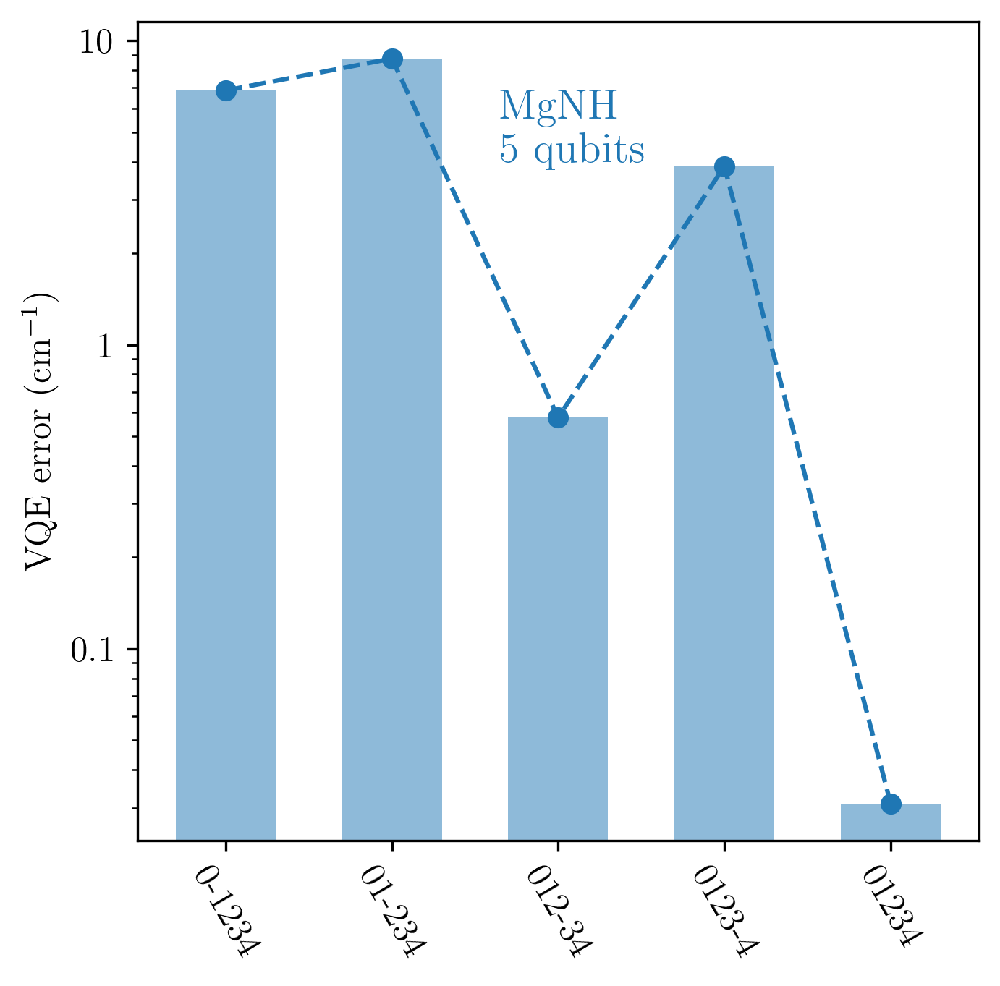

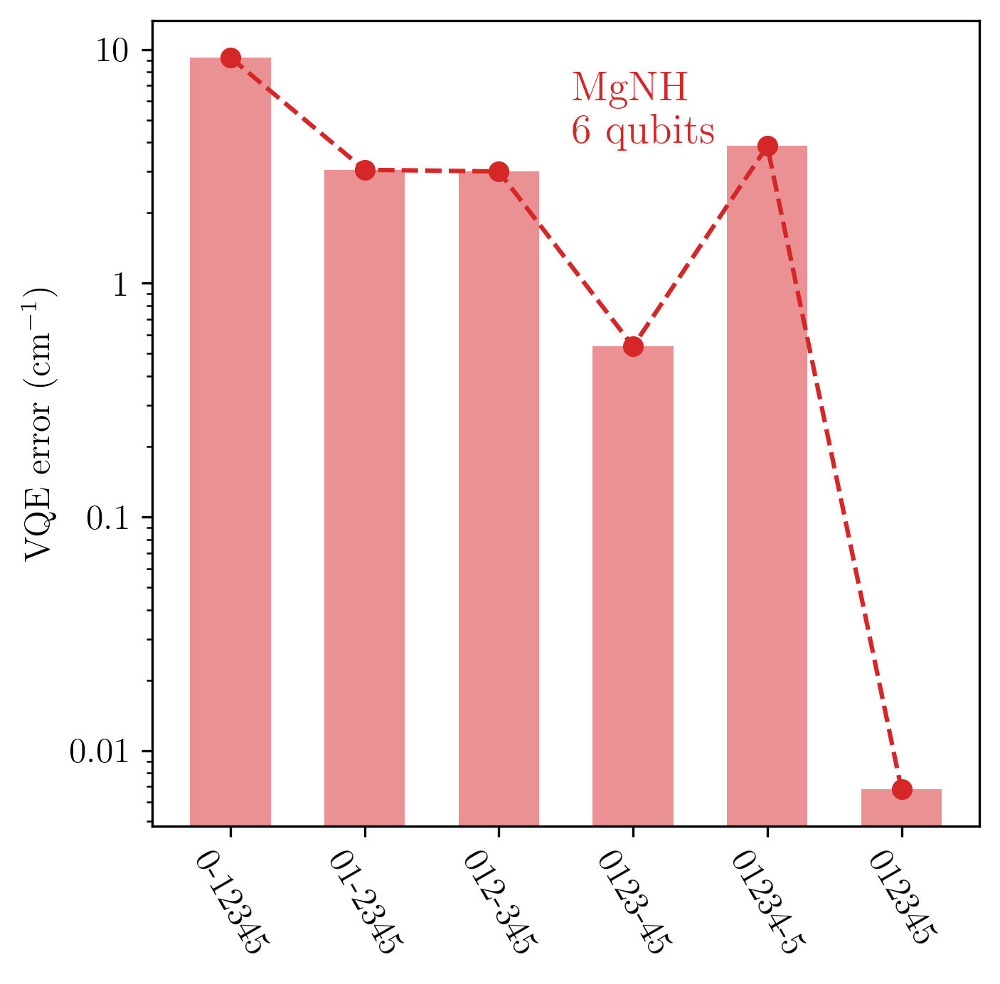

In [49]:
reps = [1, 2, 3, 4, 5]
partitions = ['0-1234', '01-234', '012-34', '0123-4']
best_energies = []
# partitions = ['012-34', '0123-4']
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data['mgnh'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies.append(best_partition_energies)
    
best_energies = np.array(best_energies)
min_energies = np.min(best_energies, axis=1)
min_energies = np.append(min_energies, np.min(mgnh_greedyent_const_energies[-1]))
print(best_energies)
print(min_energies)

reps = [1, 2, 3, 4, 5]
partitions = ['0-12345', '01-2345', '012-345', '0123-45', '01234-5']
best_energies_64 = []
for p in partitions:
    best_partition_energies = []
    for j, rep in enumerate(reps):
        layer_counts = len(find_allowed_gates(5, rep, partition_string_to_list(p)))
        partition_energies = []
        for i in range(1, layer_counts + 1):
            # print(i)
            partition_energies.append(partition_data_64['mgnh'][p][rep][i]['energies'])
        best_partition_energies.append(np.min(partition_energies))
    best_energies_64.append(best_partition_energies)
    
best_energies_64 = np.array(best_energies_64)
min_energies_64 = np.min(best_energies_64, axis=1)
min_energies_64 = np.append(min_energies_64, np.min(mgnh_greedyent_const_energies_64[-1]))
print(best_energies_64)
print(min_energies_64)

plt.bar(np.arange(5), min_energies - ref_full['mgnh'][0], width=0.6, alpha=0.5, color=cmap(0))
plt.plot(np.arange(5), min_energies - ref_full['mgnh'][0], 'o--', c=cmap(0))
plt.xticks(np.arange(5), ['0-1234', '01-234', '012-34', '0123-4', '01234'], rotation=-60, fontsize=12)
# axs[0].set_ylim(0.05, 25)
plt.ylabel('VQE error (cm$^{-1}$)')
# plt.set_xlabel('Qubit partitions')
plt.yscale('log')
plt.yticks([0.1, 1, 10], ['0.1', '1', '10'])
plt.text(1.65, 4, 'MgNH \n 5 qubits', c=cmap(0), fontdict=dict(fontsize=14))
# axs[0].xticks(np.arange(11), ['{0}{1234}', '{01}{234}', '{012}{34}', '{0123}{4}', '{01234}', 
#                             '{0}{12345}', '{01}{2345}', '{012}{345}', '{0123}{45}', '{01234}{5}', '{012345}'], 
#             rotation=-60, fontsize=8)
plt.show()

plt.bar(np.arange(6), np.abs(min_energies_64 - ref_full['mgnh'][0]), width=0.6, alpha=0.5, color=cmap(3))
plt.plot(np.arange(6), np.abs(min_energies_64 - ref_full['mgnh'][0]), 'o--', c=cmap(3))
plt.xticks(np.arange(6), ['0-12345', '01-2345', '012-345', '0123-45', '01234-5', '012345'], rotation=-60, fontsize=12)
plt.ylabel('VQE error (cm$^{-1}$)')
plt.text(2.55, 4, 'MgNH \n 6 qubits', c=cmap(3), fontdict=dict(fontsize=14))
# plt.set_xlabel('Qubit partitions')
plt.yscale('log')
plt.yticks([0.01, 0.1, 1, 10], ['0.01', '0.1', '1', '10'])
# axs[1].set_ylim(0.05, 25)
# axs[1].text(3, 2, '6 qubits', c=cmap(3), fontdict=dict(fontsize=12))
plt.show()


In [113]:
print(arhcl_greedyent_const_circs[0][:2], arhcl_greedyent_const_energies[0][2] - ref_full['arhcl'][0])
print(arhcl_greedyent_const_circs[3][:9], arhcl_greedyent_const_energies[3][9])

[4 1] 0.6204905669696075
[34 31  0 17  1 28  9 10  2] -115.16981199336878


In [114]:
print(arhcl_greedyent_const_circs_64[1][:5], arhcl_greedyent_const_energies_64[1][5] - ref_full['arhcl'][0])
print(arhcl_greedyent_const_circs_64[3][:12], arhcl_greedyent_const_energies_64[3][12] - ref_full['arhcl'][0])

[ 0  7 23 24  6] 0.6784956452063255
[ 0  7 23 30  9 20 17 45  8 14 39 46] 0.07978764152443318


In [115]:
print(mgnh_greedyent_const_circs[0][:3], mgnh_greedyent_const_energies[0][3])
print(mgnh_greedyent_const_circs[3][:10], mgnh_greedyent_const_energies[3][10])

[9 4 1] -87.65002903223721
[39  4 21  8 13 19  7 34 30 14] -88.19245369159697


In [117]:
print(mgnh_greedyent_const_circs_64[0][:7], mgnh_greedyent_const_energies_64[0][7])
print(mgnh_greedyent_const_circs_64[2][:14], mgnh_greedyent_const_energies_64[2][14])

[ 0 14  7 29 15  1 24] -87.71597660635169
[ 0 14  7 29 34 46  9 51 35 45  1 15 49 16] -88.2281975137193


In [152]:
print(1)
print(cr2_1_greedyent_const_circs[2][:5], cr2_1_greedyent_const_energies[2][5])
print(cr2_1_greedyent_const_circs[2][:6], cr2_1_greedyent_const_energies[2][6])
print(3)
print(cr2_3_greedyent_const_circs[1][:4], cr2_3_greedyent_const_energies[1][4])
print(cr2_3_greedyent_const_circs[2][:6], cr2_3_greedyent_const_energies[2][6])
print(5)
print(cr2_5_greedyent_const_circs[0][:2], cr2_5_greedyent_const_energies[0][2])
print(cr2_5_greedyent_const_circs[1][:3], cr2_5_greedyent_const_energies[1][3])
print(7)
print(cr2_7_greedyent_const_circs[1][:3], cr2_7_greedyent_const_energies[1][3])
print(9)
print(cr2_9_greedyent_const_circs[1][:3], cr2_9_greedyent_const_energies[1][3])
print(11)
print(cr2_11_greedyent_const_circs[0][:2], cr2_11_greedyent_const_energies[0][2])
print(cr2_11_greedyent_const_circs[1][:3], cr2_11_greedyent_const_energies[1][3])
print(13)
print(cr2_13_greedyent_const_circs[1][:3], cr2_13_greedyent_const_energies[1][3])
print(cr2_13_greedyent_const_circs[1][:5], cr2_13_greedyent_const_energies[1][5])

1
[ 0  1 11 13 16] -15358.870177875691
[ 0  1 11 13 16  4] -15358.986420437785
3
[3 1 7 5] -9861.369113804718
[ 3  1  7  5 15 17] -9862.139508788765
5
[3 1] -7565.881071527343
[3 1 7] -7566.500032796257
7
[3 1 9] -6519.035989976722
9
[3 7 1] -5348.822995546799
11
[3 1] -3677.0038448686087
[3 7 1] -3677.6840004765313
13
[3 1 9] -548.6534012333912
[3 1 9 4 8] -548.6717595457965


In [104]:
my_gate_names = {
    'name': 'iqx',
    # 'subfontsize': -1,
    # "displaytext": {
    #     'ry': ' '
    # },
    "displaycolor": {
        "ry": [
            "#9F1853",
            "#9F1853"
        ],
        "cx": [ # gate name
            "#002D9C",
            "#000000"
        ],
    },
}

6


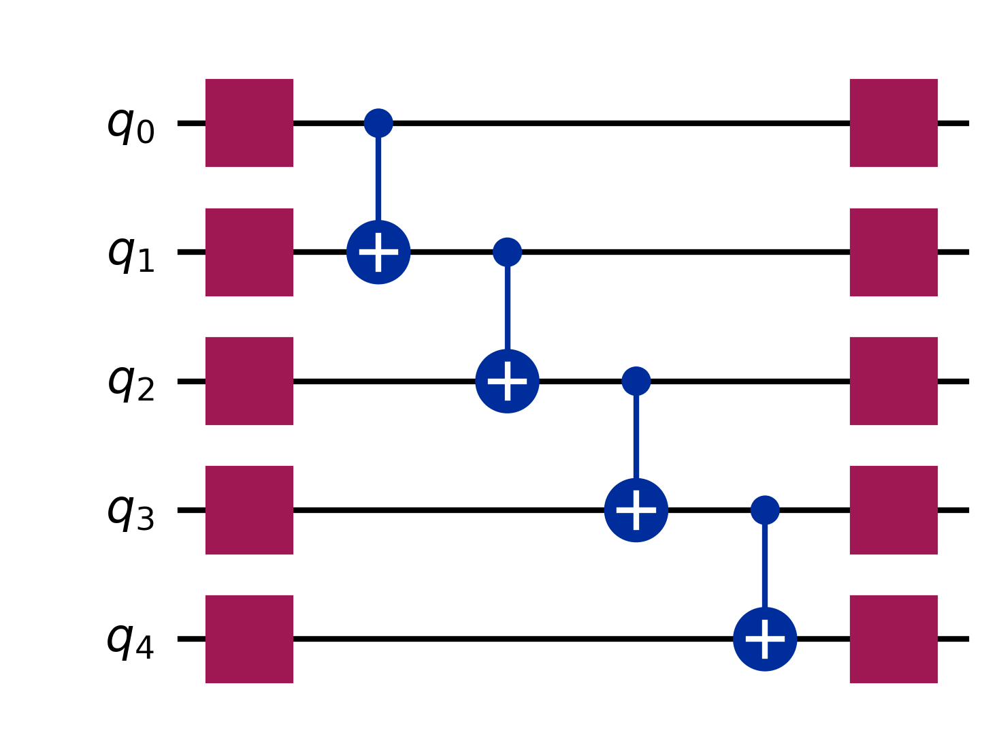

In [105]:
%autoreload
from lib.greedy_circs import build_circuit_ent

reps = 1
gates = [0, 4, 7, 9]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

4


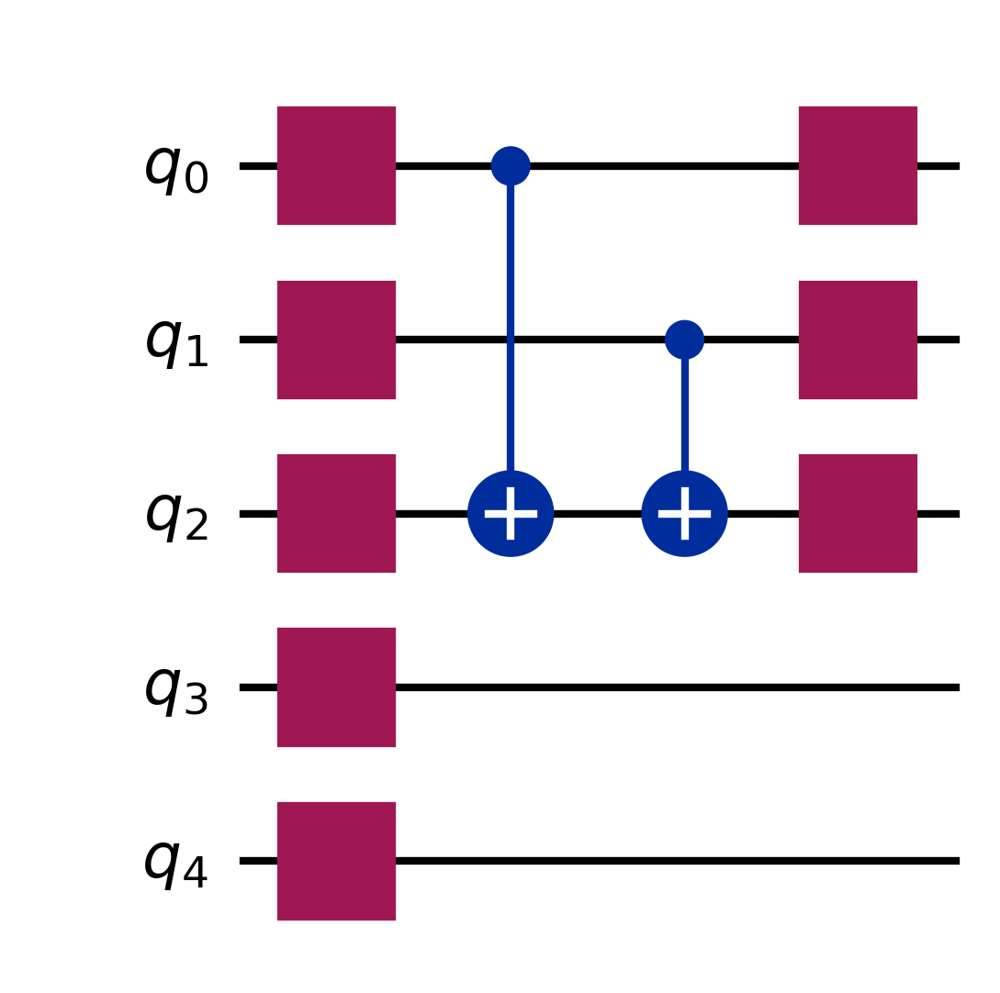

In [106]:
%autoreload
from lib.greedy_circs import build_circuit_ent

reps = 1
gates = arhcl_greedyent_const_circs[0][:2]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

[ 0  7 23 24  6]
7


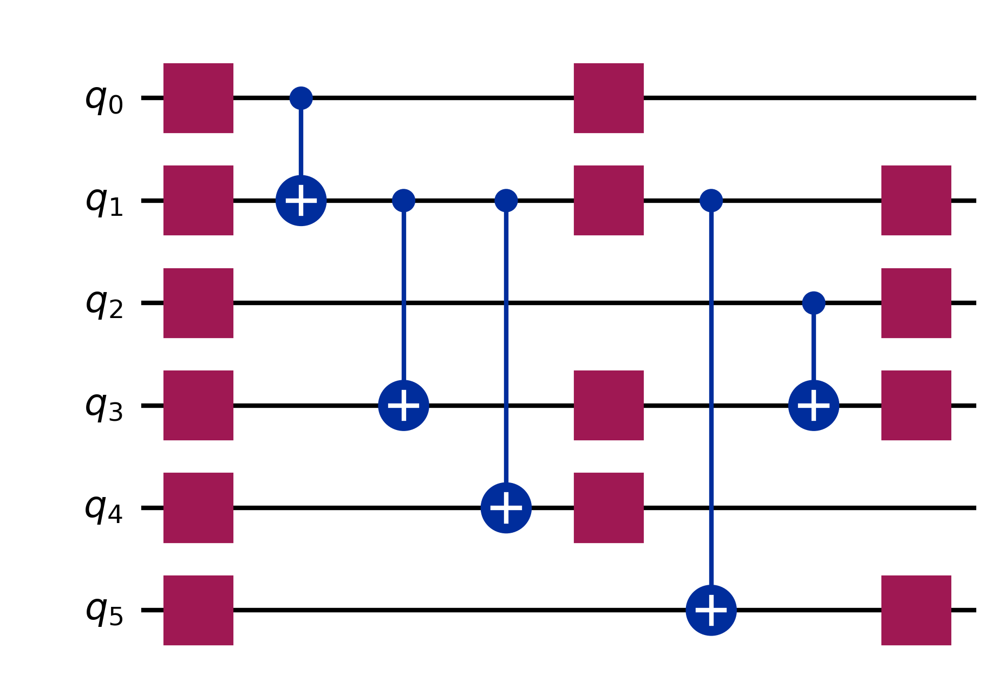

In [107]:
%autoreload
from lib.greedy_circs import build_circuit_ent

reps = 2
gates = arhcl_greedyent_const_circs_64[1][:5]
print(gates)
ansatz_options = {
    'num_qubits': 6,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

13


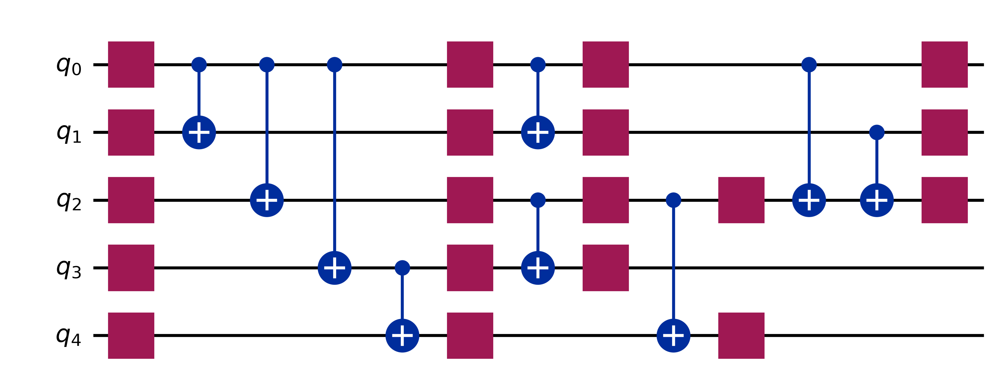

In [108]:
reps = 4
gates = arhcl_greedyent_const_circs[3][:9]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

13


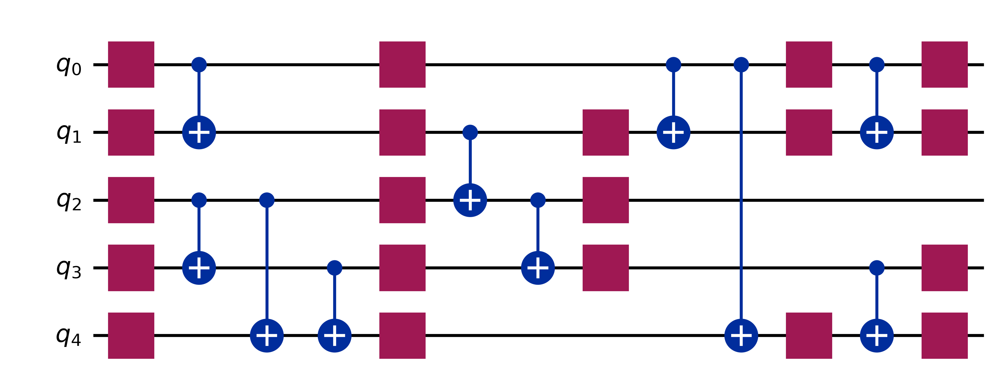

In [109]:
reps = 4
gates = arhcl_greedyent_const_circs_64[3][:12]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

4


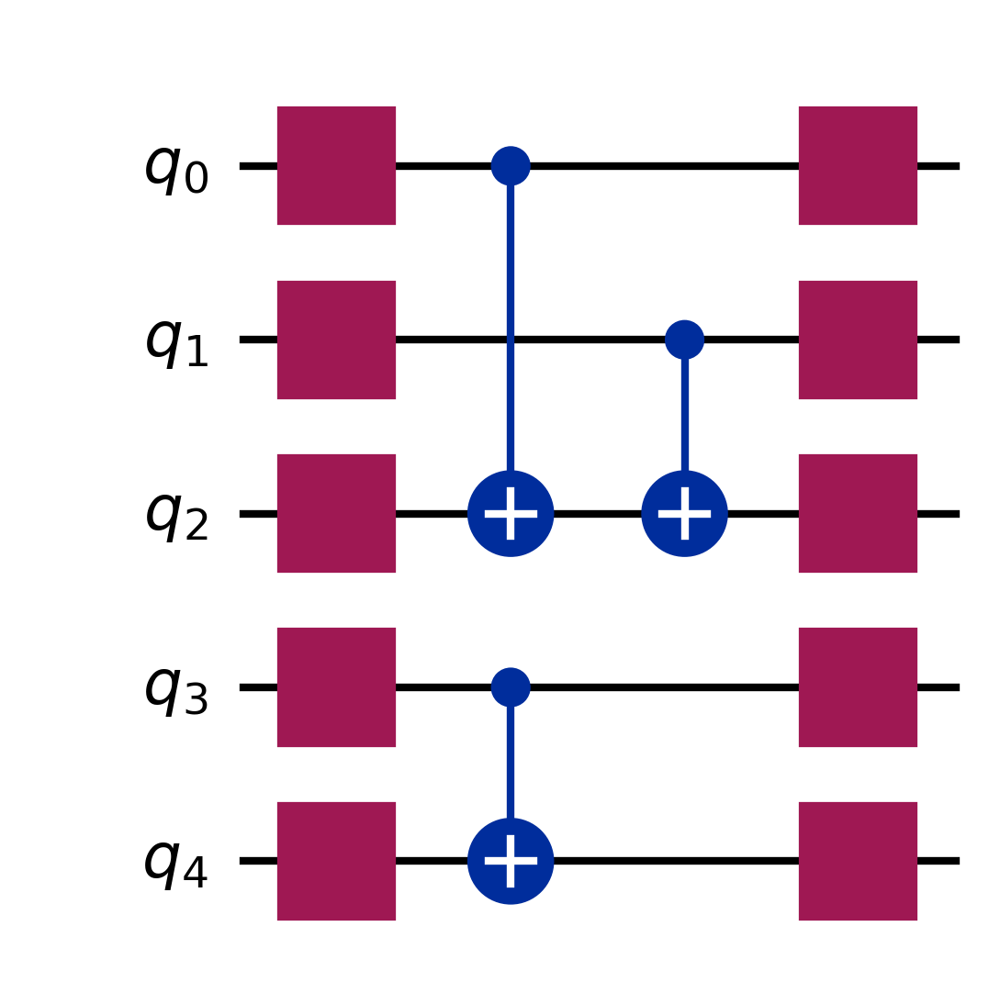

In [110]:
reps = 1
gates = mgnh_greedyent_const_circs[0][:3]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

13


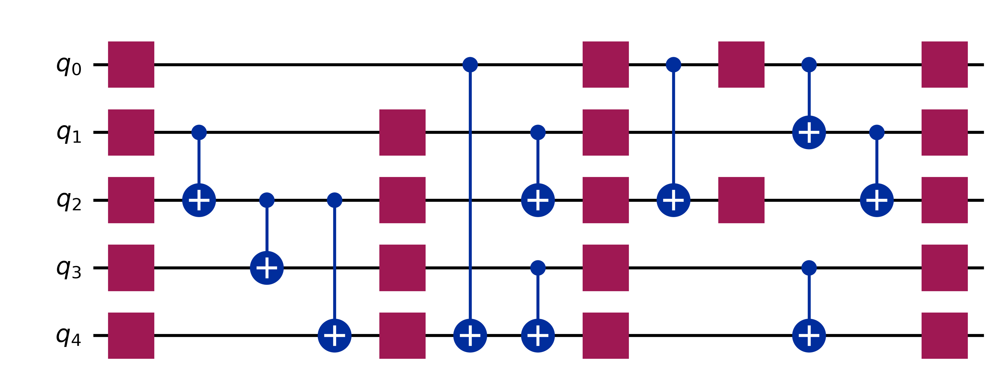

In [111]:
reps = 4
gates = mgnh_greedyent_const_circs[3][:10]
ansatz_options = {
    'num_qubits': 5,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

8


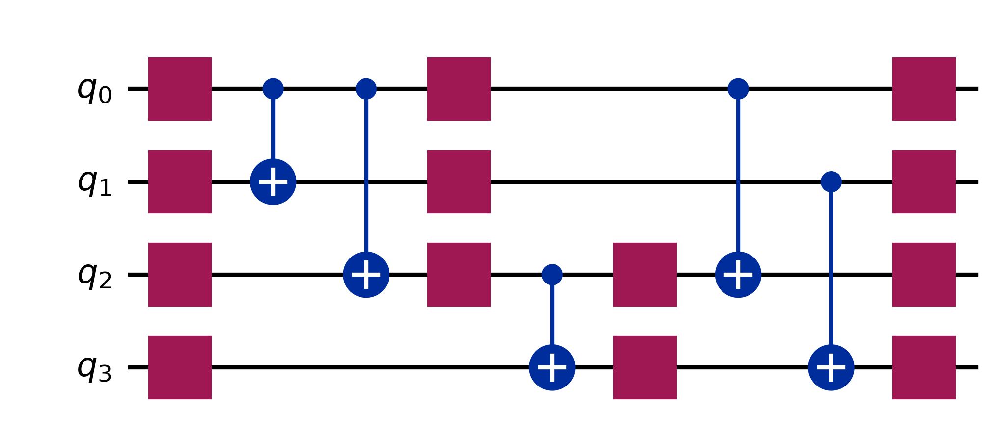

In [134]:
reps = 3
gates = cr2_1_greedyent_const_circs[2][:5]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

8


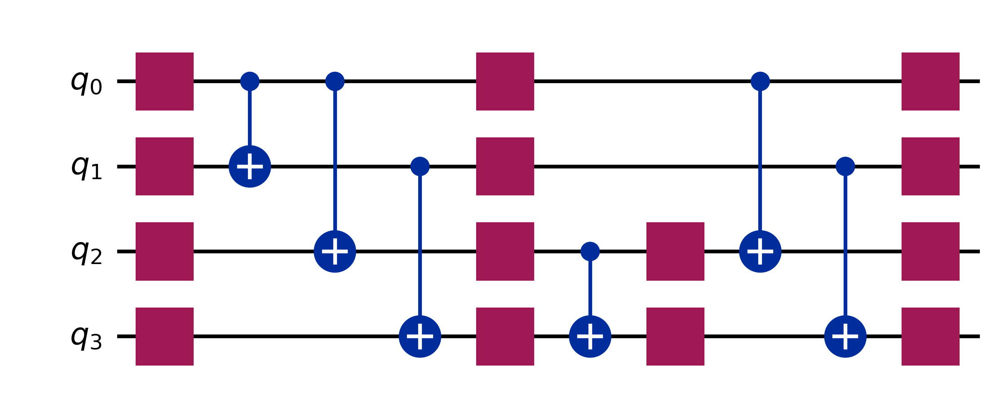

In [135]:
reps = 3
gates = cr2_1_greedyent_const_circs[2][:6]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

7


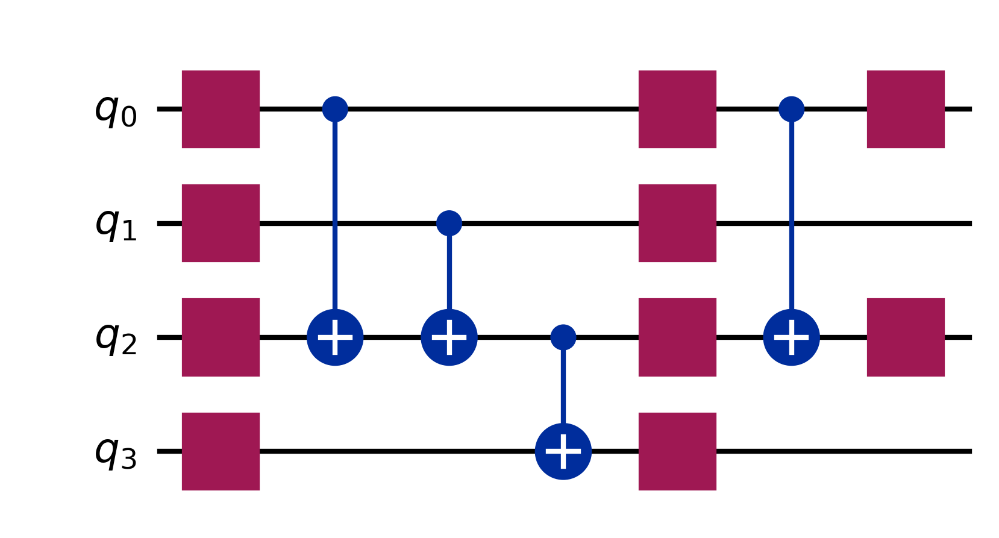

In [137]:
reps = 2
gates = cr2_3_greedyent_const_circs[1][:4]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

10


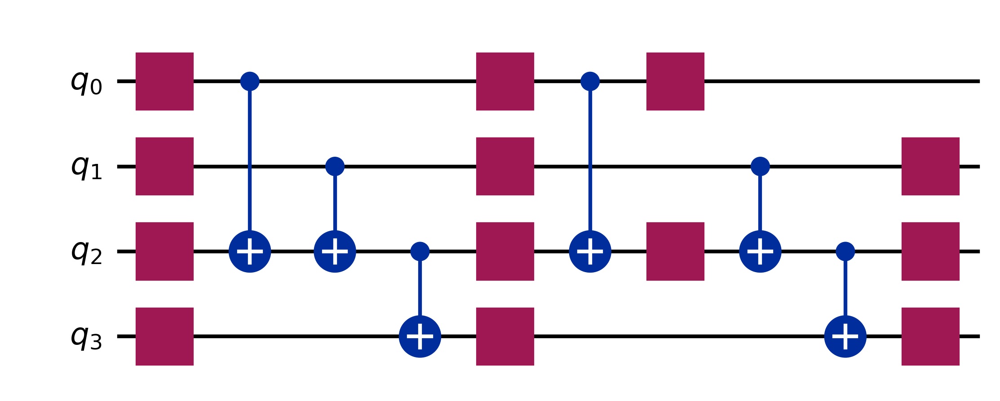

In [141]:
reps = 3
gates = cr2_3_greedyent_const_circs[2][:6]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

4


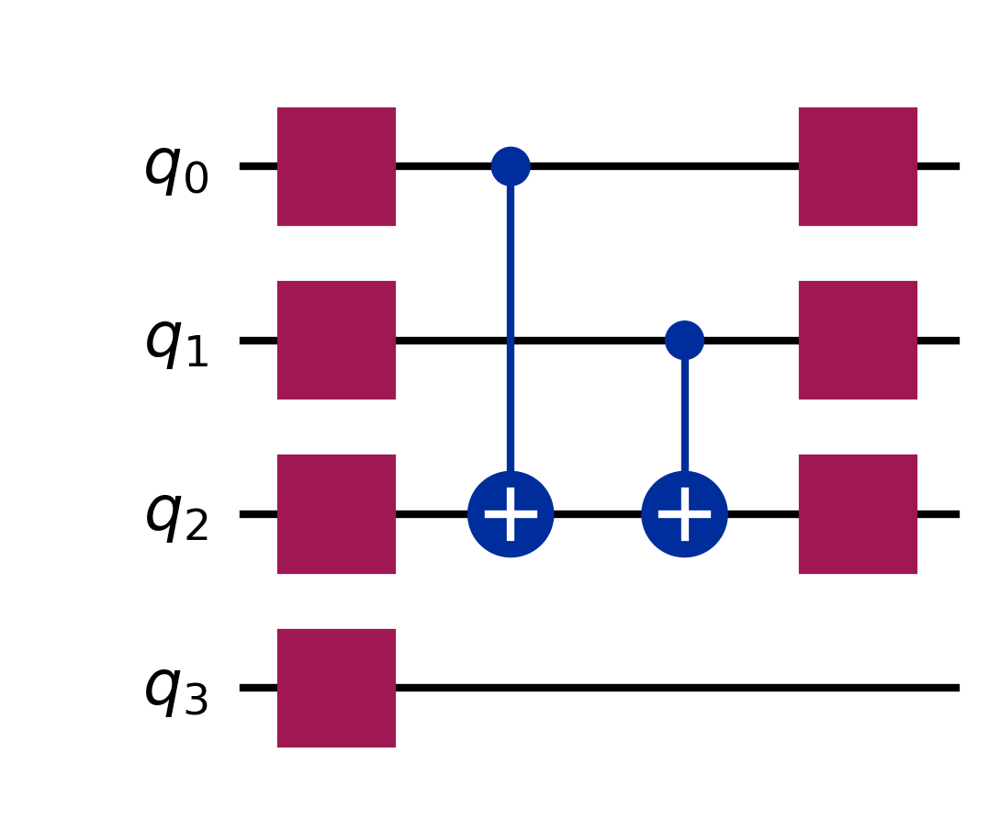

In [142]:
reps = 1
gates = cr2_5_greedyent_const_circs[0][:2]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

6


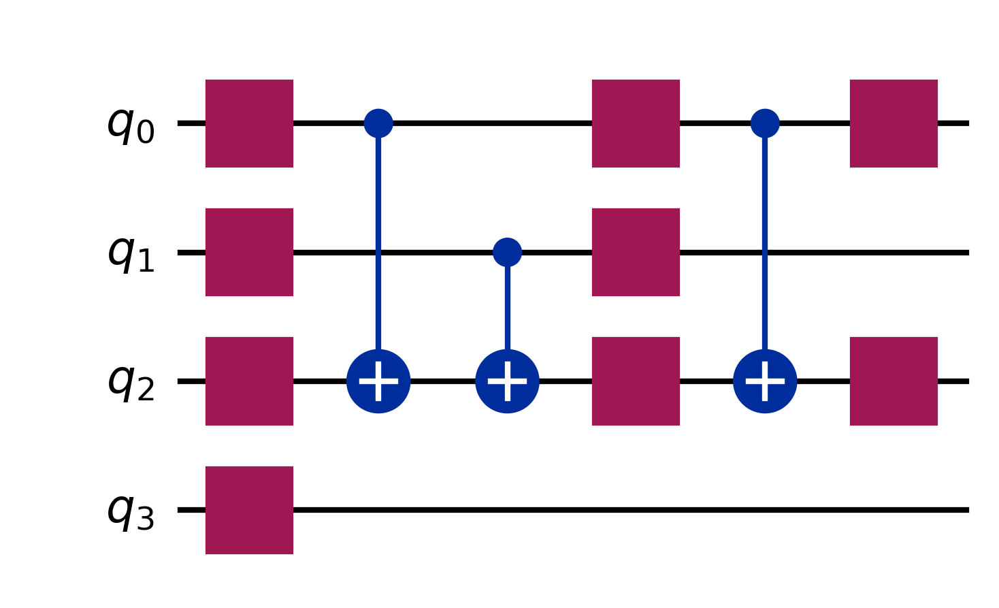

In [144]:
reps = 2
gates = cr2_5_greedyent_const_circs[1][:3]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

6


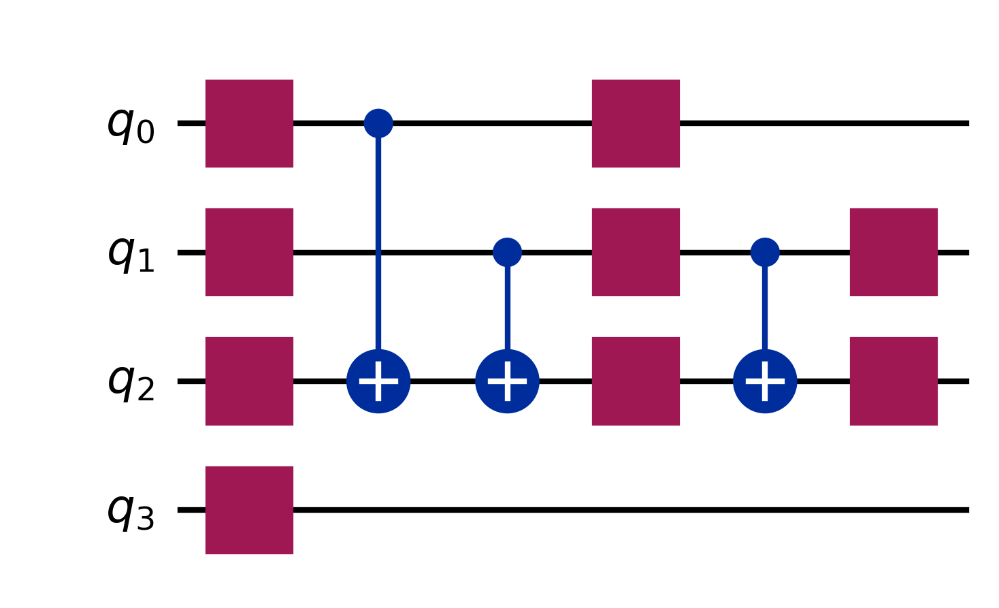

In [145]:
reps = 2
gates = cr2_7_greedyent_const_circs[1][:3]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

6


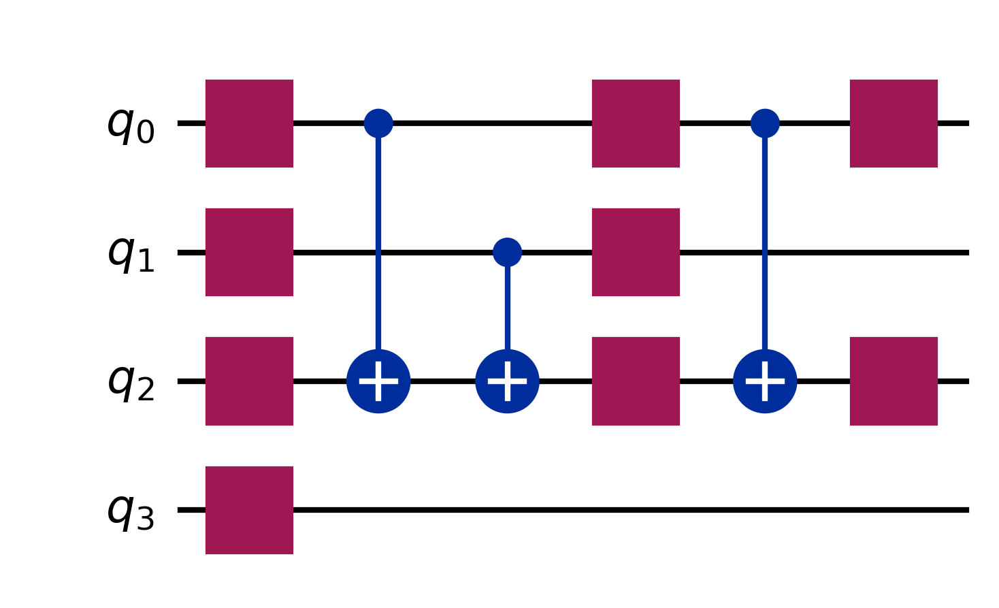

In [146]:
reps = 2
gates = cr2_9_greedyent_const_circs[1][:3]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

4


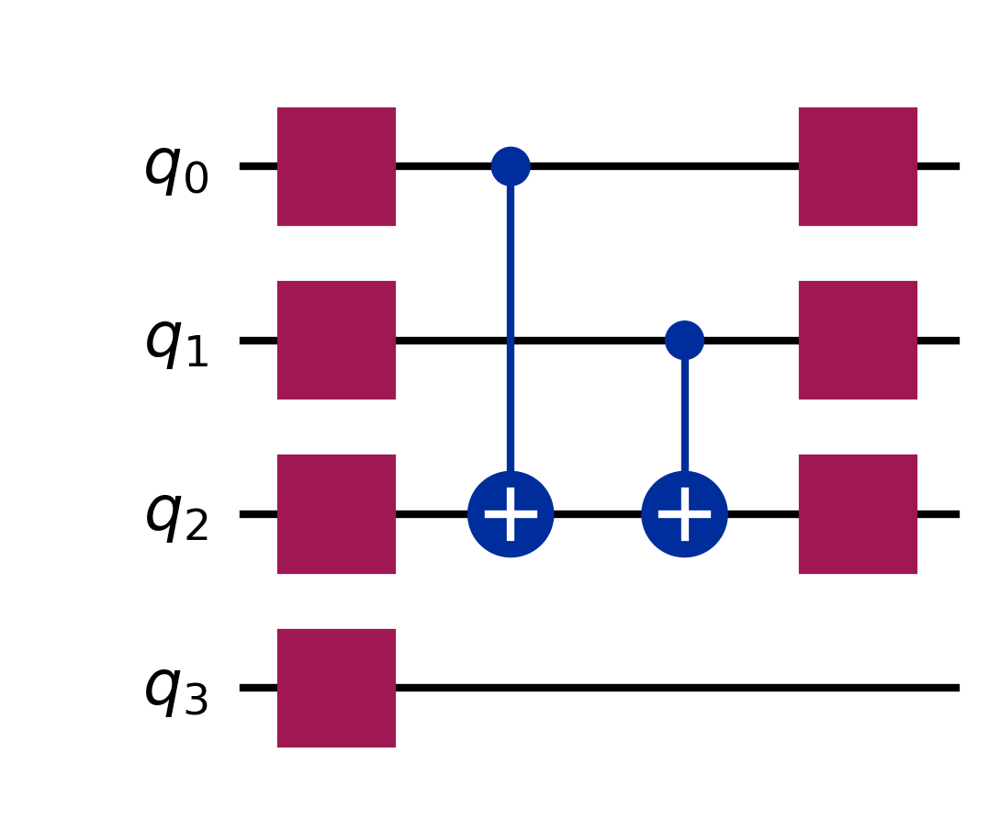

In [147]:
reps = 1
gates = cr2_11_greedyent_const_circs[0][:2]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

6


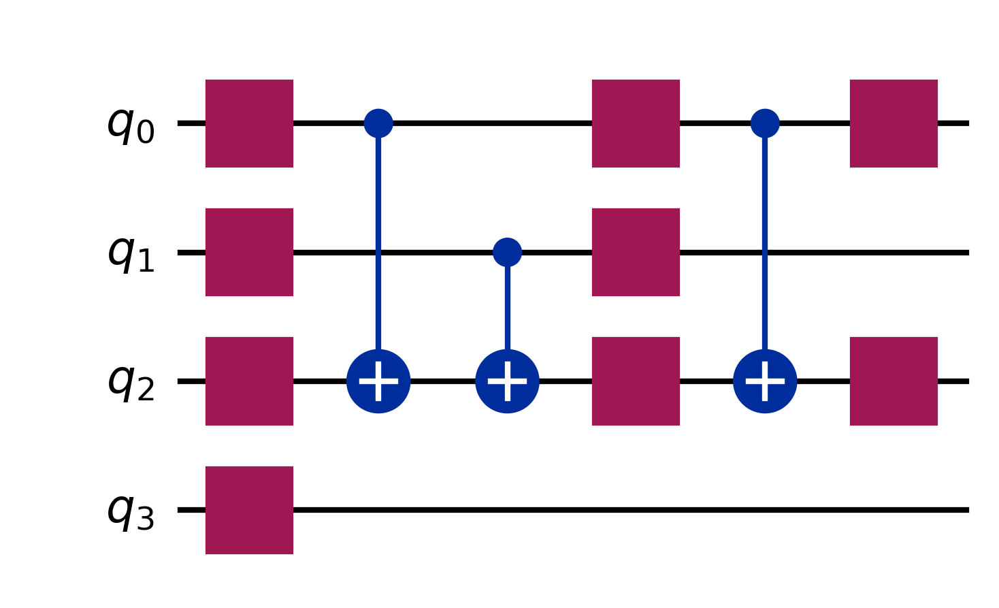

In [148]:
reps = 2
gates = cr2_11_greedyent_const_circs[1][:3]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

6


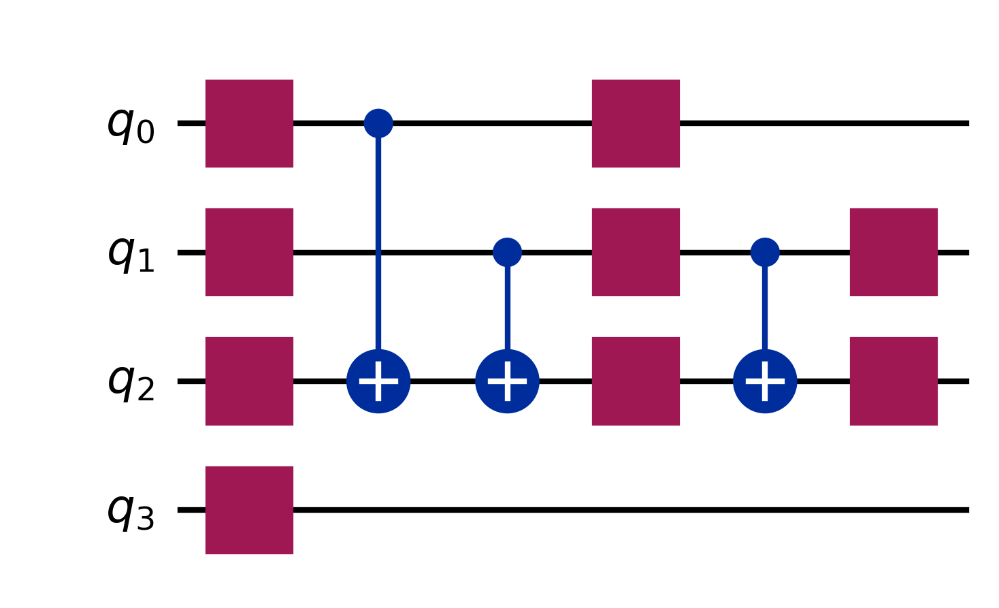

In [149]:
reps = 2
gates = cr2_13_greedyent_const_circs[1][:3]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)

7


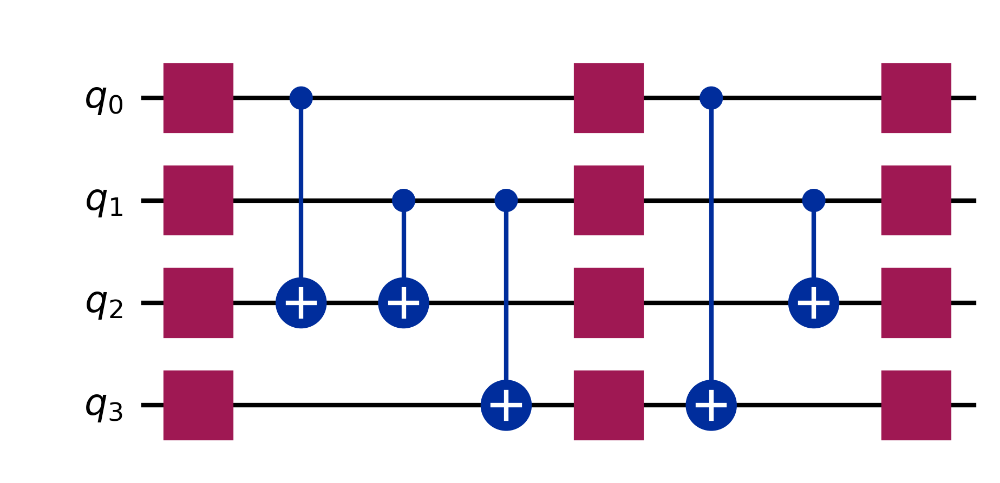

In [150]:
reps = 2
gates = cr2_13_greedyent_const_circs[1][:5]
ansatz_options = {
    'num_qubits': 4,
    'reps': reps,
    'constructive': True
}
ansatz = build_circuit_ent(ansatz_options, gates, simplify=True)
print(ansatz.depth())
ansatz.draw(output='mpl', plot_barriers=False, style=my_gate_names)